In [ ]:
#---Librerias para graficar (OPCIONAL)
#!pip install visualkeras
#!pip install pydot
#!pip install pydotplus
#!pip install graphviz
#apt-get install graphviz
#conda install graphviz

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 989 kB 7.3 MB/s 


# Importar librerias

In [1]:
import tensorflow as tf
from sklearn.metrics import accuracy_score, precision_score, recall_score
from sklearn.model_selection import train_test_split
from tensorflow.keras import layers, losses
from tensorflow.keras.models import Model
#from tensorflow.keras import regularizers
#import visualkeras
import matplotlib.pyplot as plt
import numpy as np
import cv2
import os
from datetime import datetime
from joblib import Parallel, delayed
import gc
import matplotlib.patches as patches

# Montar carpeta de imágenes en Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
#ir a la carpeta de datos
%cd /content/drive/MyDrive/rodiucan/datosimg
#Lugar donde se guardan los modelos
directorio_salida='/content/drive/MyDrive/rodiucan/salida/'

# Montar carpeta de imágenes en disco local

In [ ]:
#ir a la carpeta de datos
%cd d:/rodiucan/datosimg
#Lugar donde se guardan los modelos
directorio_salida='d:/rodiucan/salida/'

# Funciones

In [3]:
#from libreria import *

In [3]:
#-----------------------VARIABLES GLOBALES--------------------
TAM_PARCHE=128
TAM_PARCHE_MITAD=64
#-----------------------FUNCION PARA OBTENER EL NOMBRE DE ARCHIVO SEGUN SU NUMERO
#Esta funcion debe cambiarse en caso de usar otro dataset de imagenes
def getNombreArchivo(num):
    #rellenar con ceros a la izquierda
    cad=str(num).rjust(3,'0')
    return 'im_'+cad
#-----------------------------------------------------------------------------------------------------------

#---------------------------FUNCION DE AUMENTO DE DATOS, reflejo horizontal y vertical
def aumentar_datos(xposini,xposfin,xcarpeta_img_original,xcarpeta_img):
    xini=xposfin
    for i in range(xposini,xposfin):
        img = cv2.imread(xcarpeta_img_original+'/'+getNombreArchivo(i)+'.png')
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+'.png',img)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(xini)+'.png',cv2.flip(img,0))
        xini=xini+1
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(xini)+'.png',cv2.flip(img,1))
        xini=xini+1

#---------------------------FUNCION INICIAL DE PROCESAMIENTO DE IMAGENES
#Procesa las imagenes originales, convirtiendolas a color y en grises escaladas un multiplo de TAM_PARCHE,
#y construyendo las imagenes reducidas un factor de 2x, 4x y 6x. Y tambien aplicando filtro desenfoque.
#def procesar_imagenes(xposini,xposfin,xcarpeta_img_original,xcarpeta_img,xnom_img1,xnom_img1color,xnom_img2,xnom_img2color,xnom_img3,xnom_img3color,xnom_img4,xnom_img4color,xnom_img5,xnom_img5color,xnom_img7,xnom_img7color,xnom_img8,xnom_img8color,xnom_img9,xnom_img9color,xnom_img6,xnom_img6color):
#def procesar_imagenes(xposini,xposfin,xcarpeta_img_original,xcarpeta_img,xnom_img1,xnom_img1color,xnom_img2,xnom_img2color,xnom_img3,xnom_img3color,xnom_img4,xnom_img4color,xnom_img5,xnom_img5color,xnom_img7,xnom_img7color,xnom_img8,xnom_img8color,xnom_img9,xnom_img9color):
def procesar_imagenes(xposini,xposfin,xcarpeta_img_original,xcarpeta_img,xnom_img1,xnom_img1color,xnom_img2,xnom_img2color,xnom_img3,xnom_img3color,xnom_img4,xnom_img4color,xnom_img5,xnom_img5color):
    for i in range(xposini,xposfin):
        img = cv2.imread(xcarpeta_img_original+'/'+getNombreArchivo(i)+'.png')
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        #Redimensionar a multiplo TAM_PARCHExTAM_PARCHE
        tamsegy=int(img.shape[0]/TAM_PARCHE)+1
        tamsegx=int(img.shape[1]/TAM_PARCHE)+1
        nuevoy=tamsegy*TAM_PARCHE
        nuevox=tamsegx*TAM_PARCHE
        img2 = cv2.resize(img, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_CUBIC)
        #Convertir a grises y guardar
        r,g,b=img2[:,:,0],img2[:,:,1],img2[:,:,2]
        egrises=0.2989*r+0.5870*g+0.1140*b
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img1+'.png',egrises,cmap='gray')
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img1color+'.png',img2)

        #----------Reducir a la mitad 2x y reescalada a 2x
        img3 = cv2.resize(egrises, dsize=(int(nuevox/2),int(nuevoy/2)), interpolation=cv2.INTER_CUBIC)
        img4 = cv2.resize(img3, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_CUBIC)
        img3nearest = cv2.resize(egrises, dsize=(int(nuevox/2),int(nuevoy/2)), interpolation=cv2.INTER_NEAREST)
        img4nearest = cv2.resize(img3nearest, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_NEAREST)
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img2+'r2.png',img3,cmap='gray')
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img2+'.png',img4,cmap='gray')
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img2+'nearest.png',img4nearest,cmap='gray')
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img2+'nearestblur.png',cv2.blur(img4nearest,(5,5)),cmap='gray')
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img7+'.png',cv2.blur(img4,(5,5)),cmap='gray')
        img3 = cv2.resize(img2, dsize=(int(nuevox/2),int(nuevoy/2)), interpolation=cv2.INTER_CUBIC)
        img4 = cv2.resize(img3, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_CUBIC)
        img3nearest = cv2.resize(img2, dsize=(int(nuevox/2),int(nuevoy/2)), interpolation=cv2.INTER_NEAREST)
        img4nearest = cv2.resize(img3nearest, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_NEAREST)
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img2color+'r2.png',img3)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img2color+'.png',img4)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img2color+'nearest.png',img4nearest)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img2color+'nearestblur.png',cv2.blur(img4nearest,(5,5)))
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img7color+'.png',cv2.blur(img4,(5,5)))


        #----------Reducir a la cuarta 4x y reescalada a 4x
        img5 = cv2.resize(egrises, dsize=(int(nuevox/4),int(nuevoy/4)), interpolation=cv2.INTER_CUBIC)
        img6 = cv2.resize(img5, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_CUBIC)
        img5nearest = cv2.resize(egrises, dsize=(int(nuevox/4),int(nuevoy/4)), interpolation=cv2.INTER_NEAREST)
        img6nearest = cv2.resize(img5nearest, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_NEAREST)
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img3+'r4.png',img5,cmap='gray')
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img3+'.png',img6,cmap='gray')
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img3+'nearest.png',img6nearest,cmap='gray')
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img3+'nearestblur.png',cv2.blur(img6nearest,(5,5)),cmap='gray')
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img8+'.png',cv2.blur(img6,(5,5)),cmap='gray')
        img5 = cv2.resize(img2, dsize=(int(nuevox/4),int(nuevoy/4)), interpolation=cv2.INTER_CUBIC)
        img6 = cv2.resize(img5, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_CUBIC)
        img5nearest = cv2.resize(img2, dsize=(int(nuevox/4),int(nuevoy/4)), interpolation=cv2.INTER_NEAREST)
        img6nearest = cv2.resize(img5nearest, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_NEAREST)
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img3color+'r4.png',img5)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img3color+'.png',img6)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img3color+'nearest.png',img6nearest)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img3color+'nearestblur.png',cv2.blur(img6nearest,(5,5)))
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img8color+'.png',cv2.blur(img6,(5,5)))

        #----------Reducir a la sexta 6x y reescalada a 6x
        img7 = cv2.resize(egrises, dsize=(int(nuevox/6),int(nuevoy/6)), interpolation=cv2.INTER_CUBIC)
        img8 = cv2.resize(img7, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_CUBIC)
        img7nearest = cv2.resize(egrises, dsize=(int(nuevox/6),int(nuevoy/6)), interpolation=cv2.INTER_NEAREST)
        img8nearest = cv2.resize(img7nearest, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_NEAREST)
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img4+'r6.png',img7,cmap='gray')
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img4+'.png',img8,cmap='gray')
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img4+'nearest.png',img8nearest,cmap='gray')
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img4+'nearestblur.png',cv2.blur(img8nearest,(5,5)),cmap='gray')
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img9+'.png',cv2.blur(img8,(5,5)),cmap='gray')
        img7 = cv2.resize(img2, dsize=(int(nuevox/6),int(nuevoy/6)), interpolation=cv2.INTER_CUBIC)
        img8 = cv2.resize(img7, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_CUBIC)
        img7nearest = cv2.resize(img2, dsize=(int(nuevox/6),int(nuevoy/6)), interpolation=cv2.INTER_NEAREST)
        img8nearest = cv2.resize(img7nearest, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_NEAREST)
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img4color+'r6.png',img7)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img4color+'.png',img8)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img4color+'nearest.png',img8nearest)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img4color+'nearestblur.png',cv2.blur(img8nearest,(5,5)))
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img9color+'.png',cv2.blur(img8,(5,5)))

        #----------Desenfoque-----------
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img5+'.png',cv2.blur(egrises,(5,5)),cmap='gray')
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img5color+'.png',cv2.blur(img2,(5,5)))

        #----------Ruido gaussiano
        #gs_img1 = skimage.io.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        #gs_img1_ruido = skimage.util.random_noise(gs_img1, mode='gaussian', var=0.003)
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img6+'.png',gs_img1_ruido,cmap='gray')

        #gs_img1 = skimage.io.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img1color+'.png')
        #gs_img1_ruido = skimage.util.random_noise(gs_img1, mode='gaussian', var=0.003)
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img6color+'.png',gs_img1_ruido)


#---------------------------FUNCIONES PARA EL AUTOMATA CELULAR
VG_VIVO=0
VG_MUERTO=255

def aleatorio(minimo,maximo):
    return round((np.random.rand()*(maximo-minimo))+minimo)

def contarVecinasSimilares(matAB,nfilas,ncolumnas,i,j,umbral):
    i=i+1
    j=j+1
    cont=0
    umin=matAB[i,j]-umbral
    umax=matAB[i,j]+umbral
    if((matAB[i-1,j-1]>=umin) and (matAB[i-1,j-1]<=umax)):
        cont=cont+1
    if((matAB[i-1,j]>=umin) and (matAB[i-1,j]<=umax)):
        cont=cont+1
    if((matAB[i-1,j+1]>=umin) and (matAB[i-1,j+1]<=umax)):
        cont=cont+1
    if((matAB[i+1,j-1]>=umin) and (matAB[i+1,j-1]<=umax)):
        cont=cont+1
    if((matAB[i+1,j]>=umin) and (matAB[i+1,j]<=umax)):
        cont=cont+1
    if((matAB[i+1,j+1]>=umin) and (matAB[i+1,j+1]<=umax)):
        cont=cont+1
    if((matAB[i,j-1]>=umin) and (matAB[i,j-1]<=umax)):
        cont=cont+1
    if((matAB[i,j+1]>=umin) and (matAB[i,j+1]<=umax)):
        cont=cont+1
    return cont

def contarVecinasVivas(matAB,nfilas,ncolumnas,i,j):
    i=i+1
    j=j+1
    cont=0
    if(matAB[i-1,j-1]==VG_VIVO):
        cont=cont+1
    if(matAB[i-1,j]==VG_VIVO):
        cont=cont+1
    if(matAB[i-1,j+1]==VG_VIVO):
        cont=cont+1
    if(matAB[i+1,j-1]==VG_VIVO):
        cont=cont+1
    if(matAB[i+1,j]==VG_VIVO):
        cont=cont+1
    if(matAB[i+1,j+1]==VG_VIVO):
        cont=cont+1
    if(matAB[i,j-1]==VG_VIVO):
        cont=cont+1
    if(matAB[i,j+1]==VG_VIVO):
        cont=cont+1
    return cont

#Version 6var: Aplica el autómata.Inicializando la (matrizA) con un estructura inicial de rejilla uniforme
#y con un umbral de distancia de intensidad de 3
def aplicar_automata6var(xposini,xposfin,xcarpeta_img,xnom_img,xcarpeta_mapimg,xnom_mapimg,xcarpeta_secuenciaimg,xnom_secimg,maxsec):
    for i in range(xposini,xposfin):
        egrises = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
        egrises = cv2.cvtColor(egrises, cv2.COLOR_BGR2GRAY)

        original_nuevoy=int(egrises.shape[0])
        original_nuevox=int(egrises.shape[1])
        egrises = cv2.resize(egrises, dsize=(original_nuevox*2,original_nuevoy*2), interpolation=cv2.INTER_CUBIC)

        nuevoy=int(egrises.shape[0])
        nuevox=int(egrises.shape[1])
        #automata crear estructuras
        matrizI=np.copy(egrises)
        matrizA=np.copy(egrises)
        for y in range(0,nuevoy):
            for x in range(0,nuevox):
                #matrizA[y,x]=aleatorio(0,1)
                if y % 2 == 0 or x % 2 == 0:
                    matrizA[y,x]=1*255
                else:
                    matrizA[y,x]=0*255
        matrizI_AB=ampliarBordesImagen(matrizI, 1)
        #automata iterar maxsec veces
        for ra in range(0,maxsec):
            plt.imsave(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_'+str(ra)+'.png',matrizA,cmap='gray',vmin=0, vmax=255)
            cop_matrizA=np.copy(matrizA)
            matrizA_AB=ampliarBordesImagen(matrizA, 1)
            for y in range(0,nuevoy):
                for x in range(0,nuevox):
                    numsimilares=contarVecinasSimilares(matrizI_AB,nuevoy,nuevox,y,x,3)
                    numvivas=contarVecinasVivas(matrizA_AB,nuevoy,nuevox,y,x)+numsimilares
                    if(matrizA[y,x]==VG_VIVO):
                        if numvivas<2:
                            if numsimilares>3:
                                cop_matrizA[y,x]=VG_MUERTO
                        else:
                            if(numvivas==2 or numvivas==3):
                                pass
                            else:
                                if numsimilares>3:
                                    cop_matrizA[y,x]=VG_MUERTO
                    else:
                        if numvivas==3:
                            if numsimilares<=3:
                                cop_matrizA[y,x]=VG_VIVO
            matrizA=np.copy(cop_matrizA)
        #guardar mapa
        #matrizA = cv2.resize(matrizA, dsize=(original_nuevox,original_nuevoy), interpolation=cv2.INTER_CUBIC)
        plt.imsave(xcarpeta_mapimg+'/'+getNombreArchivo(i)+xnom_mapimg+'.png',matrizA,cmap='gray',vmin=0, vmax=255)

def aplicar_automata6var_inverso(xposini,xposfin,xcarpeta_img,xnom_img,xcarpeta_mapimg,xnom_mapimg,xcarpeta_secuenciaimg,xnom_secimg,maxsec):
    for i in range(xposini,xposfin):
        egrises = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
        egrises = cv2.cvtColor(egrises, cv2.COLOR_BGR2GRAY)

        original_nuevoy=int(egrises.shape[0])
        original_nuevox=int(egrises.shape[1])
        egrises = cv2.resize(egrises, dsize=(original_nuevox*2,original_nuevoy*2), interpolation=cv2.INTER_CUBIC)

        nuevoy=int(egrises.shape[0])
        nuevox=int(egrises.shape[1])
        #automata crear estructuras
        matrizI=np.copy(egrises)
        matrizA=np.copy(egrises)
        for y in range(0,nuevoy):
            for x in range(0,nuevox):
                #matrizA[y,x]=aleatorio(0,1)
                if y % 2 == 0 or x % 2 == 0:
                    matrizA[y,x]=1*255
                else:
                    matrizA[y,x]=0*255
        matrizI_AB=ampliarBordesImagen(matrizI, 1)
        #automata iterar maxsec veces
        for ra in range(0,maxsec):
            plt.imsave(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_'+str(ra)+'.png',matrizA,cmap='gray',vmin=0, vmax=255)
            cop_matrizA=np.copy(matrizA)
            matrizA_AB=ampliarBordesImagen(matrizA, 1)
            for y in range(0,nuevoy):
                for x in range(0,nuevox):
                    numsimilares=8-contarVecinasSimilares(matrizI_AB,nuevoy,nuevox,y,x,3)
                    numvivas=contarVecinasVivas(matrizA_AB,nuevoy,nuevox,y,x)+numsimilares
                    if(matrizA[y,x]==VG_VIVO):
                        if numvivas<2:
                            if numsimilares>3:
                                cop_matrizA[y,x]=VG_MUERTO
                        else:
                            if(numvivas==2 or numvivas==3):
                                pass
                            else:
                                if numsimilares>3:
                                    cop_matrizA[y,x]=VG_MUERTO
                    else:
                        if numvivas==3:
                            if numsimilares<=3:
                                cop_matrizA[y,x]=VG_VIVO
            matrizA=np.copy(cop_matrizA)
        #guardar mapa
        #matrizA = cv2.resize(matrizA, dsize=(original_nuevox,original_nuevoy), interpolation=cv2.INTER_CUBIC)
        plt.imsave(xcarpeta_mapimg+'/'+getNombreArchivo(i)+xnom_mapimg+'.png',matrizA,cmap='gray',vmin=0, vmax=255)

def combinar_automata6var(xposini,xposfin,xcarpeta_mapimg,xnom_mapimg,xcarpeta_mapimg_inv,xnom_mapimg_inv,xcarpeta_mapimg_comb,xnom_mapimg_comb):
    for i in range(xposini,xposfin):
        #egrises = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
        #egrises = cv2.cvtColor(egrises, cv2.COLOR_BGR2GRAY)

        xmapa=cv2.imread(xcarpeta_mapimg+'/'+getNombreArchivo(i)+xnom_mapimg+'.png')
        xmapa=cv2.cvtColor(xmapa, cv2.COLOR_BGR2GRAY)

        nuevoy=int(xmapa.shape[0])
        nuevox=int(xmapa.shape[1])

        xmapa_inv=cv2.imread(xcarpeta_mapimg_inv+'/'+getNombreArchivo(i)+xnom_mapimg_inv+'.png')
        xmapa_inv=cv2.cvtColor(xmapa_inv, cv2.COLOR_BGR2GRAY)

        #automata crear estructuras
        #matrizI=np.copy(egrises)
        matrizA=np.copy(xmapa)
        #matrizA2=np.copy(xmapa)
        #matrizB=np.copy(xmapa)
        #matrizC=np.copy(xmapa_inv)

        matrizB_AB=ampliarBordesImagen(xmapa, 1)
        matrizC_AB=ampliarBordesImagen(xmapa_inv, 1)

        for y in range(0,nuevoy):
            for x in range(0,nuevox):
                numvivasB=contarVecinasVivas(matrizB_AB,nuevoy,nuevox,y,x)
                numvivasC=contarVecinasVivas(matrizC_AB,nuevoy,nuevox,y,x)
                factorB=numvivasB/8
                factorC=numvivasC/8
                rango=((factorC-factorB)+1)/2
                #num=rango*255
                #decimales=num-round(num)
                #rango2=((decimales*1000))/999
                matrizA[y,x]=int(rango*255)
                #setValor(matrizA2,nuevoy,nuevox,y,x,int(rango2*255))

        #Difuminar los puntos NO ayuda en nada
        #matrizA=ampliarBordesImagen(matrizA, 1)
        #for y in range(1,nuevoy+1):
        #    for x in range(1,nuevox+1):
        #        matrizA[y,x]=int((((matrizA[y,x]/255)+(matrizA[y+1,x]/255)+(matrizA[y,x+1]/255)+(matrizA[y+1,x+1]/255))/4)*255)
        #matrizA=recortarBordesImagen(matrizA, 1)

        #plt.imsave(xcarpeta_mapimg_comb+'/'+getNombreArchivo(i)+xnom_mapimg_comb+'_D.png',matrizA2,cmap='gray',vmin=0, vmax=255)
        #matrizA=cv2.blur(matrizA,(2,2))
        matrizA = cv2.resize(matrizA, dsize=(int(nuevox/2),int(nuevoy/2)), interpolation=cv2.INTER_CUBIC)

        plt.imsave(xcarpeta_mapimg_comb+'/'+getNombreArchivo(i)+xnom_mapimg_comb+'.png',matrizA,cmap='gray',vmin=0, vmax=255)

def mostrar_imagen_secuencia_ac(xposini,xposfin,xcarpeta_secuenciaimg,xnom_secimg,maxsec):
    for i in range(xposini,xposfin):
        tablagsec=plt.figure(figsize=(15, 15))
        for ra in range(0,maxsec):
            xmapa=cv2.imread(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_'+str(ra)+'.png')
            xmapa=cv2.cvtColor(xmapa, cv2.COLOR_BGR2GRAY)
            c1=tablagsec.add_subplot(1,maxsec,ra+1)
            plt.title(getNombreArchivo(i)+xnom_secimg+'_'+str(ra)+'.png')
            plt.imshow(xmapa,cmap='gray',vmin=0, vmax=255)
#-----------------------------------------------------------------------------------------------------------


#-------------PARA APLICAR AUTOMATAS A IMAGENES A COLOR--------------
def aplicar_automata6varRGB(xposini,xposfin,xcarpeta_img,xnom_img,xcarpeta_mapimg,xnom_mapimg,xcarpeta_secuenciaimg,xnom_secimg,maxsec):
    for i in range(xposini,xposfin):
        ecolor = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
        ecolor = cv2.cvtColor(ecolor, cv2.COLOR_BGR2RGB)

        original_nuevoy=int(ecolor.shape[0])
        original_nuevox=int(ecolor.shape[1])
        ecolor = cv2.resize(ecolor, dsize=(original_nuevox*2,original_nuevoy*2), interpolation=cv2.INTER_CUBIC)

        matrizA_R = get_automata6varCanal(ecolor[:,:,0],i,xcarpeta_secuenciaimg,xnom_secimg+'_R',maxsec)
        matrizA_G = get_automata6varCanal(ecolor[:,:,1],i,xcarpeta_secuenciaimg,xnom_secimg+'_G',maxsec)
        matrizA_B = get_automata6varCanal(ecolor[:,:,2],i,xcarpeta_secuenciaimg,xnom_secimg+'_B',maxsec)
        for ra in range(0,maxsec):
            eR = cv2.imread(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_R'+'_'+str(ra)+'.png')
            eR = cv2.cvtColor(eR, cv2.COLOR_BGR2GRAY)
            eG = cv2.imread(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_G'+'_'+str(ra)+'.png')
            eG = cv2.cvtColor(eG, cv2.COLOR_BGR2GRAY)
            eB = cv2.imread(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_B'+'_'+str(ra)+'.png')
            eB = cv2.cvtColor(eB, cv2.COLOR_BGR2GRAY)
            xmapa=np.zeros((eR.shape[0],eR.shape[1],3))
            xmapa[:,:,0]=eR[:,:]
            xmapa[:,:,1]=eG[:,:]
            xmapa[:,:,2]=eB[:,:]
            ymapa=xmapa.astype(np.uint8)
            plt.imsave(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_'+str(ra)+'.png',ymapa)

        ximagen=np.zeros((ecolor.shape[0],ecolor.shape[1],3))
        ximagen[:,:,0]=matrizA_R[:,:]
        ximagen[:,:,1]=matrizA_G[:,:]
        ximagen[:,:,2]=matrizA_B[:,:]
        yimagen=ximagen.astype(np.uint8)

        #guardar mapa
        #matrizA = cv2.resize(matrizA, dsize=(original_nuevox,original_nuevoy), interpolation=cv2.INTER_CUBIC)
        #plt.imsave(xcarpeta_mapimg+'/'+getNombreArchivo(i)+xnom_mapimg+'.png',matrizA,cmap='gray',vmin=0, vmax=255)
        plt.imsave(xcarpeta_mapimg+'/'+getNombreArchivo(i)+xnom_mapimg+'.png',yimagen)

def get_automata6varCanal(ecanal,i,xcarpeta_secuenciaimg,xnom_secimg,maxsec):
    nuevoy=int(ecanal.shape[0])
    nuevox=int(ecanal.shape[1])
    matrizI=np.copy(ecanal)
    matrizA=np.copy(ecanal)
    for y in range(0,nuevoy):
        for x in range(0,nuevox):
            #matrizA[y,x]=aleatorio(0,1)
            if y % 2 == 0 or x % 2 == 0:
                matrizA[y,x]=1*255
            else:
                matrizA[y,x]=0*255
    matrizI_AB=ampliarBordesImagen(matrizI, 1)
    #automata iterar maxsec veces
    for ra in range(0,maxsec):
        plt.imsave(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_'+str(ra)+'.png',matrizA,cmap='gray',vmin=0, vmax=255)
        cop_matrizA=np.copy(matrizA)
        matrizA_AB=ampliarBordesImagen(matrizA, 1)
        for y in range(0,nuevoy):
            for x in range(0,nuevox):
                numsimilares=contarVecinasSimilares(matrizI_AB,nuevoy,nuevox,y,x,3)
                numvivas=contarVecinasVivas(matrizA_AB,nuevoy,nuevox,y,x)+numsimilares
                if(matrizA[y,x]==VG_VIVO):
                    if numvivas<2:
                        if numsimilares>3:
                            cop_matrizA[y,x]=VG_MUERTO
                    else:
                        if(numvivas==2 or numvivas==3):
                            pass
                        else:
                            if numsimilares>3:
                                cop_matrizA[y,x]=VG_MUERTO
                else:
                    if numvivas==3:
                        if numsimilares<=3:
                            cop_matrizA[y,x]=VG_VIVO
        matrizA=np.copy(cop_matrizA)
    return matrizA

def aplicar_automata6var_inversoRGB(xposini,xposfin,xcarpeta_img,xnom_img,xcarpeta_mapimg,xnom_mapimg,xcarpeta_secuenciaimg,xnom_secimg,maxsec):
    for i in range(xposini,xposfin):
        ecolor = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
        ecolor = cv2.cvtColor(ecolor, cv2.COLOR_BGR2RGB)

        original_nuevoy=int(ecolor.shape[0])
        original_nuevox=int(ecolor.shape[1])
        ecolor = cv2.resize(ecolor, dsize=(original_nuevox*2,original_nuevoy*2), interpolation=cv2.INTER_CUBIC)

        matrizA_R = get_automata6var_inversoCanal(ecolor[:,:,0],i,xcarpeta_secuenciaimg,xnom_secimg+'_R',maxsec)
        matrizA_G = get_automata6var_inversoCanal(ecolor[:,:,1],i,xcarpeta_secuenciaimg,xnom_secimg+'_G',maxsec)
        matrizA_B = get_automata6var_inversoCanal(ecolor[:,:,2],i,xcarpeta_secuenciaimg,xnom_secimg+'_B',maxsec)
        for ra in range(0,maxsec):
            eR = cv2.imread(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_R'+'_'+str(ra)+'.png')
            eR = cv2.cvtColor(eR, cv2.COLOR_BGR2GRAY)
            eG = cv2.imread(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_G'+'_'+str(ra)+'.png')
            eG = cv2.cvtColor(eG, cv2.COLOR_BGR2GRAY)
            eB = cv2.imread(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_B'+'_'+str(ra)+'.png')
            eB = cv2.cvtColor(eB, cv2.COLOR_BGR2GRAY)
            xmapa=np.zeros((eR.shape[0],eR.shape[1],3))
            xmapa[:,:,0]=eR[:,:]
            xmapa[:,:,1]=eG[:,:]
            xmapa[:,:,2]=eB[:,:]
            ymapa=xmapa.astype(np.uint8)
            plt.imsave(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_'+str(ra)+'.png',ymapa)

        ximagen=np.zeros((ecolor.shape[0],ecolor.shape[1],3))
        ximagen[:,:,0]=matrizA_R[:,:]
        ximagen[:,:,1]=matrizA_G[:,:]
        ximagen[:,:,2]=matrizA_B[:,:]
        yimagen=ximagen.astype(np.uint8)

        #guardar mapa
        #matrizA = cv2.resize(matrizA, dsize=(original_nuevox,original_nuevoy), interpolation=cv2.INTER_CUBIC)
        #plt.imsave(xcarpeta_mapimg+'/'+getNombreArchivo(i)+xnom_mapimg+'.png',matrizA,cmap='gray',vmin=0, vmax=255)
        plt.imsave(xcarpeta_mapimg+'/'+getNombreArchivo(i)+xnom_mapimg+'.png',yimagen)

def get_automata6var_inversoCanal(ecanal,i,xcarpeta_secuenciaimg,xnom_secimg,maxsec):
    nuevoy=int(ecanal.shape[0])
    nuevox=int(ecanal.shape[1])
    #automata crear estructuras
    matrizI=np.copy(ecanal)
    matrizA=np.copy(ecanal)
    for y in range(0,nuevoy):
        for x in range(0,nuevox):
            #matrizA[y,x]=aleatorio(0,1)
            if y % 2 == 0 or x % 2 == 0:
                matrizA[y,x]=1*255
            else:
                matrizA[y,x]=0*255
    matrizI_AB=ampliarBordesImagen(matrizI, 1)
    #automata iterar maxsec veces
    for ra in range(0,maxsec):
        plt.imsave(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_'+str(ra)+'.png',matrizA,cmap='gray',vmin=0, vmax=255)
        cop_matrizA=np.copy(matrizA)
        matrizA_AB=ampliarBordesImagen(matrizA, 1)
        for y in range(0,nuevoy):
            for x in range(0,nuevox):
                numsimilares=8-contarVecinasSimilares(matrizI_AB,nuevoy,nuevox,y,x,3)
                numvivas=contarVecinasVivas(matrizA_AB,nuevoy,nuevox,y,x)+numsimilares
                if(matrizA[y,x]==VG_VIVO):
                    if numvivas<2:
                        if numsimilares>3:
                            cop_matrizA[y,x]=VG_MUERTO
                    else:
                        if(numvivas==2 or numvivas==3):
                            pass
                        else:
                            if numsimilares>3:
                                cop_matrizA[y,x]=VG_MUERTO
                else:
                    if numvivas==3:
                        if numsimilares<=3:
                            cop_matrizA[y,x]=VG_VIVO
        matrizA=np.copy(cop_matrizA)
    return matrizA

def combinar_automata6varRGB(xposini,xposfin,xcarpeta_mapimg,xnom_mapimg,xcarpeta_mapimg_inv,xnom_mapimg_inv,xcarpeta_mapimg_comb,xnom_mapimg_comb):
    for i in range(xposini,xposfin):
        xmapa=cv2.imread(xcarpeta_mapimg+'/'+getNombreArchivo(i)+xnom_mapimg+'.png')
        xmapa=cv2.cvtColor(xmapa, cv2.COLOR_BGR2RGB)

        xmapa_inv=cv2.imread(xcarpeta_mapimg_inv+'/'+getNombreArchivo(i)+xnom_mapimg_inv+'.png')
        xmapa_inv=cv2.cvtColor(xmapa_inv, cv2.COLOR_BGR2RGB)

        matrizA_R = get_combinar_automata6varCanal(xmapa[:,:,0],xmapa_inv[:,:,0])
        matrizA_G = get_combinar_automata6varCanal(xmapa[:,:,1],xmapa_inv[:,:,1])
        matrizA_B = get_combinar_automata6varCanal(xmapa[:,:,2],xmapa_inv[:,:,2])

        ximagen=np.zeros((matrizA_R.shape[0],matrizA_R.shape[1],3))
        ximagen[:,:,0]=matrizA_R[:,:]
        ximagen[:,:,1]=matrizA_G[:,:]
        ximagen[:,:,2]=matrizA_B[:,:]
        yimagen=ximagen.astype(np.uint8)

        #plt.imsave(xcarpeta_mapimg_comb+'/'+getNombreArchivo(i)+xnom_mapimg_comb+'.png',matrizA,cmap='gray',vmin=0, vmax=255)
        plt.imsave(xcarpeta_mapimg_comb+'/'+getNombreArchivo(i)+xnom_mapimg_comb+'.png',yimagen)

def get_combinar_automata6varCanal(xmapa,xmapa_inv):
    nuevoy=int(xmapa.shape[0])
    nuevox=int(xmapa.shape[1])
    matrizA=np.copy(xmapa)
    matrizB_AB=ampliarBordesImagen(xmapa, 1)
    matrizC_AB=ampliarBordesImagen(xmapa_inv, 1)
    for y in range(0,nuevoy):
        for x in range(0,nuevox):
            numvivasB=contarVecinasVivas(matrizB_AB,nuevoy,nuevox,y,x)
            numvivasC=contarVecinasVivas(matrizC_AB,nuevoy,nuevox,y,x)
            factorB=numvivasB/8
            factorC=numvivasC/8
            rango=((factorC-factorB)+1)/2
            #num=rango*255
            #decimales=num-round(num)
            #rango2=((decimales*1000))/999
            matrizA[y,x]=int(rango*255)
    matrizA = cv2.resize(matrizA, dsize=(int(nuevox/2),int(nuevoy/2)), interpolation=cv2.INTER_CUBIC)
    return matrizA

def mostrar_imagen_secuencia_acRGB(xposini,xposfin,xcarpeta_secuenciaimg,xnom_secimg,maxsec):
    for i in range(xposini,xposfin):
        tablagsec=plt.figure(figsize=(15, 15))
        for ra in range(0,maxsec):
            xmapa=cv2.imread(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_'+str(ra)+'.png')
            xmapa=cv2.cvtColor(xmapa, cv2.COLOR_BGR2RGB)
            c1=tablagsec.add_subplot(1,maxsec,ra+1)
            plt.title(getNombreArchivo(i)+xnom_secimg+'_'+str(ra)+'.png')
            plt.imshow(xmapa)
#-----------------------------------------------------------------------------------------------------------




#-------------------------FUNCIONES VARIADAS DE ESTRUCTURAS DE DATOS--------------------------------------
#Unir img1 con img2 en una sola estructura de datos. Se usa para las entradas que reciben dos matrices unidas
#Ambas imagenes deben tener dimension (y,x,1)
#Combinar forma de (...,TAM_PARCHE,TAM_PARCHE,1) (...,TAM_PARCHE,TAM_PARCHE,1) a (...,TAM_PARCHE,TAM_PARCHE,2)
def unirDatosImagen(data_img1,data_img2):
    #tqdata=np.zeros((len(data_img1),TAM_PARCHE,TAM_PARCHE,2))
    #for k in range(0,len(data_img1)):
    #    for t in range(0,TAM_PARCHE):
    #        for j in range(0,TAM_PARCHE):
    #            tqdata[k,t,j,0]=data_img1[k,t,j]
    #            tqdata[k,t,j,1]=data_img2[k,t,j]
    #return tqdata
    return np.concatenate((data_img1,data_img2),-1)
#Combinar forma de (...,TAM_PARCHE,TAM_PARCHE,1) (...,TAM_PARCHE,TAM_PARCHE,1) (...,TAM_PARCHE,TAM_PARCHE,1) a (...,TAM_PARCHE,TAM_PARCHE,3)
def unirDatosImagen3(data_img1,data_img2,data_img3):
    #return unirDatosImagen(unirDatosImagen(data_img1,data_img2),data_img3)
    return np.concatenate((data_img1,data_img2,data_img3),-1)

#Construir conjunto de datos de parches para el ENTRENAMIENDO del modelo
#Dada una lista de pares de imagenes de baja y alta calidad construye los parches de TAM_PARCHExTAM_PARCHE pixeles
def construirConjuntoParches(xposini, xposfin, xcarpeta_img, xnom_img_lista):
    ancho=TAM_PARCHE
    alto=TAM_PARCHE
    xdata_img=[]
    for xnom_img in xnom_img_lista:
        #print(xnom_img)
        for i in range(xposini, xposfin):
            img = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
            img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            nseg_horiz=int(img.shape[1]/TAM_PARCHE)
            nseg_vert=int(img.shape[0]/TAM_PARCHE)
            for y in range(0,nseg_vert):
                for x in range(0,nseg_horiz):
                    xdata_img.append(np.copy(img[alto*y:alto*(y+1),ancho*x:ancho*(x+1)]))
    return xdata_img
#Hace lo mismo que la anterior funcion, pero para imagenes a color se debe especificar el num_canal_color que puede ser: 0,1,2
def construirConjuntoParchesColor(num_canal_color,xposini, xposfin, xcarpeta_img, xnom_img_lista):
    ancho=TAM_PARCHE
    alto=TAM_PARCHE
    xdata_img=[]
    for xnom_img in xnom_img_lista:
        #print(xnom_img)
        for i in range(xposini, xposfin):
            img2 = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
            img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)
            if(num_canal_color==0):
                img=img2[:,:,0]
            if(num_canal_color==1):
                img=img2[:,:,1]
            if(num_canal_color==2):
                img=img2[:,:,2]
            nseg_horiz=int(img.shape[1]/TAM_PARCHE)
            nseg_vert=int(img.shape[0]/TAM_PARCHE)
            for y in range(0,nseg_vert):
                for x in range(0,nseg_horiz):
                    xdata_img.append(np.copy(img[alto*y:alto*(y+1),ancho*x:ancho*(x+1)]))
    return xdata_img

#Segmenta en parches, normaliza, agrega dimension 1 adicional
#Se usa al momento de PROBAR el modelo
def convertir_imagen_a_parches_normalizar(img_reducida,dimension_extra=True):
    ancho=TAM_PARCHE
    alto=TAM_PARCHE
    xdata_img_reducida = []
    #segmentar en parches
    nseg_horiz=int(img_reducida.shape[1]/TAM_PARCHE)
    nseg_vert=int(img_reducida.shape[0]/TAM_PARCHE)
    for y in range(0,nseg_vert):
        for x in range(0,nseg_horiz):
            xdata_img_reducida.append(np.copy(img_reducida[alto*y:alto*(y+1),ancho*x:ancho*(x+1)]))
    #Redimensionar datos
    for k in range(0,len(xdata_img_reducida)):
        xdata_img_reducida[k]=xdata_img_reducida[k].reshape((TAM_PARCHE,TAM_PARCHE))
    #Convertir a array numpy
    xdata_img_reducida_array=np.array(xdata_img_reducida)
    #Normalizar datos
    xdata_img_reducida_array_nor = (xdata_img_reducida_array.astype('float32') - 127.5) / 127.5
    #Agregar una dimension adicional al final
    if dimension_extra:
        xnum_registros=len(xdata_img_reducida_array_nor)
        xdata_img_reducida_array_nor=xdata_img_reducida_array_nor.reshape((xnum_registros,TAM_PARCHE,TAM_PARCHE,1))
    return xdata_img_reducida_array_nor
#Hace lo mismo que la anterior funcion pero con imagenes a color
def convertir_imagen_a_parches_normalizarColor(img_reducida):
    xdata_img_r_reducida_array_nor=convertir_imagen_a_parches_normalizar(img_reducida[:,:,0])
    xdata_img_g_reducida_array_nor=convertir_imagen_a_parches_normalizar(img_reducida[:,:,1])
    xdata_img_b_reducida_array_nor=convertir_imagen_a_parches_normalizar(img_reducida[:,:,2])
    return unirDatosImagen3(xdata_img_r_reducida_array_nor,xdata_img_g_reducida_array_nor,xdata_img_b_reducida_array_nor)

#Une los parches normalizados retornados por el modelo y los convierte en una sola imagen
#Se usa al momento de PROBAR el modelo
def unir_parches_en_imagen(decoded_imgs,img_reducida):
    ancho=TAM_PARCHE
    alto=TAM_PARCHE
    ximagen=np.zeros((img_reducida.shape[0],img_reducida.shape[1]))
    nseg_horiz=int(img_reducida.shape[1]/TAM_PARCHE)
    nseg_vert=int(img_reducida.shape[0]/TAM_PARCHE)
    k=0
    for y in range(0,nseg_vert):
        for x in range(0,nseg_horiz):
            #plt.imsave('general100resultado2x/im_'+cadCeros(str(i))+xnom_img_reconstruida+str(k)+'.png',decoded_imgs[k]*255,cmap='gray')
            for ti in range(0,TAM_PARCHE):
                for tj in range(0,TAM_PARCHE):
                    #Los pixeles estan normalizada entre -1 a 1 entonces, convertirlos a (0,255)
                    px=(decoded_imgs[k,ti,tj]*127.5)+127.5
                    #Si el modelo esta entrenado correctamente, entonces no seria necesaria la siguiente validación
                    #Pero para evitar posibles errores se valida la conversión
                    if px<0:
                        px=0
                    if px>255:
                        px=255
                    ximagen[(alto*y)+ti,(ancho*x)+tj]=px
            k=k+1
    #return ximagen
    return ximagen.astype(np.uint8)

#Hace lo mismo que la anterior funcion pero en imagenes a color
def unir_parches_en_imagenColor(decoded_imgs,img_reducida):
    ancho=TAM_PARCHE
    alto=TAM_PARCHE
    ximagen=np.zeros((img_reducida.shape[0],img_reducida.shape[1],3))
    nseg_horiz=int(img_reducida.shape[1]/TAM_PARCHE)
    nseg_vert=int(img_reducida.shape[0]/TAM_PARCHE)
    k=0
    for y in range(0,nseg_vert):
        for x in range(0,nseg_horiz):
            #plt.imsave('general100resultado2x/im_'+cadCeros(str(i))+xnom_img_reconstruida+str(k)+'.png',decoded_imgs[k]*255,cmap='gray')
            for ti in range(0,TAM_PARCHE):
                for tj in range(0,TAM_PARCHE):
                    #Los pixeles estan normalizada entre -1 a 1 entonces, convertirlos a (0,255)
                    px0=(decoded_imgs[k,ti,tj,0]*127.5)+127.5
                    #Si el modelo esta entrenado correctamente, entonces no seria necesaria la siguiente validación
                    #Pero para evitar posibles errores se valida la conversión
                    if px0<0:
                        px0=0
                    if px0>255:
                        px0=255
                    ximagen[(alto*y)+ti,(ancho*x)+tj,0]=px0

                    px1=(decoded_imgs[k,ti,tj,1]*127.5)+127.5
                    if px1<0:
                        px1=0
                    if px1>255:
                        px1=255
                    ximagen[(alto*y)+ti,(ancho*x)+tj,1]=px1

                    px2=(decoded_imgs[k,ti,tj,2]*127.5)+127.5
                    if px2<0:
                        px2=0
                    if px2>255:
                        px2=255
                    ximagen[(alto*y)+ti,(ancho*x)+tj,2]=px2
            k=k+1
    #return ximagen
    return ximagen.astype(np.uint8)

#-------------------------PRIMERA RED NEURONAL: CONVERTIR IMAGEN A ESTRUTURAS DE BORDE
def aplicar_modelo_a_imagenes(xmodelo,xposini,xposfin,xcarpeta_img,xnom_img,xcarpeta_img_rec,xnom_img_reconstruida):
    for i in range(xposini,xposfin):
        img_reducida = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
        img_reducida = cv2.cvtColor(img_reducida, cv2.COLOR_BGR2GRAY)
        xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizar(img_reducida,False)
        #Aplicar modelo RNA
        decoded_imgs = xmodelo(xdata_img_reducida_array_nor).numpy()
        #ximagen=unir_parches_en_imagen(decoded_imgs[:,:,:,0],img_reducida)
        #plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'_pred1.png',ximagen,cmap='gray')

        #ximagen=unir_parches_en_imagen(decoded_imgs[:,:,:,1],img_reducida)
        ximagen=unir_parches_en_imagen(decoded_imgs,img_reducida)
        plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'.png',ximagen,cmap='gray')

def aplicar_modelo_a_imagenesColor(xmodelo,xposini,xposfin,xcarpeta_img,xnom_img,xcarpeta_img_rec,xnom_img_reconstruida):
    for i in range(xposini,xposfin):
        img_reducida = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
        img_reducida = cv2.cvtColor(img_reducida, cv2.COLOR_BGR2RGB)
        xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizarColor(img_reducida)
        #Aplicar modelo RNA
        decoded_imgs = xmodelo(xdata_img_reducida_array_nor).numpy()

        #ximagen=unir_parches_en_imagenColor(decoded_imgs[:,:,:,0:3],img_reducida[:,:,0])
        #plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'_pred1.png',ximagen)

        #ximagen=unir_parches_en_imagenColor(decoded_imgs[:,:,:,3:6],img_reducida[:,:,0])
        ximagen=unir_parches_en_imagenColor(decoded_imgs,img_reducida[:,:,0])
        #plt.imshow(ximagen, cmap='gray')
        #plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'.png',ximagen,cmap='gray')
        plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'.png',ximagen)
#-----------------------------------------------------------------------------------------------------------


#-------------------------SEGUNDA RED NEURONAL: CONVERTIR ESTRUTURAS DE BORDE A IMAGEN
def aplicar_modeloAC_a_imagenes(xmodelo,xposini,xposfin,xcarpeta_img,xnom_img,xcarpeta_img_mapa,xnom_img_mapa,xcarpeta_img_rec,xnom_img_reconstruida):
    for i in range(xposini,xposfin):
        img_reducida = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
        img_reducida = cv2.cvtColor(img_reducida, cv2.COLOR_BGR2GRAY)
        #img_pred1 = cv2.imread(xcarpeta_img_mapa+'/'+getNombreArchivo(i)+xnom_img_mapa+'_pred1.png')
        #img_pred1 = cv2.cvtColor(img_pred1, cv2.COLOR_BGR2GRAY)
        img_mapa = cv2.imread(xcarpeta_img_mapa+'/'+getNombreArchivo(i)+xnom_img_mapa+'.png')
        img_mapa = cv2.cvtColor(img_mapa, cv2.COLOR_BGR2GRAY)
        #0,40,80
        #tablag=plt.figure(figsize=(12, 12))
        #img_mapa=ajustar_mapa_borde(img_mapa,80)
        #plt.imshow(img_mapa,cmap='gray')
        xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizar(img_reducida)
        xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizar(img_mapa)
        #xdata_img_pred1_array_nor=convertir_imagen_a_parches_normalizar(img_pred1)

        #Unir forma de (...,TAM_PARCHE,TAM_PARCHE,1)+(...,TAM_PARCHE,TAM_PARCHE,1) a (...,TAM_PARCHE,TAM_PARCHE,2)
        xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)
        #xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_pred1_array_nor,xdata_img_mapa_array_nor)

        #Aplicar modelo RNA
        #[decoded_imgs0,decoded_imgs1] = xmodelo(xtqdata_img_RyM_array_nor)
        #decoded_imgs0=decoded_imgs0.numpy()
        #decoded_imgs1=decoded_imgs1.numpy()
        #ximagen0=unir_parches_en_imagen(decoded_imgs0,img_reducida)
        #ximagen=unir_parches_en_imagen(decoded_imgs1,img_reducida)
        decoded_imgs = xmodelo(xtqdata_img_RyM_array_nor).numpy()
        ximagen=unir_parches_en_imagen(decoded_imgs,img_reducida)


        #Aplicar el modelo a la imagen con bordes ampliados
        ximagenDD=get_aplicar_modeloAC_a_imagenes_DD(xmodelo,img_reducida,img_mapa)
        #ximagenDD=get_aplicar_modeloAC_a_imagenes_DD(xmodelo,img_pred1,img_mapa)
        #Ajustes de brillo y bordes

        ximagen=ajustarBrillo(ximagen,img_mapa)
        ximagen=difuminarBordes(ximagen,img_mapa)
        ximagen=ajustarBrillo(ximagen,img_mapa)
        ximagen=difuminarBordes(ximagen,img_mapa)
        ximagen=combinarBordesDD(ximagen,ximagenDD)
        ximagen=combinarBordesDD(ximagen,ximagenDD)

        #plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'0.png',ximagen0,cmap='gray')
        plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'.png',ximagen,cmap='gray')



def aplicar_modeloAC_a_imagenesColor(xmodelo,xposini,xposfin,xcarpeta_img,xnom_img,xcarpeta_img_mapa,xnom_img_mapa,xcarpeta_img_rec,xnom_img_reconstruida):
    for i in range(xposini,xposfin):
        img_reducida = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
        img_reducida = cv2.cvtColor(img_reducida, cv2.COLOR_BGR2RGB)
        #print('Paso 1:')
        #print(img_reducida.shape)
        #img_pred1 = cv2.imread(xcarpeta_img_mapa+'/'+getNombreArchivo(i)+xnom_img_mapa+'_pred1.png')
        #img_pred1 = cv2.cvtColor(img_pred1, cv2.COLOR_BGR2RGB)
        img_mapa = cv2.imread(xcarpeta_img_mapa+'/'+getNombreArchivo(i)+xnom_img_mapa+'.png')
        img_mapa = cv2.cvtColor(img_mapa, cv2.COLOR_BGR2RGB)
        #0,40,80
        #tablag=plt.figure(figsize=(12, 12))
        #img_mapa=ajustar_mapa_borde(img_mapa,40)
        #plt.imshow(img_mapa,cmap='gray')
        xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizarColor(img_reducida)
        xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizarColor(img_mapa)
        #xdata_img_pred1_array_nor=convertir_imagen_a_parches_normalizarColor(img_pred1)

        #Unir forma de (...,TAM_PARCHE,TAM_PARCHE,3)+(...,TAM_PARCHE,TAM_PARCHE,1) a (...,TAM_PARCHE,TAM_PARCHE,4)
        xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)
        #xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_pred1_array_nor,xdata_img_mapa_array_nor)

        #Aplicar modelo RNA
        #[decoded_imgs0,decoded_imgs1] = xmodelo(xtqdata_img_RyM_array_nor)
        #decoded_imgs0=decoded_imgs0.numpy()
        #decoded_imgs1=decoded_imgs1.numpy()
        #ximagen0=unir_parches_en_imagenColor(decoded_imgs0,img_reducida[:,:,0])
        #ximagen=unir_parches_en_imagenColor(decoded_imgs1,img_reducida[:,:,0])
        decoded_imgs = xmodelo(xtqdata_img_RyM_array_nor).numpy()
        ximagen=unir_parches_en_imagenColor(decoded_imgs,img_reducida[:,:,0])


        #Aplicar el modelo a la imagen con bordes ampliados
        ximagenDD=get_aplicar_modeloAC_a_imagenes_DDColor(xmodelo,img_reducida,img_mapa)
        #ximagenDD=get_aplicar_modeloAC_a_imagenes_DDColor(xmodelo,img_pred1,img_mapa)
        #Ajustes de brillo y bordes
        ximagenR=ajustarBrillo(ximagen[:,:,0],img_mapa[:,:,0])
        ximagenR=difuminarBordes(ximagenR,img_mapa[:,:,0])
        ximagenR=combinarBordesDD(ximagenR,ximagenDD[:,:,0])
        ximagenG=ajustarBrillo(ximagen[:,:,1],img_mapa[:,:,1])
        ximagenG=difuminarBordes(ximagenG,img_mapa[:,:,1])
        ximagenG=combinarBordesDD(ximagenG,ximagenDD[:,:,1])
        ximagenB=ajustarBrillo(ximagen[:,:,2],img_mapa[:,:,2])
        ximagenB=difuminarBordes(ximagenB,img_mapa[:,:,2])
        ximagenB=combinarBordesDD(ximagenB,ximagenDD[:,:,2])

        #ximagenR=ximagenR.reshape((ximagenR.shape[0],ximagenR.shape[1],1))
        #ximagenG=ximagenG.reshape((ximagenG.shape[0],ximagenG.shape[1],1))
        #ximagenB=ximagenB.reshape((ximagenB.shape[0],ximagenB.shape[1],1))
        #ximagen=unirDatosImagen3(ximagenR,ximagenG,ximagenB)
        #yimagen=ximagen.astype(np.uint8)
        #Unir los 3 canales de la imagen
        ximagen=np.zeros((ximagenR.shape[0],ximagenR.shape[1],3))
        ximagen[:,:,0]=ximagenR[:,:]
        ximagen[:,:,1]=ximagenG[:,:]
        ximagen[:,:,2]=ximagenB[:,:]
        yimagen=ximagen.astype(np.uint8)

        #plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'0.png',ximagen0)
        plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'.png',yimagen)


#Modificar la imagen del espacio intermedio para aumentar fuerza de los bordes.
def ajustar_mapa_borde(img_mapa,aumento_borde=40):
    #print(img_mapa)
    for y in range(0,img_mapa.shape[0]):
        for x in range(0,img_mapa.shape[1]):
            if img_mapa[y,x] <= 127:
                factor=img_mapa[y,x]/127
                incre=int(aumento_borde*(1-factor))
                if img_mapa[y,x]-incre>=0:
                    img_mapa[y,x]=img_mapa[y,x]-incre
                else:
                    img_mapa[y,x]=0
    #print("cambio")
    #print(img_mapa)
    return img_mapa
#-----------------Primer filtro de ajuste brillo----------------
def ajustarBrillo(ximagen,img_mapa):
    ancho=TAM_PARCHE
    alto=TAM_PARCHE
    nseg_horiz=int(ximagen.shape[1]/TAM_PARCHE)
    nseg_vert=int(ximagen.shape[0]/TAM_PARCHE)
    for y in range(0,nseg_vert):
        for x in range(0,nseg_horiz):
            ajusteA=0
            #xlistaA=list()
            if(x>=1):
                for ti in range(0,TAM_PARCHE):
                    #Parche actual, columna 0
                    tj=0
                    pixel=int(ximagen[(alto*y)+ti,(ancho*x)+tj])
                    #Parche anterior izquierdo, columna 63
                    pixel2=int(ximagen[(alto*y)+ti,(ancho*x)+tj-1])
                    #xlistaA.append(pixel2-pixel)
                    pixel_mapa=img_mapa[(alto*y)+ti,(ancho*x)+tj]/255
                    ajusteA=ajusteA+int((pixel2-pixel)*pixel_mapa)
                    #ajusteA=ajusteA+(pixel2-pixel)
                #ajusteA=np.sum(xlistaA)/TAM_PARCHE
                ajusteA=ajusteA/TAM_PARCHE

            ajusteB=0
            #xlistaB=list()
            if(y>=1):
                for tj in range(0,TAM_PARCHE):
                    #Parche actual, fila 0
                    ti=0
                    pixel=int(ximagen[(alto*y)+ti,(ancho*x)+tj])
                    #Parche anterior superior, fila 63
                    pixel2=int(ximagen[(alto*y)+ti-1,(ancho*x)+tj])
                    #xlistaB.append(pixel2-pixel)

                    pixel_mapa=img_mapa[(alto*y)+ti,(ancho*x)+tj]/255
                    ajusteB=ajusteB+int((pixel2-pixel)*pixel_mapa)
                    #ajusteB=ajusteB+(pixel2-pixel)
                #ajusteB=np.sum(xlistaB)/TAM_PARCHE
                ajusteB=ajusteB/TAM_PARCHE

            ajuste=int((ajusteA+ajusteB)/2)


            for ti in range(0,TAM_PARCHE):
                for tj in range(0,TAM_PARCHE):
                    pixel=ximagen[(alto*y)+ti,(ancho*x)+tj]
                    if((pixel+ajuste<=255) and (pixel+ajuste>=0)):
                        pixel=pixel+ajuste
                    if pixel>255:
                        pixel=255
                    if pixel<0:
                        pixel=0
                    ximagen[(alto*y)+ti,(ancho*x)+tj]=pixel
    return ximagen
#-----------------Segundo filtro de difuminado de bordes----------------
def difuminarBordes(ximagen,img_mapa):
    ximagenAB=ampliarBordesImagen(ximagen,TAM_PARCHE)
    ximagenRES=ampliarBordesImagen(ximagen,TAM_PARCHE)
    img_mapaAB=ampliarBordesImagen(img_mapa,TAM_PARCHE)
    ancho=TAM_PARCHE
    alto=TAM_PARCHE
    nseg_horiz=int(ximagenAB.shape[1]/TAM_PARCHE)
    nseg_vert=int(ximagenAB.shape[0]/TAM_PARCHE)
    #------------------------------------
    borde=4
    potencia=2
    xmat_deg4=np.zeros((TAM_PARCHE_MITAD,TAM_PARCHE_MITAD))
    for ti in range(0,borde):
        #Ecuación cuadrática de difuminado
        factorA=1-((ti/borde)**potencia)
        for tj in range(ti,TAM_PARCHE_MITAD):
            xmat_deg4[ti,tj]=factorA
            xmat_deg4[tj,ti]=factorA
    xmat_deg_img=np.zeros((ximagenAB.shape[0],ximagenAB.shape[1]))
    borde3=TAM_PARCHE_MITAD
    for y in range(0,nseg_vert):
        for x in range(0,nseg_horiz):
            xmat_deg_img[(alto*y)+0:(alto*y)+borde3,(ancho*x)+0:(ancho*x)+borde3]=np.copy(xmat_deg4[0:borde3,0:borde3])
            xmat_deg_img[(alto*y)+0:(alto*y)+borde3,(ancho*x)+TAM_PARCHE-borde3:(ancho*x)+TAM_PARCHE]=cv2.flip(np.copy(xmat_deg4[0:borde3,0:borde3]),1)
            xmat_deg_img[(alto*y)+TAM_PARCHE-borde3:(alto*y)+TAM_PARCHE,(ancho*x)+0:(ancho*x)+borde3]=cv2.flip(np.copy(xmat_deg4[0:borde3,0:borde3]),0)
            xmat_deg_img[(alto*y)+TAM_PARCHE-borde3:(alto*y)+TAM_PARCHE,(ancho*x)+TAM_PARCHE-borde3:(ancho*x)+TAM_PARCHE]=cv2.flip(np.copy(xmat_deg4[0:borde3,0:borde3]),-1)

    for y in range(1,nseg_vert-1):
        for x in range(1,nseg_horiz-1):
            xlistaA=list()
            for ti in range(0,TAM_PARCHE):
                #Parche actual, columna 0
                tj=0
                pixel=int(ximagenAB[(alto*y)+ti,(ancho*x)+tj])
                pixel_mapa=img_mapaAB[(alto*y)+ti,(ancho*x)+tj]/255
                #Parche anterior izquierdo, columna 127
                pixel2=int(ximagenAB[(alto*y)+ti,(ancho*x)+tj-1])
                pixel_mapa2=img_mapaAB[(alto*y)+ti,(ancho*x)+tj-1]/255
                xlistaA.append((pixel2-pixel)*pixel_mapa*pixel_mapa2)

            xlistaB=list()
            for tj in range(0,TAM_PARCHE):
                #Parche actual, fila 0
                ti=0
                pixel=int(ximagenAB[(alto*y)+ti,(ancho*x)+tj])
                pixel_mapa=img_mapaAB[(alto*y)+ti,(ancho*x)+tj]/255
                #Parche anterior superior, fila 127
                pixel2=int(ximagenAB[(alto*y)+ti-1,(ancho*x)+tj])
                pixel_mapa2=img_mapaAB[(alto*y)+ti-1,(ancho*x)+tj]/255
                xlistaB.append((pixel2-pixel)*pixel_mapa*pixel_mapa2)

            xlistaC=list()
            for ti in range(0,TAM_PARCHE):
                #Parche actual, columna 127
                tj=127
                pixel=int(ximagenAB[(alto*y)+ti,(ancho*x)+tj])
                pixel_mapa=img_mapaAB[(alto*y)+ti,(ancho*x)+tj]/255
                #Parche anterior derecho, columna 0
                pixel2=int(ximagenAB[(alto*y)+ti,(ancho*x)+tj+1])
                pixel_mapa2=img_mapaAB[(alto*y)+ti,(ancho*x)+tj+1]/255
                xlistaC.append((pixel2-pixel)*pixel_mapa*pixel_mapa2)

            xlistaD=list()
            for tj in range(0,TAM_PARCHE):
                #Parche actual, fila 127
                ti=127
                pixel=int(ximagenAB[(alto*y)+ti,(ancho*x)+tj])
                pixel_mapa=img_mapaAB[(alto*y)+ti,(ancho*x)+tj]/255
                #Parche anterior inferior, fila 0
                pixel2=int(ximagenAB[(alto*y)+ti+1,(ancho*x)+tj])
                pixel_mapa2=img_mapaAB[(alto*y)+ti+1,(ancho*x)+tj]/255
                xlistaD.append((pixel2-pixel)*pixel_mapa*pixel_mapa2)


            #-------------------------------------------------------------
            #Aplicar a la region lateral izquierda del parche
            for tj in range(0,borde):
                for ti in range(tj,TAM_PARCHE-tj):
                    ajuste_degradado=xlistaA[ti]*(xmat_deg_img[(alto*y)+ti,(ancho*x)+tj])
                    pixel_mapa=img_mapaAB[(alto*y)+ti,(ancho*x)+tj]/255
                    ajuste_degradado=int(pixel_mapa*(ajuste_degradado))

                    pixel=int(ximagenAB[(alto*y)+ti,(ancho*x)+tj])
                    if((pixel+ajuste_degradado<=255) and (pixel+ajuste_degradado>=0)):
                        pixel=pixel+ajuste_degradado
                    if pixel>255:
                        pixel=255
                    if pixel<0:
                        pixel=0
                    ximagenRES[(alto*y)+ti,(ancho*x)+tj]=pixel

            #Aplicar a la region superior del parche
            for ti in range(0,borde):
                for tj in range(ti,TAM_PARCHE-ti):
                    ajuste_degradado=xlistaB[tj]*(xmat_deg_img[(alto*y)+ti,(ancho*x)+tj])
                    pixel_mapa=img_mapaAB[(alto*y)+ti,(ancho*x)+tj]/255
                    ajuste_degradado=int(pixel_mapa*(ajuste_degradado))

                    pixel=int(ximagenAB[(alto*y)+ti,(ancho*x)+tj])
                    if((pixel+ajuste_degradado<=255) and (pixel+ajuste_degradado>=0)):
                        pixel=pixel+ajuste_degradado
                    if pixel>255:
                        pixel=255
                    if pixel<0:
                        pixel=0
                    ximagenRES[(alto*y)+ti,(ancho*x)+tj]=pixel

            #Aplicar a la region lateral derecha del parche
            for tj in range(TAM_PARCHE-borde,TAM_PARCHE):
                for ti in range(TAM_PARCHE-tj,tj):
                    ajuste_degradado=xlistaC[ti]*(xmat_deg_img[(alto*y)+ti,(ancho*x)+tj])
                    pixel_mapa=img_mapaAB[(alto*y)+ti,(ancho*x)+tj]/255
                    ajuste_degradado=int(pixel_mapa*(ajuste_degradado))

                    pixel=int(ximagenAB[(alto*y)+ti,(ancho*x)+tj])
                    if((pixel+ajuste_degradado<=255) and (pixel+ajuste_degradado>=0)):
                        pixel=pixel+ajuste_degradado
                    if pixel>255:
                        pixel=255
                    if pixel<0:
                        pixel=0
                    ximagenRES[(alto*y)+ti,(ancho*x)+tj]=pixel

            #Aplicar a la region inferior del parche
            for ti in range(TAM_PARCHE-borde,TAM_PARCHE):
                for tj in range(TAM_PARCHE-ti,ti):
                    ajuste_degradado=xlistaD[tj]*(xmat_deg_img[(alto*y)+ti,(ancho*x)+tj])
                    pixel_mapa=img_mapaAB[(alto*y)+ti,(ancho*x)+tj]/255
                    ajuste_degradado=int(pixel_mapa*(ajuste_degradado))

                    pixel=int(ximagenAB[(alto*y)+ti,(ancho*x)+tj])
                    if((pixel+ajuste_degradado<=255) and (pixel+ajuste_degradado>=0)):
                        pixel=pixel+ajuste_degradado
                    if pixel>255:
                        pixel=255
                    if pixel<0:
                        pixel=0
                    ximagenRES[(alto*y)+ti,(ancho*x)+tj]=pixel

    #-------------Para mostrar la mascara de difuminado de bordes
    #tablag=plt.figure(figsize=(10, 10))
    #c1=tablag.add_subplot(1,2,1)
    #plt.imshow(xmat_deg4, cmap='gray')
    #c1=tablag.add_subplot(1,2,2)
    #xmat_deg_img=recortarBordesImagen(xmat_deg_img,TAM_PARCHE)
    #plt.imshow(xmat_deg_img, cmap='gray')

    return recortarBordesImagen(ximagenRES,TAM_PARCHE)


#-----------------Tercer filtro de combinacion de parches----------------
#Ampliar bordes
def ampliarBordesImagen(img, desplazar):
    desy=desplazar
    desx=desplazar
    #Crear imagen agregando el desplazamiento a cada lado
    ximagen=np.zeros((img.shape[0]+(desplazar*2),img.shape[1]+(desplazar*2)))
    #Esquinas sup izq
    ximagen2=cv2.flip(np.copy(img[0:desplazar,0:desplazar]),-1)
    ximagen[0:desy,0:desx]=np.copy(ximagen2[0:desplazar,0:desplazar])
    #esquina sup der
    ximagen2=cv2.flip(np.copy(img[0:desplazar,img.shape[1]-desx:img.shape[1]]),-1)
    ximagen[0:desy,img.shape[1]+desx:img.shape[1]+desx+desx]=np.copy(ximagen2[0:desplazar,0:desplazar])
    #esquina inf izq
    ximagen2=cv2.flip(np.copy(img[img.shape[0]-desy:img.shape[0],0:desplazar]),-1)
    ximagen[img.shape[0]+desy:img.shape[0]+desy+desy,0:desx]=np.copy(ximagen2[0:desplazar,0:desplazar])
    #esquina lateral
    ximagen2=cv2.flip(np.copy(img[img.shape[0]-desy:img.shape[0],img.shape[1]-desx:img.shape[1]]),-1)
    ximagen[img.shape[0]+desy:img.shape[0]+desy+desy,img.shape[1]+desx:img.shape[1]+desx+desx]=np.copy(ximagen2[0:desplazar,0:desplazar])

    #linea horizontal superior
    ximagen2=cv2.flip(np.copy(img[0:desplazar,0:img.shape[1]]),0)
    ximagen[0:desy,desx:desx+img.shape[1]]=np.copy(ximagen2[0:desplazar,0:img.shape[1]])
    #linea horizontal inferior
    ximagen2=cv2.flip(np.copy(img[img.shape[0]-desy:img.shape[0],0:img.shape[1]]),0)
    ximagen[img.shape[0]+desy:img.shape[0]+desy+desy,desx:desx+img.shape[1]]=np.copy(ximagen2[0:desplazar,0:img.shape[1]])
    #linea vertical izquierda
    ximagen2=cv2.flip(np.copy(img[0:img.shape[0],0:desplazar]),1)
    ximagen[desy:desy+img.shape[0],0:desx]=np.copy(ximagen2[0:img.shape[0],0:desplazar])
    #linea vertical derecha
    ximagen2=cv2.flip(np.copy(img[0:img.shape[0],img.shape[1]-desx:img.shape[1]]),1)
    ximagen[desy:desy+img.shape[0],desx+img.shape[1]:desx+desx+img.shape[1]]=np.copy(ximagen2[0:img.shape[0],0:desplazar])
    #Contenido
    ximagen2=np.copy(img[0:img.shape[0],0:img.shape[1]])
    ximagen[desy:desy+img.shape[0],desx:desx+img.shape[1]]=np.copy(ximagen2[0:img.shape[0],0:img.shape[1]])

    return ximagen
#Recortar bordes
def recortarBordesImagen(img, desplazar):
    desy=desplazar
    desx=desplazar
    #Crear imagen quitando a cada lado el desplazamiento
    #ximagen=np.zeros((img.shape[0]-(desplazar*2),img.shape[1]-(desplazar*2)))
    ximagen2=np.copy(img[0+desy:img.shape[0]-desy,0+desx:img.shape[1]-desx])
    return ximagen2
#Retorna una imagen aplicando el modelo de la imagen con border Ampliados y Reducidos
def get_aplicar_modeloAC_a_imagenes_DD(xmodelo,img_reducida,img_mapa):
    img_reducida=ampliarBordesImagen(img_reducida, TAM_PARCHE_MITAD)
    img_mapa=ampliarBordesImagen(img_mapa, TAM_PARCHE_MITAD)
    xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizar(img_reducida)
    xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizar(img_mapa)
    #Unir forma de (...,TAM_PARCHE,TAM_PARCHE,1)+(...,TAM_PARCHE,TAM_PARCHE,1) a (...,TAM_PARCHE,TAM_PARCHE,2)
    xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)

    #Aplicar modelo RNA
    #[decoded_imgs0,decoded_imgs1] = xmodelo(xtqdata_img_RyM_array_nor)
    #decoded_imgs0=decoded_imgs0.numpy()
    #decoded_imgs1=decoded_imgs1.numpy()
    #ximagen0=unir_parches_en_imagen(decoded_imgs0,img_reducida)
    #ximagen=unir_parches_en_imagen(decoded_imgs1,img_reducida)
    decoded_imgs = xmodelo(xtqdata_img_RyM_array_nor).numpy()
    ximagen=unir_parches_en_imagen(decoded_imgs,img_reducida)

    #Ajustes de brillo y bordes
    ximagen=ajustarBrillo(ximagen,img_mapa)
    ximagen=difuminarBordes(ximagen,img_mapa)

    ximagen=recortarBordesImagen(ximagen, TAM_PARCHE_MITAD)
    return ximagen
#Se usa con el resultado de la anterior funcion para realizar la combinacion
def combinarBordesDD(ximagen,ximagenAR):
    ancho=TAM_PARCHE
    alto=TAM_PARCHE
    nseg_horiz=int(ximagen.shape[1]/TAM_PARCHE)
    nseg_vert=int(ximagen.shape[0]/TAM_PARCHE)
    borde=TAM_PARCHE_MITAD
    xmat_deg=np.zeros((borde,borde))
    for ti in range(0,borde):
        for tj in range(0,borde):
            ti2=ti*1
            tj2=tj*1
            #Funcion cuadratica de intensidad
            intensidadY=1/((0.002*(ti2**2))+(0.002*ti2)+1)
            intensidadX=1/((0.002*(tj2**2))+(0.002*tj2)+1)
            xmat_deg[ti,tj]=intensidadY*intensidadX
    xmat_deg_img=np.zeros((ximagen.shape[0],ximagen.shape[1]))
    for y in range(0,nseg_vert):
        for x in range(0,nseg_horiz):
            xmat_deg_img[(alto*y)+0:(alto*y)+borde,(ancho*x)+0:(ancho*x)+borde]=np.copy(xmat_deg[0:borde,0:borde])
            xmat_deg_img[(alto*y)+0:(alto*y)+borde,(ancho*x)+TAM_PARCHE-borde:(ancho*x)+TAM_PARCHE]=cv2.flip(np.copy(xmat_deg[0:borde,0:borde]),1)
            xmat_deg_img[(alto*y)+TAM_PARCHE-borde:(alto*y)+TAM_PARCHE,(ancho*x)+0:(ancho*x)+borde]=cv2.flip(np.copy(xmat_deg[0:borde,0:borde]),0)
            xmat_deg_img[(alto*y)+TAM_PARCHE-borde:(alto*y)+TAM_PARCHE,(ancho*x)+TAM_PARCHE-borde:(ancho*x)+TAM_PARCHE]=cv2.flip(np.copy(xmat_deg[0:borde,0:borde]),-1)

    for y in range(0,nseg_vert):
        for x in range(0,nseg_horiz):
            #Aplicar a la region superior del parche
            for ti in range(0,TAM_PARCHE):
                for tj in range(0,TAM_PARCHE):
                    bb=xmat_deg_img[(alto*y)+ti,(ancho*x)+tj]
                    #Mezclar proporcionalmente segun la matriz de degradado
                    pixel=(ximagen[(alto*y)+ti,(ancho*x)+tj]*(1-bb))+(ximagenAR[(alto*y)+ti,(ancho*x)+tj]*(bb))
                    if pixel>255:
                        pixel=255
                    if pixel<0:
                        pixel=0
                    if((pixel<=255) and (pixel>=0)):
                        ximagen[(alto*y)+ti,(ancho*x)+tj]=pixel
    #Para graficar la máscara.
    #tablag=plt.figure(figsize=(20, 20))
    #c1=tablag.add_subplot(1,2,1)
    #plt.imshow(xmat_deg, cmap='gray')
    #c1=tablag.add_subplot(1,2,2)
    #plt.imshow(xmat_deg_img, cmap='gray')
    return ximagen

def get_aplicar_modeloAC_a_imagenes_DDColor(xmodelo,img_reducida,img_mapa):
    img_reducida_r=ampliarBordesImagen(img_reducida[:,:,0], TAM_PARCHE_MITAD)
    img_reducida_g=ampliarBordesImagen(img_reducida[:,:,1], TAM_PARCHE_MITAD)
    img_reducida_b=ampliarBordesImagen(img_reducida[:,:,2], TAM_PARCHE_MITAD)
    img_reducida_r=img_reducida_r.reshape((img_reducida_r.shape[0],img_reducida_r.shape[1],1))
    img_reducida_g=img_reducida_g.reshape((img_reducida_g.shape[0],img_reducida_g.shape[1],1))
    img_reducida_b=img_reducida_b.reshape((img_reducida_b.shape[0],img_reducida_b.shape[1],1))
    img_reducida=unirDatosImagen3(img_reducida_r,img_reducida_g,img_reducida_b)

    img_mapa_r=ampliarBordesImagen(img_mapa[:,:,0], TAM_PARCHE_MITAD)
    img_mapa_g=ampliarBordesImagen(img_mapa[:,:,1], TAM_PARCHE_MITAD)
    img_mapa_b=ampliarBordesImagen(img_mapa[:,:,2], TAM_PARCHE_MITAD)
    img_mapa_r=img_mapa_r.reshape((img_mapa_r.shape[0],img_mapa_r.shape[1],1))
    img_mapa_g=img_mapa_g.reshape((img_mapa_g.shape[0],img_mapa_g.shape[1],1))
    img_mapa_b=img_mapa_b.reshape((img_mapa_b.shape[0],img_mapa_b.shape[1],1))
    img_mapa=unirDatosImagen3(img_mapa_r,img_mapa_g,img_mapa_b)


    xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizarColor(img_reducida)
    xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizarColor(img_mapa)
    #Unir forma de (...,TAM_PARCHE,TAM_PARCHE,3)+(...,TAM_PARCHE,TAM_PARCHE,1) a (...,TAM_PARCHE,TAM_PARCHE,4)
    xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)

    #Aplicar modelo RNA
    #[decoded_imgs0,decoded_imgs1] = xmodelo(xtqdata_img_RyM_array_nor)
    #decoded_imgs0=decoded_imgs0.numpy()
    #decoded_imgs1=decoded_imgs1.numpy()
    #ximagen0=unir_parches_en_imagenColor(decoded_imgs0,img_reducida[:,:,0])
    #ximagen=unir_parches_en_imagenColor(decoded_imgs1,img_reducida[:,:,0])
    decoded_imgs = xmodelo(xtqdata_img_RyM_array_nor).numpy()
    ximagen=unir_parches_en_imagenColor(decoded_imgs,img_reducida[:,:,0])

    #Ajustes de brillo y bordes
    ximagen_r=ajustarBrillo(ximagen[:,:,0],img_mapa[:,:,0])
    ximagen_r=difuminarBordes(ximagen_r,img_mapa[:,:,0])
    ximagen_r=recortarBordesImagen(ximagen_r, TAM_PARCHE_MITAD)
    ximagen_g=ajustarBrillo(ximagen[:,:,1],img_mapa[:,:,1])
    ximagen_g=difuminarBordes(ximagen_g,img_mapa[:,:,1])
    ximagen_g=recortarBordesImagen(ximagen_g, TAM_PARCHE_MITAD)
    ximagen_b=ajustarBrillo(ximagen[:,:,2],img_mapa[:,:,2])
    ximagen_b=difuminarBordes(ximagen_b,img_mapa[:,:,2])
    ximagen_b=recortarBordesImagen(ximagen_b, TAM_PARCHE_MITAD)

    #ximagen=np.zeros((ximagen_r.shape[0],ximagen_r.shape[1],3))
    #ximagen[:,:,0]=ximagen_r[:,:]
    #ximagen[:,:,1]=ximagen_g[:,:]
    #ximagen[:,:,2]=ximagen:b[:,:]
    #yimagen=ximagen.astype(np.uint8)
    #return yimagen
    #Unir los 3 canales de la imagen
    ximagen_r=ximagen_r.reshape((ximagen_r.shape[0],ximagen_r.shape[1],1))
    ximagen_g=ximagen_g.reshape((ximagen_g.shape[0],ximagen_g.shape[1],1))
    ximagen_b=ximagen_b.reshape((ximagen_b.shape[0],ximagen_b.shape[1],1))
    ximagen=unirDatosImagen3(ximagen_r,ximagen_g,ximagen_b)
    return ximagen
#-----------------------------------------------------------------------------------------------------------


#-------------------------PRIMERA Y SEGUNDA RED NEURONAL COMBINADA: CONVERTIR ESTRUTURAS DE BORDE A IMAGEN
def aplicar_modeloAC_a_imagenes_COMBINADA(xmodelo1,xmodelo2,xposini,xposfin,xcarpeta_img,xnom_img,xcarpeta_img_mapa_rec,xnom_img_mapa_reconstruida,xcarpeta_img_rec,xnom_img_reconstruida,n_repetir_modelo2=0):
    for i in range(xposini,xposfin):
        img_reducida = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
        img_reducida = cv2.cvtColor(img_reducida, cv2.COLOR_BGR2GRAY)

        #Reducir el ruido gaussiano (Opcional)
        #img_reducida=cv2.fastNlMeansDenoising(img_reducida,None,2,7,21)

        xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizar(img_reducida)

        #Reducir el ruido gaussiano
        #xdata_img_reducida_array_nor_g2=convertir_imagen_a_parches_normalizar(cv2.fastNlMeansDenoising(img_reducida,None,4,7,21))

        #Aplicar modelo RNA
        decoded_maps = xmodelo1(xdata_img_reducida_array_nor).numpy()
        #decoded_maps = xmodelo1(xdata_img_reducida_array_nor_g2).numpy()

        #img_pred1=unir_parches_en_imagen(decoded_maps[:,:,:,0],img_reducida)
        #img_mapa=unir_parches_en_imagen(decoded_maps[:,:,:,1],img_reducida)
        img_mapa=unir_parches_en_imagen(decoded_maps,img_reducida)

        #img_mapa=ajustar_mapa_borde(img_mapa,40)
        #plt.imsave(xcarpeta_img_mapa_rec+'/'+getNombreArchivo(i)+xnom_img_mapa_reconstruida+'_pred1.png',img_pred1,cmap='gray')
        plt.imsave(xcarpeta_img_mapa_rec+'/'+getNombreArchivo(i)+xnom_img_mapa_reconstruida+'.png',img_mapa,cmap='gray')
        #--------------------------------------

        #xdata_img_pred1_array_nor=convertir_imagen_a_parches_normalizar(img_pred1)
        xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizar(img_mapa)

        xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)
        #xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_pred1_array_nor,xdata_img_mapa_array_nor)
        #------Para aplicar repetidamente el modelo2------------
        for k in range(0,n_repetir_modelo2):
            #[decoded_imgs0,decoded_imgs1] = xmodelo2(xtqdata_img_RyM_array_nor)
            #decoded_imgs0=decoded_imgs0.numpy()
            #decoded_imgs1=decoded_imgs1.numpy()
            #ximagen0=unir_parches_en_imagen(decoded_imgs0,img_reducida)
            #ximagen=unir_parches_en_imagen(decoded_imgs1,img_reducida)
            decoded_imgs = xmodelo2(xtqdata_img_RyM_array_nor).numpy()
            ximagen=unir_parches_en_imagen(decoded_imgs,img_reducida)

            #Reducir ruido
            #ximagen=cv2.fastNlMeansDenoising(ximagen.astype(np.uint8),None,2,7,21)
            xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizar(ximagen)
            #xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizar(ximagen0)
            xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)
        #--------------------------------------------------------
        #[decoded_imgs0,decoded_imgs1] = xmodelo2(xtqdata_img_RyM_array_nor)
        #decoded_imgs0=decoded_imgs0.numpy()
        #decoded_imgs1=decoded_imgs1.numpy()
        #ximagen0=unir_parches_en_imagen(decoded_imgs0,img_reducida)
        #ximagen=unir_parches_en_imagen(decoded_imgs1,img_reducida)
        decoded_imgs = xmodelo2(xtqdata_img_RyM_array_nor).numpy()
        ximagen=unir_parches_en_imagen(decoded_imgs,img_reducida)

        #Filtro 1 y 2
        ximagen=ajustarBrillo(ximagen,img_mapa)
        ximagen=difuminarBordes(ximagen,img_mapa)
        ximagen=ajustarBrillo(ximagen,img_mapa)
        ximagen=difuminarBordes(ximagen,img_mapa)
        #Filtro 3
        #Aplicar el modelo a la imagen con bordes ampliados
        ximagenDD=get_aplicar_modeloAC_a_imagenes_DD_COMBINADA(xmodelo1,xmodelo2,img_reducida,n_repetir_modelo2)
        ximagen=combinarBordesDD(ximagen,ximagenDD)
        ximagen=combinarBordesDD(ximagen,ximagenDD)
        #plt.imshow(ximagen, cmap='gray')
        #plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'0.png',ximagen0,cmap='gray')
        plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'.png',ximagen,cmap='gray')

#Retorna una imagen aplicando el modelo de la imagen con border Ampliados y Reducidos
#def get_aplicar_modeloAC_a_imagenes_DD_COMBINADA(xmodelo1,xmodelo2,img_reducida,xbrilloimagen):
def get_aplicar_modeloAC_a_imagenes_DD_COMBINADA(xmodelo1,xmodelo2,img_reducida,n_repetir_modelo2=0):
    img_reducida=ampliarBordesImagen(img_reducida, TAM_PARCHE_MITAD)
    xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizar(img_reducida)
    #Aplicar modelo RNA
    #decoded_maps = xmodelo1(xdata_img_reducida_array_nor).numpy()
    #img_pred1=unir_parches_en_imagen(decoded_maps[:,:,:,0],img_reducida)
    #img_mapa=unir_parches_en_imagen(decoded_maps[:,:,:,1],img_reducida)
    decoded_maps = xmodelo1(xdata_img_reducida_array_nor).numpy()
    img_mapa=unir_parches_en_imagen(decoded_maps,img_reducida)

    #xdata_img_pred1_array_nor=convertir_imagen_a_parches_normalizar(img_pred1)
    xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizar(img_mapa)

    xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)
    #xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_pred1_array_nor,xdata_img_mapa_array_nor)
    for k in range(0,n_repetir_modelo2):
        #[decoded_imgs0,decoded_imgs1] = xmodelo2(xtqdata_img_RyM_array_nor)
        #decoded_imgs0=decoded_imgs0.numpy()
        #decoded_imgs1=decoded_imgs1.numpy()
        #ximagen0=unir_parches_en_imagen(decoded_imgs0,img_reducida)
        #ximagen=unir_parches_en_imagen(decoded_imgs1,img_reducida)
        decoded_imgs = xmodelo2(xtqdata_img_RyM_array_nor).numpy()
        ximagen=unir_parches_en_imagen(decoded_imgs,img_reducida)

        xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizar(ximagen)
        #xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizar(ximagen0)
        xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)

    #[decoded_imgs0,decoded_imgs1] = xmodelo2(xtqdata_img_RyM_array_nor)
    #decoded_imgs0=decoded_imgs0.numpy()
    #decoded_imgs1=decoded_imgs1.numpy()
    #ximagen0=unir_parches_en_imagen(decoded_imgs0,img_reducida)
    #ximagen=unir_parches_en_imagen(decoded_imgs1,img_reducida)
    decoded_imgs = xmodelo2(xtqdata_img_RyM_array_nor).numpy()
    ximagen=unir_parches_en_imagen(decoded_imgs,img_reducida)

    #Filtro 1
    ximagen=ajustarBrillo(ximagen,img_mapa)
    ximagen=difuminarBordes(ximagen,img_mapa)
    ximagen=recortarBordesImagen(ximagen, TAM_PARCHE_MITAD)

    return ximagen


def aplicar_modeloAC_a_imagenesRGB_COMBINADAColor(xmodelo1,xmodelo2,xposini,xposfin,xcarpeta_img,xnom_img,xcarpeta_img_mapa,xnom_img_mapa,xcarpeta_img_rec,xnom_img_reconstruida,n_repetir_modelo2=0):
    for i in range(xposini,xposfin):
        img_reducida = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
        img_reducida = cv2.cvtColor(img_reducida, cv2.COLOR_BGR2RGB)

        #Reducir el ruido gaussiano (Opcional)
        #img_reducida=cv2.fastNlMeansDenoisingColored(img_reducida,None,2,2,7,21)

        xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizarColor(img_reducida)

        #Reducir el ruido gaussiano
        #xdata_img_reducida_array_nor_g2=convertir_imagen_a_parches_normalizarColor(cv2.fastNlMeansDenoisingColored(img_reducida,None,4,4,7,21))

        #Aplicar modelo RNA
        decoded_maps = xmodelo1(xdata_img_reducida_array_nor).numpy()
        #decoded_maps = xmodelo1(xdata_img_reducida_array_nor_g2).numpy()

        #img_pred1=unir_parches_en_imagenColor(decoded_maps[:,:,:,0:3],img_reducida[:,:,0])
        #plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_mapa+'_pred1.png',img_pred1)
        #img_mapa=unir_parches_en_imagenColor(decoded_maps[:,:,:,3:6],img_reducida[:,:,0])
        #plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_mapa+'.png',img_mapa)
        img_mapa=unir_parches_en_imagenColor(decoded_maps,img_reducida[:,:,0])
        plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_mapa+'.png',img_mapa)

        #-----------------------
        #xdata_img_pred1_array_nor=convertir_imagen_a_parches_normalizarColor(img_pred1)
        xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizarColor(img_mapa)

        xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)
        #xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_pred1_array_nor,xdata_img_mapa_array_nor)

        for k in range(0,n_repetir_modelo2):
            #[decoded_imgs0,decoded_imgs1] = xmodelo2(xtqdata_img_RyM_array_nor)
            #decoded_imgs0=decoded_imgs0.numpy()
            #decoded_imgs1=decoded_imgs1.numpy()
            #ximagen0=unir_parches_en_imagenColor(decoded_imgs0,img_reducida[:,:,0])
            #ximagen=unir_parches_en_imagenColor(decoded_imgs1,img_reducida[:,:,0])
            decoded_imgs = xmodelo2(xtqdata_img_RyM_array_nor).numpy()
            ximagen=unir_parches_en_imagenColor(decoded_imgs,img_reducida[:,:,0])

            xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizarColor(ximagen)
            #xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizarColor(ximagen0)
            xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)

        #[decoded_imgs0,decoded_imgs1] = xmodelo2(xtqdata_img_RyM_array_nor)
        #decoded_imgs0=decoded_imgs0.numpy()
        #decoded_imgs1=decoded_imgs1.numpy()
        #ximagen0=unir_parches_en_imagenColor(decoded_imgs0,img_reducida[:,:,0])
        #ximagen=unir_parches_en_imagenColor(decoded_imgs1,img_reducida[:,:,0])
        decoded_imgs = xmodelo2(xtqdata_img_RyM_array_nor).numpy()
        ximagen=unir_parches_en_imagenColor(decoded_imgs,img_reducida[:,:,0])

        #Aplicar el modelo a la imagen con bordes ampliados
        ximagenDD=get_aplicar_modeloAC_a_imagenes_DD_COMBINADAColor(xmodelo1,xmodelo2,img_reducida,n_repetir_modelo2)

        ximagenR=ajustarBrillo(ximagen[:,:,0],img_mapa[:,:,0])
        ximagenR=difuminarBordes(ximagenR,img_mapa[:,:,0])
        ximagenR=combinarBordesDD(ximagenR,ximagenDD[:,:,0])

        ximagenG=ajustarBrillo(ximagen[:,:,1],img_mapa[:,:,1])
        ximagenG=difuminarBordes(ximagenG,img_mapa[:,:,1])
        ximagenG=combinarBordesDD(ximagenG,ximagenDD[:,:,1])

        ximagenB=ajustarBrillo(ximagen[:,:,2],img_mapa[:,:,2])
        ximagenB=difuminarBordes(ximagenB,img_mapa[:,:,2])
        ximagenB=combinarBordesDD(ximagenB,ximagenDD[:,:,2])

        #ximagen=unirDatosImagen3(ximagenR,ximagenG,ximagenB)
        #Unir los 3 canales de la imagen
        ximagen=np.zeros((ximagenR.shape[0],ximagenR.shape[1],3))
        ximagen[:,:,0]=ximagenR[:,:]
        ximagen[:,:,1]=ximagenG[:,:]
        ximagen[:,:,2]=ximagenB[:,:]
        yimagen=ximagen.astype(np.uint8)
        #plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'0.png',ximagen0)
        plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'.png',yimagen)

def get_aplicar_modeloAC_a_imagenes_DD_COMBINADAColor(xmodelo1,xmodelo2,img_reducida,n_repetir_modelo2=0):
    img_reducida_r=ampliarBordesImagen(img_reducida[:,:,0], TAM_PARCHE_MITAD)
    img_reducida_g=ampliarBordesImagen(img_reducida[:,:,1], TAM_PARCHE_MITAD)
    img_reducida_b=ampliarBordesImagen(img_reducida[:,:,2], TAM_PARCHE_MITAD)
    #img_reducida=ampliarBordesImagen(img_reducida, TAM_PARCHE_MITAD)
    img_reducida_r=img_reducida_r.reshape((img_reducida_r.shape[0],img_reducida_r.shape[1],1))
    img_reducida_g=img_reducida_g.reshape((img_reducida_g.shape[0],img_reducida_g.shape[1],1))
    img_reducida_b=img_reducida_b.reshape((img_reducida_b.shape[0],img_reducida_b.shape[1],1))
    img_reducida=unirDatosImagen3(img_reducida_r,img_reducida_g,img_reducida_b)

    #img_mapa=ampliarBordesImagen(img_mapa, TAM_PARCHE_MITAD)
    xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizarColor(img_reducida)
    #xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizar(img_mapa)
    #Unir forma de (...,TAM_PARCHE,TAM_PARCHE,1)+(...,TAM_PARCHE,TAM_PARCHE,1) a (...,TAM_PARCHE,TAM_PARCHE,2)
    #xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)

    #Aplicar modelo RNA
    #decoded_maps = xmodelo1(xdata_img_reducida_array_nor).numpy()
    #img_pred1=unir_parches_en_imagenColor(decoded_maps[:,:,:,0:3],img_reducida[:,:,0])
    #img_mapa=unir_parches_en_imagenColor(decoded_maps[:,:,:,3:6],img_reducida[:,:,0])
    decoded_maps = xmodelo1(xdata_img_reducida_array_nor).numpy()
    img_mapa=unir_parches_en_imagenColor(decoded_maps,img_reducida[:,:,0])

    #xdata_img_pred1_array_nor=convertir_imagen_a_parches_normalizarColor(img_pred1)
    xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizarColor(img_mapa)

    xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)
    #xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_pred1_array_nor,xdata_img_mapa_array_nor)

    for k in range(0,n_repetir_modelo2):
        #[decoded_imgs0,decoded_imgs1] = xmodelo2(xtqdata_img_RyM_array_nor)
        #decoded_imgs0=decoded_imgs0.numpy()
        #decoded_imgs1=decoded_imgs1.numpy()
        #ximagen0=unir_parches_en_imagenColor(decoded_imgs0,img_reducida[:,:,0])
        #ximagen=unir_parches_en_imagenColor(decoded_imgs1,img_reducida[:,:,0])
        decoded_imgs = xmodelo2(xtqdata_img_RyM_array_nor).numpy()
        ximagen=unir_parches_en_imagenColor(decoded_imgs,img_reducida[:,:,0])

        xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizarColor(ximagen)
        #xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizarColor(ximagen0)
        xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)

    #[decoded_imgs0,decoded_imgs1] = xmodelo2(xtqdata_img_RyM_array_nor)
    #decoded_imgs0=decoded_imgs0.numpy()
    #decoded_imgs1=decoded_imgs1.numpy()
    #ximagen0=unir_parches_en_imagenColor(decoded_imgs0,img_reducida[:,:,0])
    #ximagen=unir_parches_en_imagenColor(decoded_imgs1,img_reducida[:,:,0])
    decoded_imgs = xmodelo2(xtqdata_img_RyM_array_nor).numpy()
    ximagen=unir_parches_en_imagenColor(decoded_imgs,img_reducida[:,:,0])

    ximagen_r=ajustarBrillo(ximagen[:,:,0],img_mapa[:,:,0])
    ximagen_r=difuminarBordes(ximagen_r,img_mapa[:,:,0])
    ximagen_r=recortarBordesImagen(ximagen_r, TAM_PARCHE_MITAD)

    ximagen_g=ajustarBrillo(ximagen[:,:,1],img_mapa[:,:,1])
    ximagen_g=difuminarBordes(ximagen_g,img_mapa[:,:,1])
    ximagen_g=recortarBordesImagen(ximagen_g, TAM_PARCHE_MITAD)

    ximagen_b=ajustarBrillo(ximagen[:,:,2],img_mapa[:,:,2])
    ximagen_b=difuminarBordes(ximagen_b,img_mapa[:,:,2])
    ximagen_b=recortarBordesImagen(ximagen_b, TAM_PARCHE_MITAD)

    ximagen_r=ximagen_r.reshape((ximagen_r.shape[0],ximagen_r.shape[1],1))
    ximagen_g=ximagen_g.reshape((ximagen_g.shape[0],ximagen_g.shape[1],1))
    ximagen_b=ximagen_b.reshape((ximagen_b.shape[0],ximagen_b.shape[1],1))

    ximagen=unirDatosImagen3(ximagen_r,ximagen_g,ximagen_b)
    return ximagen
#-----------------------------------------------------------------------------------------------------------
#-----------------------------------------------------------------------------------------------------------

#------------------------------FUNCIONES PARA MOSTRAR IMAGENES DE 2 3 Y 4 FILAS------------------
def mostrar_imagen_2f(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,2,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'.png')
        #plt.xlabel('Tamaño:'+str(ximg1.shape),**axis_font)
        plt.imshow(ximg1,cmap='gray',vmin=0, vmax=255)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,2,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        #plt.xlabel('Tamaño:'+str(ximg2.shape),**axis_font)
        plt.imshow(ximg2,cmap='gray',vmin=0, vmax=255)

def mostrar_imagen_3f(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2,xcarpeta3,xnom_img3):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,3,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'.png')
        plt.imshow(ximg1,cmap='gray',vmin=0, vmax=255)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,3,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        plt.imshow(ximg2,cmap='gray',vmin=0, vmax=255)

        ximg3=cv2.imread(xcarpeta3+'/'+getNombreArchivo(i)+xnom_img3+'.png')
        ximg3=cv2.cvtColor(ximg3, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,3,3)
        plt.title(getNombreArchivo(i)+xnom_img3+'.png')
        plt.imshow(ximg3,cmap='gray',vmin=0, vmax=255)

def mostrar_imagen_4f(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2,xcarpeta3,xnom_img3,xcarpeta4,xnom_img4):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,4,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'png')
        plt.imshow(ximg1,cmap='gray',vmin=0, vmax=255)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,4,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        plt.imshow(ximg2,cmap='gray',vmin=0, vmax=255)

        ximg3=cv2.imread(xcarpeta3+'/'+getNombreArchivo(i)+xnom_img3+'.png')
        ximg3=cv2.cvtColor(ximg3, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,4,3)
        plt.title(getNombreArchivo(i)+xnom_img3+'.png')
        plt.imshow(ximg3,cmap='gray',vmin=0, vmax=255)

        ximg4=cv2.imread(xcarpeta4+'/'+getNombreArchivo(i)+xnom_img4+'.png')
        ximg4=cv2.cvtColor(ximg4, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,4,4)
        plt.title(getNombreArchivo(i)+xnom_img4+'.png')
        plt.imshow(ximg4,cmap='gray',vmin=0, vmax=255)

def mostrar_imagen_2f_RGB(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,2,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'png')
        #plt.xlabel('Tamaño:'+str(ximg1.shape),**axis_font)
        plt.imshow(ximg1)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,2,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        #plt.xlabel('Tamaño:'+str(ximg2.shape),**axis_font)
        plt.imshow(ximg2)

def mostrar_imagen_3f_RGB(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2,xcarpeta3,xnom_img3):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,3,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'.png')
        plt.imshow(ximg1)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,3,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        plt.imshow(ximg2)

        ximg3=cv2.imread(xcarpeta3+'/'+getNombreArchivo(i)+xnom_img3+'.png')
        ximg3=cv2.cvtColor(ximg3, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,3,3)
        plt.title(getNombreArchivo(i)+xnom_img3+'.png')
        plt.imshow(ximg3)

def mostrar_imagen_4f_RGB(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2,xcarpeta3,xnom_img3,xcarpeta4,xnom_img4):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,4,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'png')
        plt.imshow(ximg1)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,4,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        plt.imshow(ximg2)

        ximg3=cv2.imread(xcarpeta3+'/'+getNombreArchivo(i)+xnom_img3+'.png')
        ximg3=cv2.cvtColor(ximg3, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,4,3)
        plt.title(getNombreArchivo(i)+xnom_img3+'.png')
        plt.imshow(ximg3)

        ximg4=cv2.imread(xcarpeta4+'/'+getNombreArchivo(i)+xnom_img4+'.png')
        ximg4=cv2.cvtColor(ximg4, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,4,4)
        plt.title(getNombreArchivo(i)+xnom_img4+'.png')
        plt.imshow(ximg4)
#--------------------------------------------------------------------------------------------

def mostrar_imagen_2f_RGB_GRIS(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,2,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'.png')
        #plt.xlabel('Tamaño:'+str(ximg1.shape),**axis_font)
        plt.imshow(ximg1)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,2,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        #plt.xlabel('Tamaño:'+str(ximg2.shape),**axis_font)
        plt.imshow(ximg2,cmap='gray',vmin=0, vmax=255)

#La suma de porcentajes A y B debe ser menor a 1
#Por ejempo 0.40+0.40=0.80 es menor a 1, y el resto 0.20 es el porcentaje del rectángulo pequeña
def agregarCuadroLupa(c1,ximg1,porcentajeA=0.40,porcentajeB=0.40):
    porcentaje1x=porcentajeA
    porcentaje2x=porcentajeB
    porcentaje1y=porcentajeA
    porcentaje2y=porcentajeB

    despla1x=int(ximg1.shape[1]*porcentaje1x)
    despla2x=int(ximg1.shape[1]*porcentaje2x)
    despla1y=int(ximg1.shape[0]*porcentaje1y)
    despla2y=int(ximg1.shape[0]*porcentaje2y)

    ancho_rect_peq=int(ximg1.shape[1]*(1-(porcentaje1x+porcentaje2x)))
    alto_rect_peq=int(ximg1.shape[0]*(1-(porcentaje1y+porcentaje2y)))

    #Desplazamiento del rectángulo grande
    #desplay_rect_grande=0
    #desplax_rect_grande=0
    desplay_rect_grande=int(alto_rect_peq/2)
    desplax_rect_grande=10

    #Hacer zoom del rectángulo pequeño y pegar en la imagen en la esquina superior izquierda
    ximg1_zoom=np.copy(ximg1[0+despla1y:ximg1.shape[0]-despla2y,0+despla1x:ximg1.shape[1]-despla2x])
    ximg1_zoom2 = cv2.resize(ximg1_zoom, dsize=(despla1x,despla1y), interpolation=cv2.INTER_CUBIC)
    ximg1[0+desplay_rect_grande:despla1y+desplay_rect_grande,0+desplax_rect_grande:despla1x+desplax_rect_grande]=np.copy(ximg1_zoom2[0:despla1y,0:despla1x])

    #Dibujar bordes rectángulo pequeño
    c1.plot([despla1x+desplax_rect_grande,despla1x+ancho_rect_peq],[0+despla1y,despla1y],color="#0000DD95")
    c1.plot([despla1x,despla1x+ancho_rect_peq],[0+despla1y+alto_rect_peq,despla1y+alto_rect_peq],color="#0000DD95")
    c1.plot([despla1x,despla1x],[0+despla1y+desplay_rect_grande,despla1y+alto_rect_peq],color="#0000DD95")
    c1.plot([despla1x+ancho_rect_peq,despla1x+ancho_rect_peq],[0+despla1y,despla1y+alto_rect_peq],color="#0000DD95")

    #Dibujar bordes rectángulo grande
    rect2 = patches.Rectangle((0+desplax_rect_grande, 0+desplay_rect_grande),
                             despla1x,
                             despla1y, linewidth=2, edgecolor='#333333', facecolor='none')
    c1.add_patch(rect2)

    #Dinujar lineas diagonales
    c1.plot([despla1x+desplax_rect_grande,despla1x+ancho_rect_peq],[0+desplay_rect_grande,despla1y],color="#0000DD95")
    c1.plot([0+desplax_rect_grande,despla1x],[despla1y+desplay_rect_grande,despla1y+alto_rect_peq],color="#0000DD95")
    return ximg1_zoom

def mostrar_imagen_2f_lupa(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,2,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'.png')
        #plt.xlabel('Tamaño:'+str(ximg1.shape),**axis_font)
        agregarCuadroLupa(c1,ximg1)
        plt.imshow(ximg1,cmap='gray',vmin=0, vmax=255)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,2,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        #plt.xlabel('Tamaño:'+str(ximg2.shape),**axis_font)
        agregarCuadroLupa(c1,ximg2)
        plt.imshow(ximg2,cmap='gray',vmin=0, vmax=255)

def mostrar_imagen_2f_RGB_lupa(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,2,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'png')
        #plt.xlabel('Tamaño:'+str(ximg1.shape),**axis_font)
        agregarCuadroLupa(c1,ximg1)
        plt.imshow(ximg1)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,2,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        #plt.xlabel('Tamaño:'+str(ximg2.shape),**axis_font)
        agregarCuadroLupa(c1,ximg2)
        plt.imshow(ximg2)

def mostrar_imagen_3f_lupa(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2,xcarpeta3,xnom_img3):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,3,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'.png')
        agregarCuadroLupa(c1,ximg1,0.50,0.30)
        plt.imshow(ximg1,cmap='gray',vmin=0, vmax=255)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,3,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        agregarCuadroLupa(c1,ximg2,0.50,0.30)
        plt.imshow(ximg2,cmap='gray',vmin=0, vmax=255)

        ximg3=cv2.imread(xcarpeta3+'/'+getNombreArchivo(i)+xnom_img3+'.png')
        ximg3=cv2.cvtColor(ximg3, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,3,3)
        agregarCuadroLupa(c1,ximg3,0.50,0.30)
        plt.title(getNombreArchivo(i)+xnom_img3+'.png')
        plt.imshow(ximg3,cmap='gray',vmin=0, vmax=255)

def mostrar_imagen_3f_RGB_lupa(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2,xcarpeta3,xnom_img3):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,3,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'.png')
        agregarCuadroLupa(c1,ximg1,0.50,0.30)
        plt.imshow(ximg1)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,3,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        agregarCuadroLupa(c1,ximg2,0.50,0.30)
        plt.imshow(ximg2)

        ximg3=cv2.imread(xcarpeta3+'/'+getNombreArchivo(i)+xnom_img3+'.png')
        ximg3=cv2.cvtColor(ximg3, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,3,3)
        plt.title(getNombreArchivo(i)+xnom_img3+'.png')
        agregarCuadroLupa(c1,ximg3,0.50,0.30)
        plt.imshow(ximg3)

#---------------------------FUNCIONES PARA GUARDAR, ABRIR, EXPORTAR LOS MODELOS-----------------
#Método1: Guardar TODO el modelo en formato h5
def guardarModeloH5(xmodelo, xdirectorio, xnomarchivo):
    xmodelo.save(xdirectorio+xnomarchivo+'.h5')
#Método2: Solo guardar los pesos del modelo
def guardarPesos(xmodelo, xdirectorio, xnomarchivo):
    #if os.path.isdir("/home"):
        #!('mkdir '+xdirectorio+xnomarchivo)
    #    pass
    xmodelo.save_weights(xdirectorio+xnomarchivo+'/'+xnomarchivo)
#Método3 Guardar TODO el modelo en formato SavedModel de TensorFlow
def guardarModeloTF(xmodelo, xdirectorio, xnomarchivo):
    xmodelo.save(xdirectorio+xnomarchivo+'.tf')
#def comprimirArchivo(xdirectorio, xnomarchivo, xnomzip):
#    !('zip -r '+xdirectorio+xnomzip+' '+xdirectorio+xnomarchivo)
#--------------------------------------------------------------------------------------------

# Construir conjunto de parches de 128x128
Se tienen 3 estructuras de datos. Donde:

ARRAY indica que es un array de tipo numpy, y NOR indica que esta normalizado entre [-1,1]

 - **data_img_reducida_array_nor**: imagen reducida
 - **data_img_mapa_array_nor**: imagen mapa
 - **data_img_array_nor**: imagen

In [4]:
#--------Entrenamiento inicial de las dos RNAs por separado con 50 imágenes
#Solo con 50 imagenes de objetos en primer plano y con un buen brillo y contraste es suficiente para obtener una primera aproximación a la solución.
data_img_reducida, data_img_mapa, data_img = [], [], []
num_imagenes=50
#-----Con reducción de tamaño 6x,4x,2x con interpolacion bicúbica, desenfoque
data_img_reducida=construirConjuntoParches(1,num_imagenes+1,'general100mod128',['gris_reducida6_6x','gris_reducida4_4x','gris_reducida2_2x','gris','gris_desenfoque'])
data_img_mapa=construirConjuntoParches(1,num_imagenes+1,'general100mod128',['gris_mapaCOMB','gris_mapaCOMB','gris_mapaCOMB','gris_mapaCOMB','gris_mapaCOMB'])
data_img=construirConjuntoParches(1,num_imagenes+1,'general100mod128',['gris','gris','gris','gris','gris'])
#-----------------------------------------------------------------------------------------------------------------------

#Mostrar tamaño
print(len(data_img_reducida))
print(len(data_img_mapa))
print(len(data_img))

#Agregar los reflejos horizontal y vertical correspondientes
#Lo ideal seria 50, pero en GoogleColab con 12GB de RAM solo se puede con 20
#num_imagenes=20
#data_img_reducida.extend(construirConjuntoParches(100,100+(num_imagenes*2),'general100mod128',['gris_reducida6_6x','gris_reducida4_4x','gris_reducida2_2x','gris','gris_desenfoque']))
#data_img_mapa.extend(construirConjuntoParches(100,100+(num_imagenes*2),'general100mod128',['gris_mapaCOMB','gris_mapaCOMB','gris_mapaCOMB','gris_mapaCOMB','gris_mapaCOMB']))
#data_img.extend(construirConjuntoParches(100,100+(num_imagenes*2),'general100mod128',['gris','gris','gris','gris','gris']))
#-----------------------------------------------------------------------------------------------------------------------
#Mostrar tamaño
#print(len(data_img_reducida))
#print(len(data_img_mapa))
#print(len(data_img))


#Redimensionar datos
for k in range(0,len(data_img_reducida)):
    data_img_reducida[k]=data_img_reducida[k].reshape((TAM_PARCHE,TAM_PARCHE))
    data_img_mapa[k]=data_img_mapa[k].reshape((TAM_PARCHE,TAM_PARCHE))
    data_img[k]=data_img[k].reshape((TAM_PARCHE,TAM_PARCHE))
#Convertir datos a estructuras de array numpy
data_img_reducida_array=np.array(data_img_reducida)
data_img_mapa_array=np.array(data_img_mapa)
data_img_array=np.array(data_img)

del(data_img_reducida)
del(data_img_mapa)
del(data_img)
gc.collect()

4395
4395
4395


0

In [5]:
#Normalizar
data_img_reducida_array_nor = (data_img_reducida_array.astype('float32') - 127.5) / 127.5
data_img_mapa_array_nor = (data_img_mapa_array.astype('float32') - 127.5) / 127.5
data_img_array_nor = (data_img_array.astype('float32') - 127.5) / 127.5
#Verificar forma (...,128,128)
print(data_img_reducida_array_nor.shape)
print(data_img_mapa_array_nor.shape)
print(data_img_array_nor.shape)

del(data_img_reducida_array)
del(data_img_mapa_array)
del(data_img_array)
gc.collect()
#Agregar una dimension adicional al final
num_registros=len(data_img_array_nor);
data_img_reducida_array_nor=data_img_reducida_array_nor.reshape((num_registros,TAM_PARCHE,TAM_PARCHE,1))
data_img_mapa_array_nor=data_img_mapa_array_nor.reshape((num_registros,TAM_PARCHE,TAM_PARCHE,1))
data_img_array_nor=data_img_array_nor.reshape((num_registros,TAM_PARCHE,TAM_PARCHE,1))
#Verificar forma (..., 128, 128, 1)
print(data_img_reducida_array_nor.shape)
print(data_img_mapa_array_nor.shape)
print(data_img_array_nor.shape)

(4395, 128, 128)
(4395, 128, 128)
(4395, 128, 128)
(4395, 128, 128, 1)
(4395, 128, 128, 1)
(4395, 128, 128, 1)


In [6]:
#Dividir en datos en entrenamiento y validación
from sklearn.model_selection import train_test_split
x_train3, x_test3, y_train3, y_test3, z_train3mapa, z_test3mapa = train_test_split(data_img_reducida_array_nor,data_img_array_nor,data_img_mapa_array_nor,test_size=0.2,random_state=1)
print('Tamaño x_train3=',x_train3.shape)
print('Tamaño y_train3=',y_train3.shape)
print('Tamaño z_train3mapa=',z_train3mapa.shape)
print('Tamaño x_test3=',x_test3.shape)
print('Tamaño y_test3=',y_test3.shape)
print('Tamaño z_test3mapa=',z_test3mapa.shape)

Tamaño x_train3= (3516, 128, 128, 1)
Tamaño y_train3= (3516, 128, 128, 1)
Tamaño z_train3mapa= (3516, 128, 128, 1)
Tamaño x_test3= (879, 128, 128, 1)
Tamaño y_test3= (879, 128, 128, 1)
Tamaño z_test3mapa= (879, 128, 128, 1)


In [7]:
del(data_img_reducida_array_nor)
del(data_img_mapa_array_nor)
del(data_img_array_nor)
gc.collect()

0

# Definir el modelos
Tipo RNA: Dos redes profundas con arquitectura UNet

RED 1
* Entrada: imagen reducida,
* Salida: imagen estructura de borde del autómata

RED 2
* Entrada: imagen reducida, imagen autómata predicha por RED1
* Salida: imagen optimizada

Se combinan dos redes de forma similar a la estructura de una GAN. Pero en este caso ambas redes son de tipo autoencoders. El entrenamiento se realiza en dos fases:
* Fase1: Se entrena cada red neuronal de forma separada.
* Fase2: Se hace un entrenamiento combinado de ambas redes.

In [8]:
tf.random.set_seed(22)
def capa_codificador(capa_entrada,num_filtros,aplicar_batchnormalization,reducir):
  x=tf.keras.layers.Conv2D(num_filtros, kernel_size=(4,4), padding='same', strides=reducir, use_bias=False)(capa_entrada)
  if(aplicar_batchnormalization==True):
      x=tf.keras.layers.BatchNormalization()(x)#Manter con media cercana a 0 y desviacion estandar cercana a 1
  x=tf.keras.layers.LeakyReLU()(x)
  return x

def capa_decodificador(capa_entrada,num_filtros,skip_conection, aplicar_drop_out,aplicar_batchnormalization,ampliar):
  x=tf.keras.layers.Conv2DTranspose(num_filtros, kernel_size=4, strides=ampliar, padding='same', use_bias=False)(capa_entrada)
  if(aplicar_batchnormalization==True):
      x=tf.keras.layers.BatchNormalization()(x)
  if(aplicar_drop_out==True):
      x=tf.keras.layers.Dropout(0.3)(x)#Elemento regularizador para desactivar aleatoriamente conexiones
  x=tf.keras.layers.ReLU()(x)
  x=tf.keras.layers.Concatenate()([x,skip_conection])
  return x

In [9]:
def funcion_de_perdida_red1(val_verdadero, val_predicho):
    #Error cuadrático medio
    return tf.reduce_mean(tf.square(tf.subtract(val_verdadero,val_predicho)))

def funcion_de_perdida_red2(val_verdadero, val_predicho):
    #Error cuadrático medio
    return tf.reduce_mean(tf.square(tf.subtract(val_verdadero,val_predicho)))

def funcion_de_perdida_red_combinada(val_verdadero, val_predicho):
    #Error cuadrático medio
    return tf.reduce_mean(tf.square(tf.subtract(val_verdadero,val_predicho)))

In [10]:
def RedAutoencoderEB():
    e0=layers.Input(shape=(128, 128,1))

    e1 = capa_codificador(e0,72,aplicar_batchnormalization=False,reducir=2)#Ent 128x128, Sal 64x64
    e2 = capa_codificador(e1,80,aplicar_batchnormalization=True,reducir=2)#Ent 64x64, Sal 32x32
    e3 = capa_codificador(e2,96,aplicar_batchnormalization=True,reducir=2) #Ent 32x32, Sal 16x16
    e4 = capa_codificador(e3,112,aplicar_batchnormalization=True,reducir=2)#Ent 16x16, Sal 8x8
    e5 = capa_codificador(e4,128,aplicar_batchnormalization=True,reducir=2)#Ent 8x8, Sal 4x4
    e6 = capa_codificador(e5,160,aplicar_batchnormalization=True,reducir=2)#Ent 4x4, Sal 2x2
    e7 = capa_codificador(e6,192,aplicar_batchnormalization=True,reducir=2)#Ent 2x2, Sal 1x1

    e8 = capa_decodificador(e7,192,e6,aplicar_drop_out=True,aplicar_batchnormalization=True,ampliar=2)#Ent 1x1, Sal 2x2
    e9 = capa_decodificador(e8,160,e5,aplicar_drop_out=True,aplicar_batchnormalization=True,ampliar=2)#Ent 2x2, Sal 4x4
    e10 = capa_decodificador(e9,128,e4,aplicar_drop_out=True,aplicar_batchnormalization=True,ampliar=2)#Ent 4x4, Sal 8x8
    e11 = capa_decodificador(e10,112,e3,aplicar_drop_out=False,aplicar_batchnormalization=True,ampliar=2)#Ent 8x8, Sal 16x16
    e12 = capa_decodificador(e11,96,e2,aplicar_drop_out=False,aplicar_batchnormalization=True,ampliar=2)#Ent 16x16, Sal 32x32
    e13 = capa_decodificador(e12,80,e1,aplicar_drop_out=False,aplicar_batchnormalization=True,ampliar=2)#Ent 32x32, Sal 64x64
    e14=layers.Conv2DTranspose(72, kernel_size=4, strides=2, activation='relu', padding='same')(e13)#Ent 64x64, Sal 128x128
    ef=layers.Conv2D(1, kernel_size=(4, 4), activation='tanh', padding='same')(e14)

    return Model(e0,ef)

def RedAutoencoder():
    e0=layers.Input(shape=(128, 128,2))

    e1 = capa_codificador(e0,72,aplicar_batchnormalization=False,reducir=2)#Ent 128x128, Sal 64x64
    e2 = capa_codificador(e1,80,aplicar_batchnormalization=True,reducir=2)#Ent 64x64, Sal 32x32
    e3 = capa_codificador(e2,96,aplicar_batchnormalization=True,reducir=2) #Ent 32x32, Sal 16x16
    e4 = capa_codificador(e3,112,aplicar_batchnormalization=True,reducir=2)#Ent 16x16, Sal 8x8
    e5 = capa_codificador(e4,128,aplicar_batchnormalization=True,reducir=2)#Ent 8x8, Sal 4x4
    e6 = capa_codificador(e5,160,aplicar_batchnormalization=True,reducir=2)#Ent 4x4, Sal 2x2
    e7 = capa_codificador(e6,192,aplicar_batchnormalization=True,reducir=2)#Ent 2x2, Sal 1x1

    e8 = capa_decodificador(e7,192,e6,aplicar_drop_out=True,aplicar_batchnormalization=True,ampliar=2)#Ent 1x1, Sal 2x2
    e9 = capa_decodificador(e8,160,e5,aplicar_drop_out=True,aplicar_batchnormalization=True,ampliar=2)#Ent 2x2, Sal 4x4
    e10 = capa_decodificador(e9,128,e4,aplicar_drop_out=True,aplicar_batchnormalization=True,ampliar=2)#Ent 4x4, Sal 8x8
    e11 = capa_decodificador(e10,112,e3,aplicar_drop_out=False,aplicar_batchnormalization=True,ampliar=2)#Ent 8x8, Sal 16x16
    e12 = capa_decodificador(e11,96,e2,aplicar_drop_out=False,aplicar_batchnormalization=True,ampliar=2)#Ent 16x16, Sal 32x32
    e13 = capa_decodificador(e12,80,e1,aplicar_drop_out=False,aplicar_batchnormalization=True,ampliar=2)#Ent 32x32, Sal 64x64
    e14=layers.Conv2DTranspose(72, kernel_size=4, strides=2, activation='relu', padding='same')(e13)#Ent 64x64, Sal 128x128
    ef=layers.Conv2D(1, kernel_size=(4, 4), activation='tanh', padding='same')(e14)

    return Model(e0,ef)

redautoencoder_eb=RedAutoencoderEB()
redautoencoder=RedAutoencoder()

In [11]:
redautoencoder_eb.compile(optimizer=tf.keras.optimizers.legacy.Adam(learning_rate=0.001), loss=funcion_de_perdida_red1)
redautoencoder.compile(optimizer=tf.keras.optimizers.legacy.Adam(learning_rate=0.001), loss=funcion_de_perdida_red2)
#redautoencoder_eb.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), loss=losses.MeanSquaredError())
#redautoencoder.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), loss=losses.MeanSquaredError())
#redautoencoder_eb.compile(optimizer="adam", loss=losses.MeanSquaredError())
#redautoencoder.compile(optimizer="adam", loss=losses.MeanSquaredError())

In [12]:
def RedCombinada(g_model,d_model):
    for layer in d_model.layers:
        #La capa de BatchNormalization es especial, porque permite actualizar la media
        #y varianza de la entrada durante el entrenamiento.
        if not isinstance(layer, tf.keras.layers.BatchNormalization):
            layer.trainable = False
    e0 = layers.Input(shape=(128, 128,1))
    salida_red1 = g_model(e0)
    #print(type(salida_red1))
    #print(salida_red1.shape)
    #print(type(e0))
    #print(e0.shape)
    union=tf.concat([e0,salida_red1],-1)
    #print(type(union))
    #print(union.shape)
    salida_d = d_model(union)
    #salida_d = d_model(salida_red1)
    #print(type(salida_d))
    #print(salida_d.shape)
    return Model(e0, [salida_red1,salida_d])

redcombinada = RedCombinada(redautoencoder_eb, redautoencoder)

In [13]:
redcombinada.compile(optimizer=tf.keras.optimizers.legacy.Adam(learning_rate=0.001), loss=funcion_de_perdida_red_combinada)
#redcombinada.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), loss=losses.MeanSquaredError())
#redcombinada.compile(optimizer="adam", loss=losses.MeanSquaredError())

In [15]:
redcombinada.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 128, 128, 1  0           []                               
                                )]                                                                
                                                                                                  
 model (Functional)             (None, 128, 128, 1)  4674889     ['input_3[0][0]']                
                                                                                                  
 tf.concat (TFOpLambda)         (None, 128, 128, 2)  0           ['input_3[0][0]',                
                                                                  'model[0][0]']                  
                                                                                            

In [16]:
redautoencoder_eb.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 128, 128, 1  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 64, 64, 72)   1152        ['input_1[0][0]']                
                                                                                                  
 leaky_re_lu (LeakyReLU)        (None, 64, 64, 72)   0           ['conv2d[0][0]']                 
                                                                                                  
 conv2d_1 (Conv2D)              (None, 32, 32, 80)   92160       ['leaky_re_lu[0][0]']        

In [17]:
redautoencoder.summary()
#summary indica que solo hay 3.072 parametros entrenables, pero esto se debe a que el ultimo modelo
#COMPILADO fue la redcombinada. Es decir para la redcombinada, las capas del modelo redautoencoder SI esta bloqueadas.
#Pero para el modelo redautoencoder las capas NO estan bloquedas, y si se actualizaran los 4.6 millones de parámetros.
#Es decir es impornte el orden de COMPILACION y summary() solo refleja el ultimo
#estado de COMPILACION y no lo que realmente haran los modelos individualmente al ser entrenados.
#En este caso los dos modelos fueron compilados antes para que sean entrenables:
#    redautoencoder_eb.compile(...)
#    redautoencoder.compile(...)ta
#Y el modelo combinado fue compilado despues, bloqueando en su definición a la segunda red.
#    redcombinada.compile(...)
#Esto permite que se pueda entrenar todos los pesos usando:
#    redautoencoder_eb.train_on_batch(...)    o    redautoencoder_eb.fit(...)
#    redautoencoder.train_on_batch(...)    o    redautoencode.fit(...)
#Y al ejecutar
#    redcombinada.train_on_batch(...)
#Solo se modificar los pesos de la primera red y no de la segunda red
#Nota:
#Aqui se debe hacer notar que al ejecutar redcombinada.train_on_batch() algunos pesos de la segunda red neuronal
#si se actualizaran, esos 3.072 que corresponden a las de BatchNormalization.
#Las capas de BatchNormalization tienen 2 pesos entrenables y 2 pesos no entrenables. Y no se recomienda
#bloquearlas durante el entrenamiento por que permiten propagar la media y la varianza.
#De todas formas esa pequeña cantidad de 4.608 ayudara a afinar un poco el entrenamiento de la segunda red. Pero no
#afectara la idea general de que para el modelo combinado la primera red sea entrenable y la segunda no lo sea.

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 128, 128, 2  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_8 (Conv2D)              (None, 64, 64, 72)   2304        ['input_2[0][0]']                
                                                                                                  
 leaky_re_lu_7 (LeakyReLU)      (None, 64, 64, 72)   0           ['conv2d_8[0][0]']               
                                                                                                  
 conv2d_9 (Conv2D)              (None, 32, 32, 80)   92160       ['leaky_re_lu_7[0][0]']    

# Prueba funciones de pérdida

In [ ]:
#---------Prueba red1
verdaderoPyM = z_train3mapa[0]
prediccionPyM = redautoencoder_eb.predict(x_train3[0:1])
print(verdaderoPyM[0:2,0:2])
print(prediccionPyM[0:2,0:2])
res=funcion_de_perdida_red1(verdaderoPyM,prediccionPyM)
print(res)

1/1 [==============================] - 11s 11s/step
[[[0.24705882]
  [0.24705882]]

 [[0.24705882]
  [0.24705882]]]
[[[[ 5.73935173e-03]
   [-2.72773076e-02]
   [ 1.22166798e-02]
   [-3.31697129e-02]
   [ 6.09911466e-03]
   [-3.00511084e-02]
   [ 1.40474841e-03]
   [-3.59427035e-02]
   [ 4.47357539e-03]
   [-2.91785896e-02]
   [ 9.51407012e-04]
   [-3.45947854e-02]
   [ 5.36854565e-03]
   [-3.15629765e-02]
   [ 3.07896204e-04]
   [-3.62596586e-02]
   [ 5.11462893e-03]
   [-3.02715506e-02]
   [ 4.88870719e-04]
   [-3.62750813e-02]
   [ 5.56892855e-03]
   [-3.26139778e-02]
   [ 7.97277316e-05]
   [-3.72336395e-02]
   [ 5.99066075e-03]
   [-3.05183772e-02]
   [ 2.13431357e-03]
   [-3.56295891e-02]
   [ 5.82457148e-03]
   [-3.14810015e-02]
   [-4.44922363e-04]
   [-3.50182131e-02]
   [ 5.29573299e-03]
   [-2.85584591e-02]
   [ 9.88626387e-04]
   [-3.24943848e-02]
   [ 4.97989543e-03]
   [-2.83902213e-02]
   [-1.76337227e-04]
   [-3.15142684e-02]
   [ 5.76969702e-03]
   [-2.56253704e-02]
  

In [ ]:
#---------Prueba red2
verdaderoRyM = y_train3[0]
prediccionPyM = redautoencoder_eb.predict(x_train3[0:1])
x_train3RyM=unirDatosImagen(x_train3[0:1],prediccionPyM)

prediccionR1 = redautoencoder.predict(x_train3RyM)
print(verdaderoRyM[0:2,0:2])
print(prediccionR1[0:2,0:2])
#print(y_train3.shape)
#print(prediccionR0.shape)
res=funcion_de_perdida_red2(verdaderoRyM,prediccionR1)
print(res)

1/1 [==============================] - 1s 514ms/step
[[[0.67058825]
  [0.654902  ]]

 [[0.654902  ]
  [0.654902  ]]]
[[[[-7.4099572e-03]
   [-1.6390625e-02]
   [-3.0602593e-02]
   [ 4.7922242e-03]
   [-1.3452749e-02]
   [ 6.4001459e-04]
   [-2.3047971e-02]
   [ 9.2224600e-03]
   [-1.2615556e-02]
   [-4.7596302e-04]
   [-2.1869393e-02]
   [ 9.4230976e-03]
   [-1.4605174e-02]
   [ 1.8949946e-04]
   [-2.2312239e-02]
   [ 8.7160636e-03]
   [-1.3376849e-02]
   [-8.6589914e-04]
   [-2.3038000e-02]
   [ 9.0004792e-03]
   [-1.5137622e-02]
   [ 3.0254124e-04]
   [-2.2892257e-02]
   [ 1.0021455e-02]
   [-1.4116323e-02]
   [-3.5184599e-04]
   [-2.3238897e-02]
   [ 1.0427559e-02]
   [-1.4015415e-02]
   [ 1.2699392e-03]
   [-2.0770229e-02]
   [ 9.9240877e-03]
   [-1.2299841e-02]
   [-1.7602040e-04]
   [-2.0796668e-02]
   [ 9.5355706e-03]
   [-1.3187738e-02]
   [ 8.3971507e-04]
   [-1.9770790e-02]
   [ 9.5540797e-03]
   [-1.1906394e-02]
   [ 6.3489169e-05]
   [-1.9140763e-02]
   [ 8.9906827e-03]
   

In [ ]:
#---------Prueba red combinada
verdaderoC = [z_train3mapa[0:1],y_train3[0:1]]
prediccionC= [prediccionPyM,prediccionR1] = redcombinada.predict(x_train3[0:1])
print(verdaderoC[0].shape)
print(prediccionC[0].shape)

print(verdaderoC[1].shape)
print(prediccionC[1].shape)

res=funcion_de_perdida_red_combinada(verdaderoC[0],prediccionC[0])
print(res)
res=funcion_de_perdida_red_combinada(verdaderoC[1],prediccionC[1])
print(res)

1/1 [==============================] - 1s 926ms/step
(1, 128, 128, 1)
(1, 128, 128, 1)
(1, 128, 128, 1)
(1, 128, 128, 1)
tf.Tensor(0.11744289, shape=(), dtype=float32)
tf.Tensor(0.37929004, shape=(), dtype=float32)


# Cargar modelo

In [14]:
#Método2:
xxnomarchivo='redcombinada128_epoca1'+'pesos'
redautoencoder_eb=RedAutoencoderEB()
redautoencoder=RedAutoencoder()
#Originalmente se entreno con optimizer='adam' pero una reciente actualizacion de tensorflow
#indica que debe usarse optimizer=tf.keras.optimizers.legacy.Adam() al abrir modelos guardados como pesos
#redautoencoder_eb.compile(optimizer=tf.keras.optimizers.legacy.Adam(learning_rate=0.001), loss=funcion_de_perdida_red1)
#redautoencoder.compile(optimizer=tf.keras.optimizers.legacy.Adam(learning_rate=0.001), loss=funcion_de_perdida_red2)
redautoencoder_eb.compile(optimizer=tf.keras.optimizers.legacy.Adam(learning_rate=0.001), loss=funcion_de_perdida_red1)
redautoencoder.compile(optimizer=tf.keras.optimizers.legacy.Adam(learning_rate=0.001), loss=funcion_de_perdida_red2)


redcombinada = RedCombinada(redautoencoder_eb, redautoencoder)
# Para restaurar el estado del modelo, es necesario compilar con los mismos
# agumentos. Y luego invocarlo con algunos ejemplos antes de llamar a load_weights
#redcombinada.compile(optimizer=tf.keras.optimizers.legacy.Adam(learning_rate=0.001), loss=funcion_de_perdida_red_combinada)
redcombinada.compile(optimizer=tf.keras.optimizers.legacy.Adam(learning_rate=0.001), loss=funcion_de_perdida_red_combinada)

# Esto inicializa las variables utilizadas por los optimizadores,
# así como cualquier variable métrica con estado
num_filas_a_procesar=2
ix = np.random.randint(0, len(x_train3), num_filas_a_procesar)
ximg=x_train3[ix]
yimg=y_train3[ix]
zimg_mapa=z_train3mapa[ix]

redcombinada.train_on_batch(ximg, [zimg_mapa,yimg])
# Cargar el estado del modelo.
redcombinada.load_weights(directorio_salida+xxnomarchivo+'/'+xxnomarchivo)
gc.collect()

9588

In [ ]:
#Método1:
#xxnomarchivo='redautoencoderEB128'
#redautoencoder_eb = tf.keras.models.load_model(directorio_salida+xxnomarchivo+'.h5')
#redautoencoder_eb.summary()
#xxnomarchivo='redautoencoderAC2_128'
#redautoencoder = tf.keras.models.load_model(directorio_salida+xxnomarchivo+'.h5')
#redautoencoder.summary()

In [25]:
#------(OPCIONAL) Cargar los pesos de las redes por separado
#xxnomarchivo='redautoencoderEB128'+'pesos'
#redautoencoder_eb.load_weights(directorio_salida+xxnomarchivo+'/'+xxnomarchivo)
#xxnomarchivo='redautoencoderAC2_128'+'pesos'
#redautoencoder.load_weights(directorio_salida+xxnomarchivo+'/'+xxnomarchivo)

In [ ]:
#Verificar el estado de la red1 y red2 para los datos de validacion
#valorperdida=redcombinada.evaluate(x_test3, [z_test3mapa,y_test3])
#print('Validación. Función de pérdida:'+str(valorperdida))
#Verificar el estado de la red1 y red2 para los datos de entrenamiento
#valorperdida2=redcombinada.evaluate(x_train3, [z_train3mapa,y_train3])
#print('Entrenamiento. Función de pérdida:'+str(valorperdida2))
#redcombinada.summary()

# Etapa 1: Entrenamiento red 1 (Estructuras de borde)

Sin GPU: 7 minutos por época. Tiempo estimado 4 horas

Con GPU: 16 segundos por época. Tiempo estimado 10 minutos

In [18]:
historial=redautoencoder_eb.fit(x_train3, z_train3mapa,
                epochs=30,
                validation_data=(x_test3, z_test3mapa))

Epoch 1/30
110/110 [==============================] - 39s 199ms/step - loss: 0.1103 - val_loss: 0.1384
Epoch 2/30
110/110 [==============================] - 16s 144ms/step - loss: 0.0816 - val_loss: 0.1485
Epoch 3/30
110/110 [==============================] - 16s 148ms/step - loss: 0.0755 - val_loss: 0.2520
Epoch 4/30
110/110 [==============================] - 17s 151ms/step - loss: 0.0757 - val_loss: 0.1127
Epoch 5/30
110/110 [==============================] - 17s 151ms/step - loss: 0.0698 - val_loss: 0.0939
Epoch 6/30
110/110 [==============================] - 16s 149ms/step - loss: 0.0684 - val_loss: 0.0924
Epoch 7/30
110/110 [==============================] - 16s 148ms/step - loss: 0.0658 - val_loss: 0.0652
Epoch 8/30
110/110 [==============================] - 17s 150ms/step - loss: 0.0637 - val_loss: 0.0606
Epoch 9/30
110/110 [==============================] - 16s 150ms/step - loss: 0.0624 - val_loss: 0.0632
Epoch 10/30
110/110 [==============================] - 17s 151ms/step - l

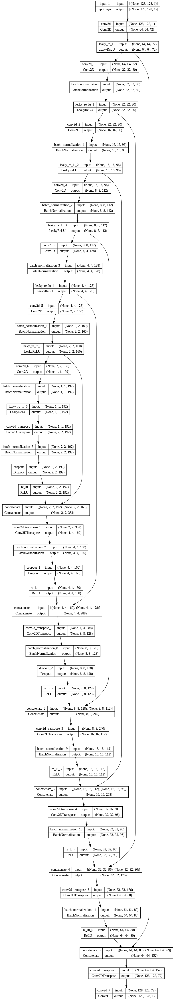

In [19]:
tf.keras.utils.plot_model(redautoencoder_eb, "redautoencoder_eb.png", show_shapes=True,expand_nested=False)

In [ ]:
#En caso de error visualkeras/layered.py. En la linea 100 del archivo,
#cambiar z = min(max(z), max_z)  por  z = min(max([z]), max_z). Guardar los cambios y recargar el kernel.
#visualkeras.layered_view(redautoencoder_eb,legend=True, draw_volume=True)

dict_keys(['loss', 'val_loss'])


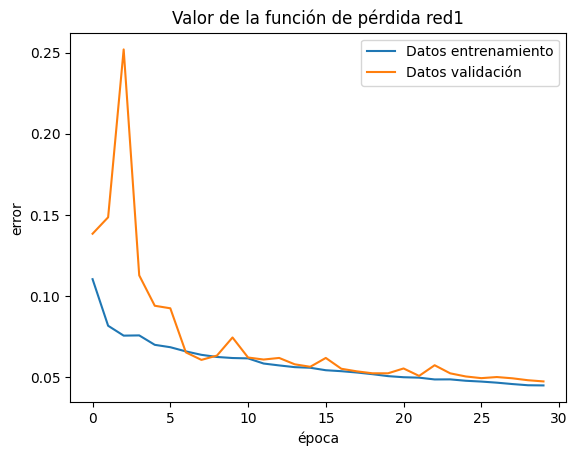

In [20]:
print(historial.history.keys())
plt.plot(historial.history['loss'])
plt.plot(historial.history['val_loss'])
plt.title('Valor de la función de pérdida red1')
plt.ylabel('error')
plt.xlabel('época')
plt.legend(['Datos entrenamiento', 'Datos validación'], loc='upper right')
plt.show()

In [21]:
#-------------------GUARDAR----------------------------------------------
xxnomarchivo='redautoencoderEB128'
#Método1:
guardarModeloH5(redautoencoder_eb, directorio_salida, xxnomarchivo)
#Método2:
guardarPesos(redautoencoder_eb, directorio_salida, xxnomarchivo+'pesos')
#Método3
#guardarModeloTF(redautoencoder_eb, directorio_salida, xxnomarchivo)

In [ ]:
#------------------EXPORTAR A JS-----------------------------------------
#Convertir el modelo tf a formato json de tensorflowjs
#!tensorflowjs_converter --input_format tf_saved_model /content/drive/MyDrive/salida/redautoencoderEB128.tf /content/drive/MyDrive/salida/redautoencoderEB128_jsontf
#Convertir el modelo h5 a formato json de tensorflowjs
#!tensorflowjs_converter --input_format keras /content/drive/MyDrive/salida/redautoencoderEB64.h5 /content/drive/MyDrive/salida/redautoencoderEB64_jsonh5

#Exportar en local
#!tensorflowjs_converter --input_format tf_saved_model d:/googledrive/salida/redautoencoderEB64.tf /content/drive/MyDrive/salida/redautoencoderEB64_jsontf
#!tensorflowjs_converter --input_format keras d:/googledrive/salida/redautoencoderEB64.h5 d:/googledrive/salida/redautoencoderEB64_jsonh5

# Etapa 1: Prueba red 1

In [22]:
aplicar_modelo_a_imagenes(redautoencoder_eb,18,19,'general100mod128','gris',
                          'general100resultado128','gris_reducida0_0x_MAPAreconstruidaAUTOENCODER')

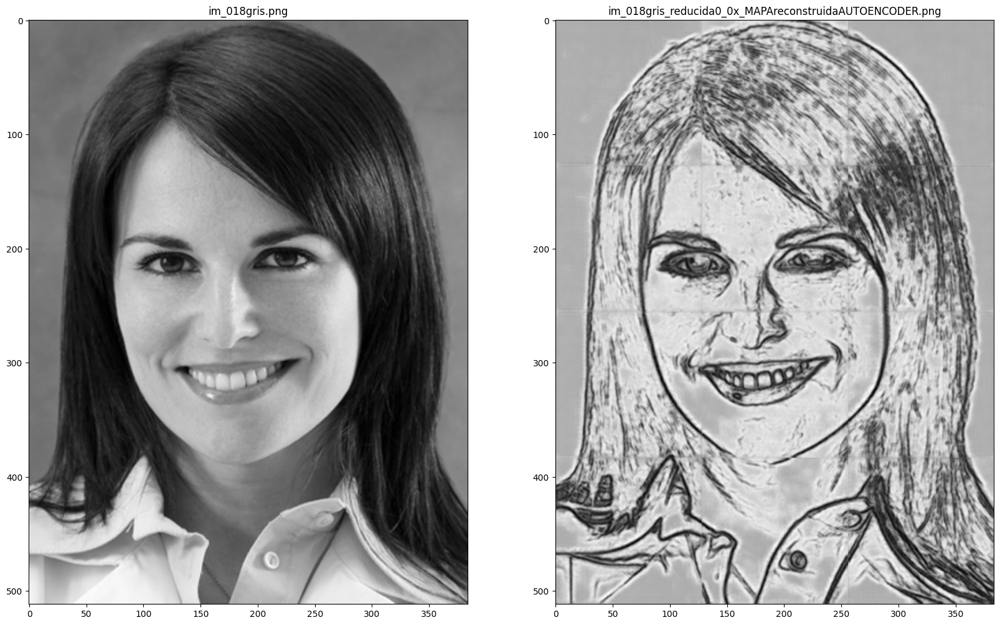

In [23]:
mostrar_imagen_2f(18,19,'general100mod128','gris',
                            'general100resultado128','gris_reducida0_0x_MAPAreconstruidaAUTOENCODER')

In [24]:
aplicar_modelo_a_imagenes(redautoencoder_eb,18,19,'general100mod128','gris_reducida2_2x',
                          'general100resultado128','gris_reducida2_2x_MAPAreconstruidaAUTOENCODER')

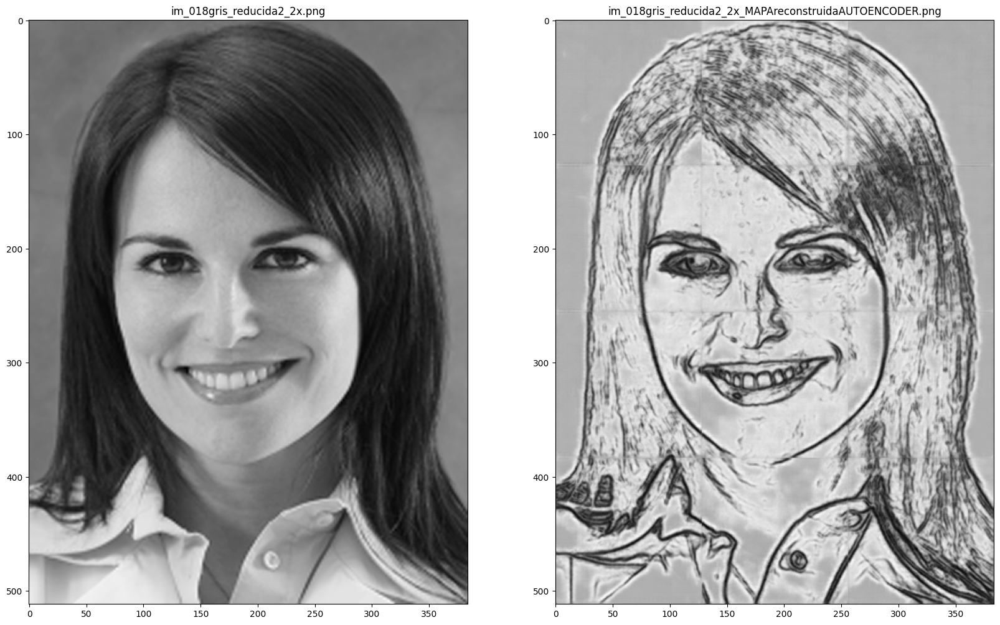

In [25]:
mostrar_imagen_2f(18,19,'general100mod128','gris_reducida2_2x',
                            'general100resultado128','gris_reducida2_2x_MAPAreconstruidaAUTOENCODER')

In [26]:
aplicar_modelo_a_imagenes(redautoencoder_eb,18,19,'general100mod128','gris_reducida4_4x',
                          'general100resultado128','gris_reducida4_4x_MAPAreconstruidaAUTOENCODER')

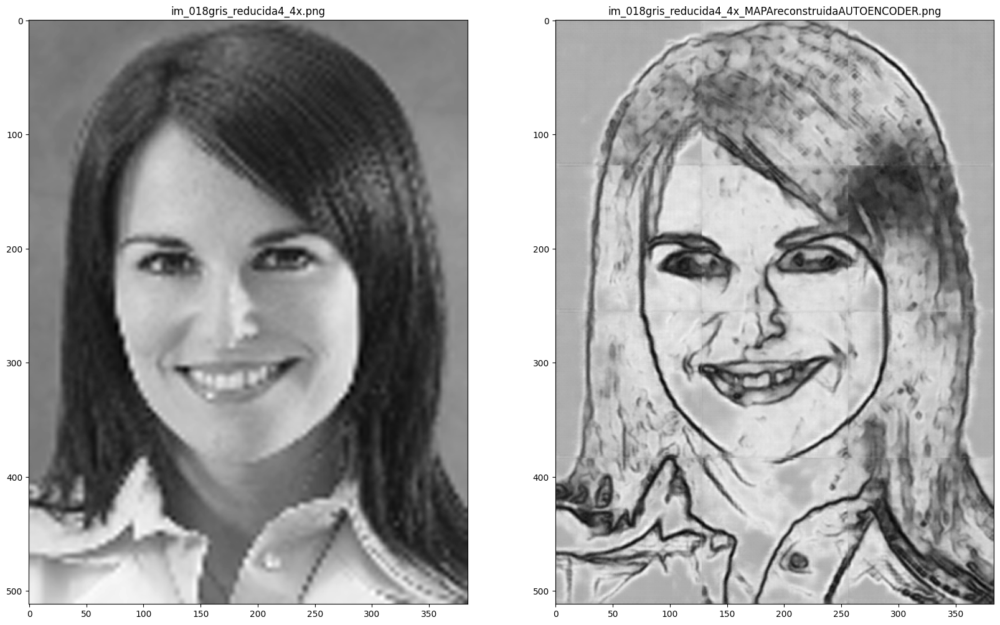

In [27]:
mostrar_imagen_2f(18,19,'general100mod128','gris_reducida4_4x',
                            'general100resultado128','gris_reducida4_4x_MAPAreconstruidaAUTOENCODER')

In [28]:
aplicar_modelo_a_imagenes(redautoencoder_eb,18,19,'general100mod128','gris_reducida6_6x',
                          'general100resultado128','gris_reducida6_6x_MAPAreconstruidaAUTOENCODER')

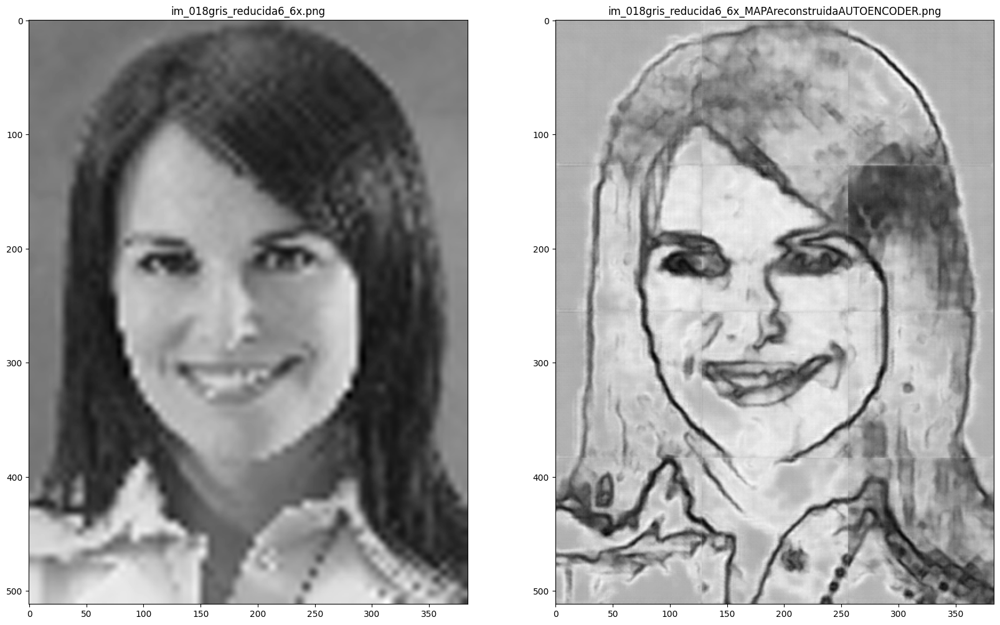

In [29]:
mostrar_imagen_2f(18,19,'general100mod128','gris_reducida6_6x',
                            'general100resultado128','gris_reducida6_6x_MAPAreconstruidaAUTOENCODER')

In [30]:
aplicar_modelo_a_imagenes(redautoencoder_eb,89,90,'general100mod128','gris_reducida4_4x',
                          'general100resultado128','gris_reducida4_4x_MAPAreconstruidaAUTOENCODER')

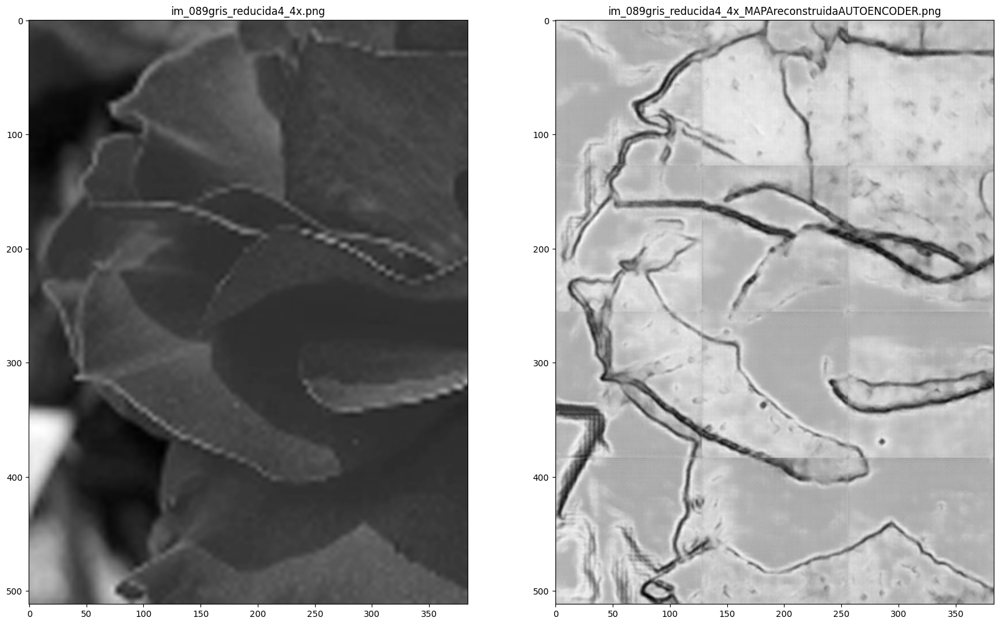

In [31]:
mostrar_imagen_2f(89,90,'general100mod128','gris_reducida4_4x',
                            'general100resultado128','gris_reducida4_4x_MAPAreconstruidaAUTOENCODER')

In [32]:
aplicar_modelo_a_imagenes(redautoencoder_eb,21,22,'general100mod128','gris_reducida4_4x',
                          'general100resultado128','gris_reducida4_4x_MAPAreconstruidaAUTOENCODER')

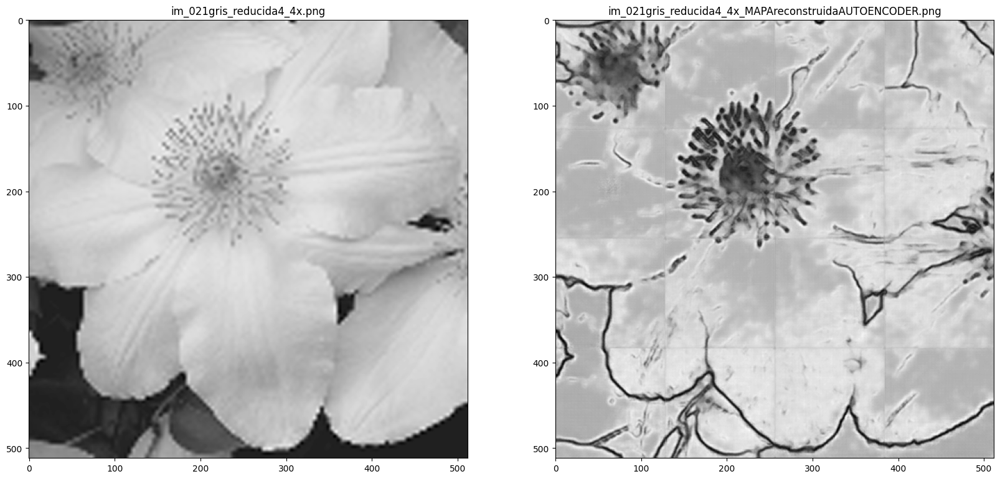

In [33]:
mostrar_imagen_2f(21,22,'general100mod128','gris_reducida4_4x',
                            'general100resultado128','gris_reducida4_4x_MAPAreconstruidaAUTOENCODER')

# Etapa 2: Entrenamiento red 2

Sin GPU: 7 minutos por época. Tiempo estimado 4 horas

Con GPU: 16 segundos por época. Tiempo estimado 10 minutos

In [34]:
#Liberar memoria
del(z_train3mapa)
del(z_test3mapa)
gc.collect()

6580

In [35]:
#Evaluar el primer modelo para obtener las predicciones
yimg_mapa_generada_train = redautoencoder_eb.predict(x_train3)
yimg_mapa_generada_test = redautoencoder_eb.predict(x_test3)
#Verificar forma (..., 128, 128, 1)
print(yimg_mapa_generada_train.shape)
print(yimg_mapa_generada_test.shape)

28/28 [==============================] - 1s 41ms/step
(3516, 128, 128, 1)
(879, 128, 128, 1)


In [36]:
#Combinar las imagenes con las predicciones anteriores para formar la entrada de la segunda red neuronal
x_train3RyM=unirDatosImagen(x_train3,yimg_mapa_generada_train)
x_test3RyM=unirDatosImagen(x_test3,yimg_mapa_generada_test)
#Verificar forma (..., 128, 128, 2)
print(x_train3RyM.shape)
print(x_test3RyM.shape)

(3516, 128, 128, 2)
(879, 128, 128, 2)


In [37]:
#Liberar memoria
del(x_train3)
del(x_test3)
del(yimg_mapa_generada_train)
del(yimg_mapa_generada_test)
gc.collect()

1462

In [38]:
historial2=redautoencoder.fit(x_train3RyM, y_train3,
                epochs=30,
                validation_data=(x_test3RyM, y_test3))

Epoch 1/30
110/110 [==============================] - 19s 156ms/step - loss: 0.0287 - val_loss: 0.0179
Epoch 2/30
110/110 [==============================] - 17s 152ms/step - loss: 0.0164 - val_loss: 0.0171
Epoch 3/30
110/110 [==============================] - 17s 154ms/step - loss: 0.0155 - val_loss: 0.0160
Epoch 4/30
110/110 [==============================] - 17s 151ms/step - loss: 0.0156 - val_loss: 0.0153
Epoch 5/30
110/110 [==============================] - 16s 150ms/step - loss: 0.0153 - val_loss: 0.0169
Epoch 6/30
110/110 [==============================] - 16s 150ms/step - loss: 0.0151 - val_loss: 0.0159
Epoch 7/30
110/110 [==============================] - 17s 151ms/step - loss: 0.0149 - val_loss: 0.0154
Epoch 8/30
110/110 [==============================] - 17s 151ms/step - loss: 0.0147 - val_loss: 0.0155
Epoch 9/30
110/110 [==============================] - 17s 150ms/step - loss: 0.0150 - val_loss: 0.0168
Epoch 10/30
110/110 [==============================] - 16s 150ms/step - l

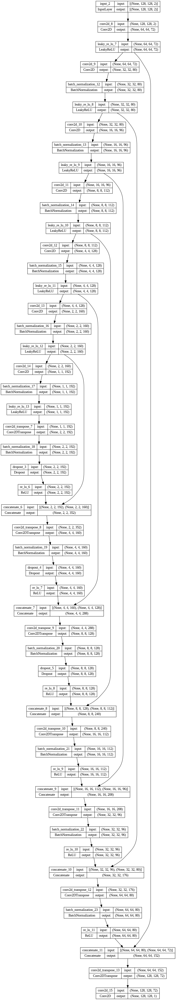

In [39]:
tf.keras.utils.plot_model(redautoencoder, "redautoencoder.png", show_shapes=True,expand_nested=False)

In [ ]:
#Esta estructura en paralelo no se puede graficar con visualkeras
#visualkeras.layered_view(redautoencoder,legend=True, draw_volume=True)

dict_keys(['loss', 'val_loss'])


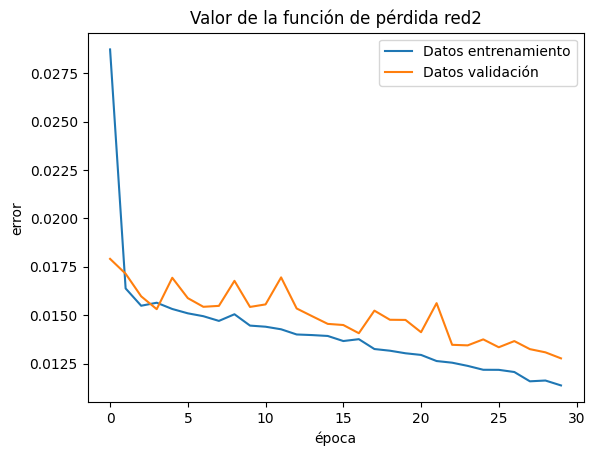

In [40]:
print(historial2.history.keys())
plt.plot(historial2.history['loss'])
plt.plot(historial2.history['val_loss'])
plt.title('Valor de la función de pérdida red2')
plt.ylabel('error')

plt.xlabel('época')
plt.legend(['Datos entrenamiento', 'Datos validación'], loc='upper right')
plt.show()

In [41]:
#---------------Guardar
xxnomarchivo='redautoencoderAC2_128'
#Método1:
guardarModeloH5(redautoencoder, directorio_salida, xxnomarchivo)
#Método2:
guardarPesos(redautoencoder, directorio_salida, xxnomarchivo+'pesos')
#Método3:
#guardarModeloTF(redautoencoder, directorio_salida, xxnomarchivo)

In [ ]:
#------------------EXPORTAR A JS-----------------------------------------
#Convertir el modelo tf a formato json de tensorflowjs
#!tensorflowjs_converter --input_format tf_saved_model /content/drive/MyDrive/salida/redautoencoderAC2_128.tf /content/drive/MyDrive/salida/redautoencoderAC2_128_jsontf
#Convertir el modelo h5 a formato json de tensorflowjs
#!tensorflowjs_converter --input_format keras /content/drive/MyDrive/salida/redautoencoderAC2_64.h5 /content/drive/MyDrive/salida/redautoencoderAC2_64_jsonh5

#Exportar en local
#!tensorflowjs_converter --input_format tf_saved_model d:/googledrive/salida/redautoencoderAC2_64.tf /content/drive/MyDrive/salida/redautoencoderAC2_64_jsontf
#!tensorflowjs_converter --input_format keras d:/googledrive/salida/redautoencoderAC2_64.h5 d:/googledrive/salida/redautoencoderAC2_64_jsonh5

In [42]:
#Liberar memoria
del(x_train3RyM)
del(x_test3RyM)

del(y_train3)
del(y_test3)
gc.collect()

16253

In [43]:
#Guardar la primera vez
xxnomarchivo='redcombinada128_epoca1'
guardarModeloH5(redcombinada, directorio_salida, xxnomarchivo)
guardarPesos(redcombinada, directorio_salida, xxnomarchivo+'pesos')

# Etapa 2: Prueba red 2

In [44]:
aplicar_modeloAC_a_imagenes(redautoencoder,18,19,'general100mod128','gris',
                            'general100resultado128','gris_reducida0_0x_MAPAreconstruidaAUTOENCODER',
                            'general100resultado128','gris_reducida0_0x_reconstruidaAUTOENCODER_AC')

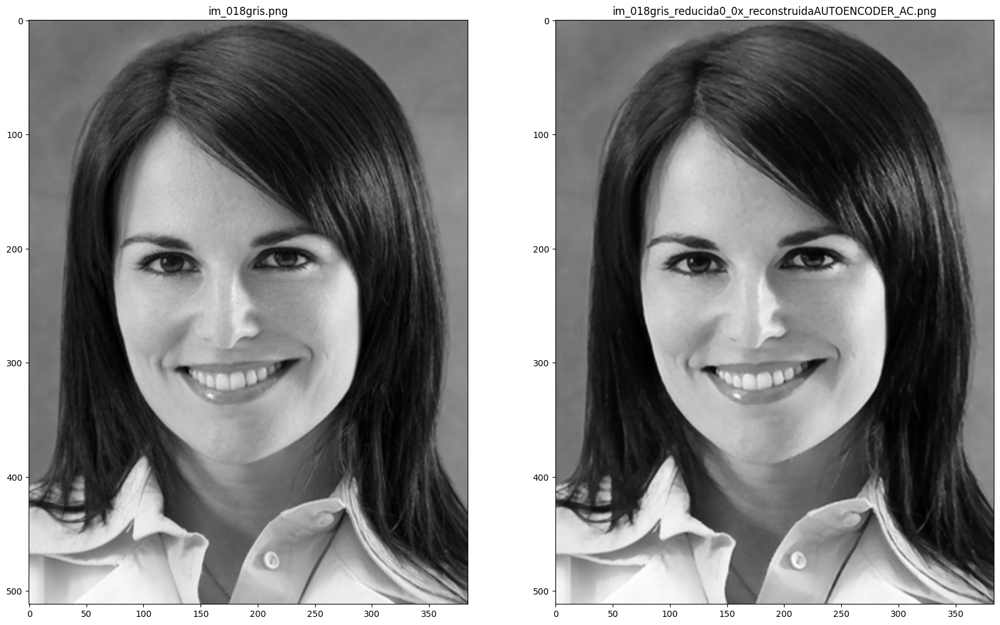

In [45]:
mostrar_imagen_2f(18,19,'general100mod128','gris',
                            'general100resultado128','gris_reducida0_0x_reconstruidaAUTOENCODER_AC')

In [46]:
aplicar_modeloAC_a_imagenes(redautoencoder,18,19,'general100mod128','gris_reducida2_2x',
                            'general100resultado128','gris_reducida2_2x_MAPAreconstruidaAUTOENCODER',
                            'general100resultado128','gris_reducida2_2x_reconstruidaAUTOENCODER_AC')

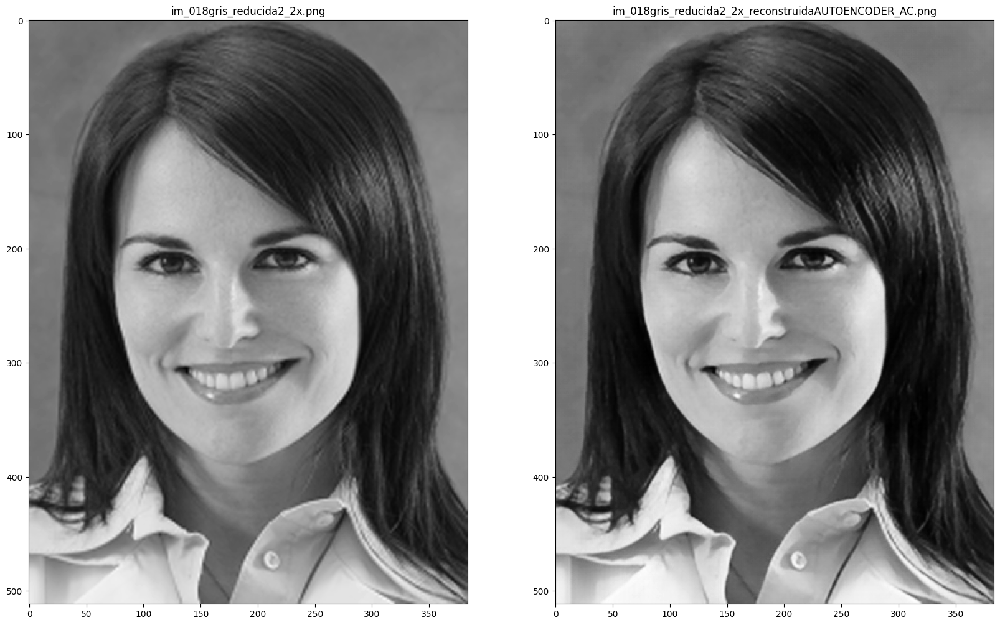

In [47]:
mostrar_imagen_2f(18,19,'general100mod128','gris_reducida2_2x',
                            'general100resultado128','gris_reducida2_2x_reconstruidaAUTOENCODER_AC')

In [48]:
#18,19,
aplicar_modeloAC_a_imagenes(redautoencoder,18,19,'general100mod128','gris_reducida4_4x',
                            'general100resultado128','gris_reducida4_4x_MAPAreconstruidaAUTOENCODER',
                            'general100resultado128','gris_reducida4_4x_reconstruidaAUTOENCODER_AC')

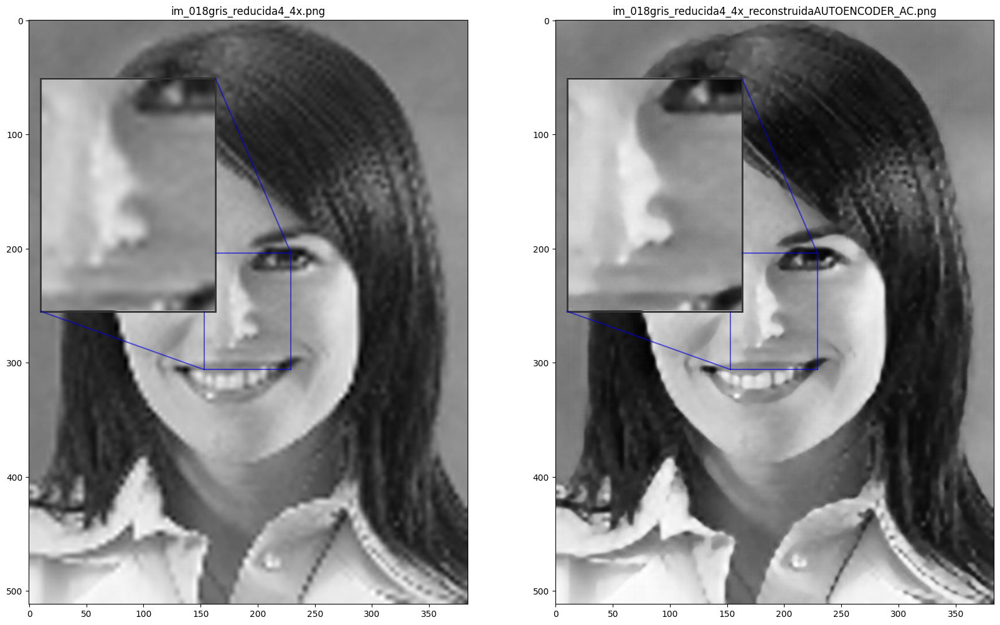

In [49]:
mostrar_imagen_2f_lupa(18,19,'general100mod128','gris_reducida4_4x',
                            'general100resultado128','gris_reducida4_4x_reconstruidaAUTOENCODER_AC')

In [50]:
aplicar_modeloAC_a_imagenes(redautoencoder,18,19,'general100mod128','gris_reducida6_6x',
                            'general100resultado128','gris_reducida6_6x_MAPAreconstruidaAUTOENCODER',
                            'general100resultado128','gris_reducida6_6x_reconstruidaAUTOENCODER_AC')

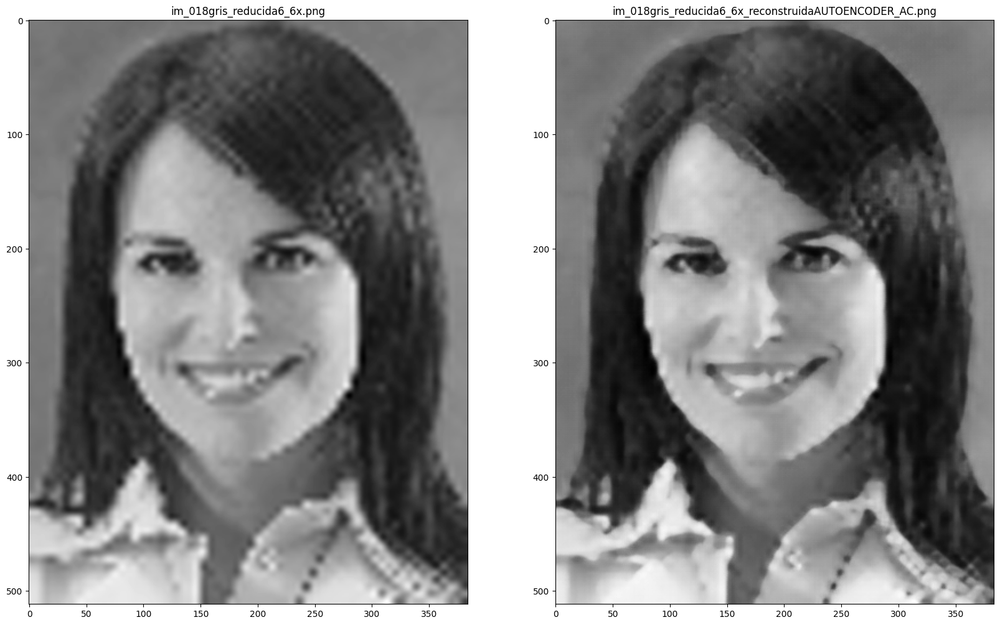

In [51]:
mostrar_imagen_2f(18,19,'general100mod128','gris_reducida6_6x',
                            'general100resultado128','gris_reducida6_6x_reconstruidaAUTOENCODER_AC')

In [52]:
aplicar_modeloAC_a_imagenes(redautoencoder,89,90,'general100mod128','gris_reducida4_4x',
                            'general100resultado128','gris_reducida4_4x_MAPAreconstruidaAUTOENCODER',
                            'general100resultado128','gris_reducida4_4x_reconstruidaAUTOENCODER_AC')

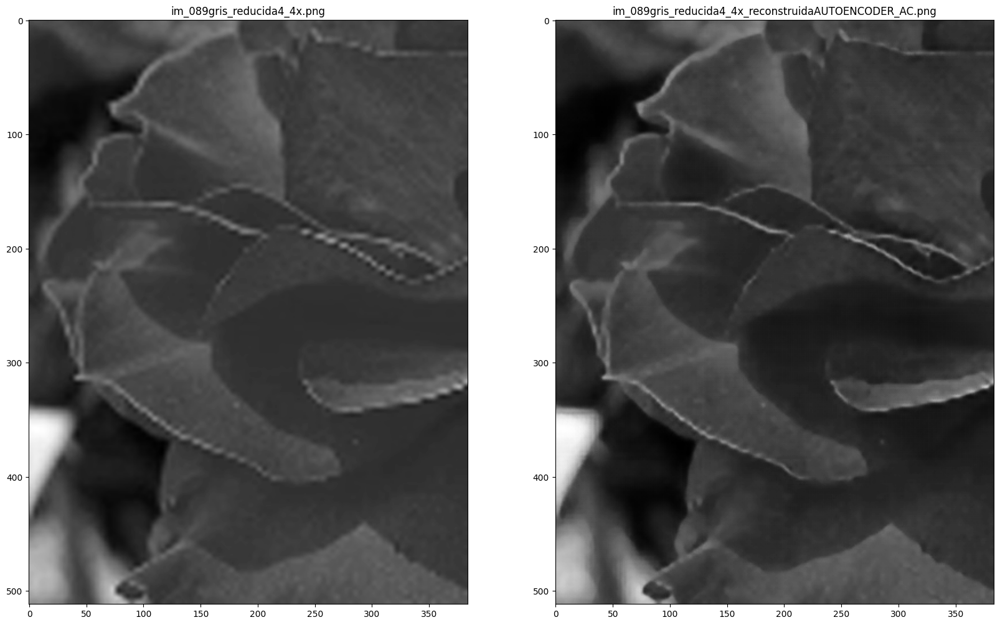

In [53]:
mostrar_imagen_2f(89,90,'general100mod128','gris_reducida4_4x',
                            'general100resultado128','gris_reducida4_4x_reconstruidaAUTOENCODER_AC')

In [54]:
aplicar_modeloAC_a_imagenes(redautoencoder,21,22,'general100mod128','gris_reducida4_4x',
                            'general100resultado128','gris_reducida4_4x_MAPAreconstruidaAUTOENCODER',
                            'general100resultado128','gris_reducida4_4x_reconstruidaAUTOENCODER_AC')

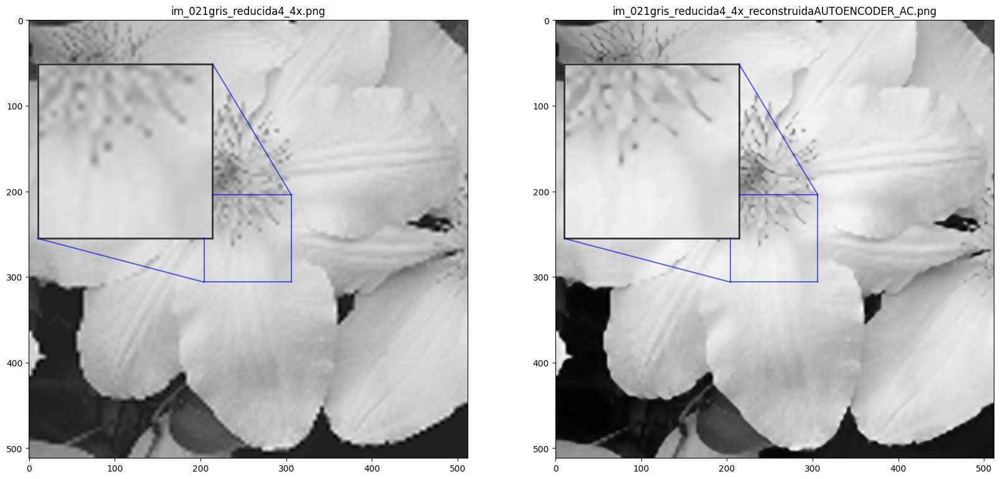

In [55]:
mostrar_imagen_2f_lupa(21,22,'general100mod128','gris_reducida4_4x',
                            'general100resultado128','gris_reducida4_4x_reconstruidaAUTOENCODER_AC')

# Etapa 3: Entrenamiento combinado

In [ ]:
#historial_ent_loss_red1=list()
#historial_ent_loss_red2=list()
#historial_val_loss_red1=list()
#historial_val_loss_red2=list()

## Construir conjunto de parches de 128x128 para las 50 imágenes con aumento de datos

Este bloque es un entrenamiento con las 50 imágenes, aplicando el aumento de datos, considerando el reflejo vertical y horizontal. Esto se hace porque no es posible entrenar en GoogleColab con las 150 imágenes resultantes del aumento (Debido a los 12GB de RAM que tiene GoogleColab son insuficientes).

Entonces el perfeccionmiento del modelo se realizo en una computadora propia con 16GB de RAM. Con el aumento de datos se tienen 300 imágenes. Sin embargo para 16GB de RAM el valor adecuado fue de 150 imágnes.

Se observo que el entrenamiento combinado tiende a reducir el error de la primera red a 0.040 y de la segunda a 0.011.

El valor óptimo de iteraciones fue de 18000. El entrenamiento se separo en bloques de 600 iteraciones, y la evaluacion se realizo al final de cada bloque

Tambien se confirma que mientras más datos el modelo convolucional genera una mejor solución. Siendo el unico limite la cantidad de memoria RAM para cargar los datos.

El uso del espacio intermedio de transformación acelera la convergencia y permitio conseguir un modelo óptimo sin el uso intensivo de GPU.

In [10]:
#-----Entrenamiento combinado con 50 imágenes
#Se puede agregar más transformaciones, dependiendo del hardware disponible.
data_img_reducida, data_img_mapa, data_img = [], [], []
num_imagenes=50
#-----Con reducción de tamaño 6x,4x,2x con interpolacion bicúbica, desenfoque
data_img_reducida=construirConjuntoParches(1,num_imagenes+1,'general100mod128',['gris_reducida6_6x','gris_reducida4_4x','gris_reducida2_2x','gris','gris_desenfoque'])
data_img_mapa=construirConjuntoParches(1,num_imagenes+1,'general100mod128',['gris_mapaCOMB','gris_mapaCOMB','gris_mapaCOMB','gris_mapaCOMB','gris_mapaCOMB'])
data_img=construirConjuntoParches(1,num_imagenes+1,'general100mod128',['gris','gris','gris','gris','gris'])
#-----Con reducción de tamaño 6x,4x,2x con interpolacion vecinos mas cercanos
data_img_reducida.extend(construirConjuntoParches(1,num_imagenes+1,'general100mod128',['gris_reducida6_6xnearest','gris_reducida4_4xnearest','gris_reducida2_2xnearest']))
data_img_mapa.extend(construirConjuntoParches(1,num_imagenes+1,'general100mod128',['gris_mapaCOMB','gris_mapaCOMB','gris_mapaCOMB']))
data_img.extend(construirConjuntoParches(1,num_imagenes+1,'general100mod128',['gris','gris','gris']))
#-----Con reducción de tamaño 6x,4x,2x con interpolacion vecinos mas cercanos + desenfoque
#data_img_reducida.extend(construirConjuntoParches(1,num_imagenes+1,'general100mod128',['gris_reducida6_6xnearestblur','gris_reducida4_4xnearestblur','gris_reducida2_2xnearestblur']))
#data_img_mapa.extend(construirConjuntoParches(1,num_imagenes+1,'general100mod128',['gris_mapaCOMB','gris_mapaCOMB','gris_mapaCOMB']))
#data_img.extend(construirConjuntoParches(1,num_imagenes+1,'general100mod128',['gris','gris','gris']))
#-----------------------------------------------------------------------------------------------------------------------
#Mostrar tamaño
print(len(data_img_reducida))
print(len(data_img_mapa))
print(len(data_img))

#-----------------------Agregar los reflejos horizontal y vertical correspondientes--------------------------------
#Se puede usar 50 que requiere al menos 16GB RAM. Si desea ejecutarlo en GoogleColab con 12GB RAM solo se puede con 25
num_imagenes=50
data_img_reducida.extend(construirConjuntoParches(100,100+(num_imagenes*2),'general100mod128',['gris_reducida6_6x','gris_reducida4_4x','gris_reducida2_2x','gris','gris_desenfoque']))
data_img_mapa.extend(construirConjuntoParches(100,100+(num_imagenes*2),'general100mod128',['gris_mapaCOMB','gris_mapaCOMB','gris_mapaCOMB','gris_mapaCOMB','gris_mapaCOMB']))
data_img.extend(construirConjuntoParches(100,100+(num_imagenes*2),'general100mod128',['gris','gris','gris','gris','gris']))

data_img_reducida.extend(construirConjuntoParches(100,100+(num_imagenes*2),'general100mod128',['gris_reducida6_6xnearest','gris_reducida4_4xnearest','gris_reducida2_2xnearest']))
data_img_mapa.extend(construirConjuntoParches(100,100+(num_imagenes*2),'general100mod128',['gris_mapaCOMB','gris_mapaCOMB','gris_mapaCOMB']))
data_img.extend(construirConjuntoParches(100,100+(num_imagenes*2),'general100mod128',['gris','gris','gris']))

#data_img_reducida.extend(construirConjuntoParches(100,100+(num_imagenes*2),'general100mod128',['gris_reducida6_6xnearestblur','gris_reducida4_4xnearestblur','gris_reducida2_2xnearestblur']))
#data_img_mapa.extend(construirConjuntoParches(100,100+(num_imagenes*2),'general100mod128',['gris_mapaCOMB','gris_mapaCOMB','gris_mapaCOMB']))
#data_img.extend(construirConjuntoParches(100,100+(num_imagenes*2),'general100mod128',['gris','gris','gris']))
#-----------------------------------------------------------------------------------------------------------------------

#Esto es equivalente a agregar los reflejos horizontal y vertical correspondientes
#pero requiere más memoria RAM por el método flip
#tam=int(len(data_img_reducida)/1)
#for k in range(0,tam):
#    data_img_reducida.append(cv2.flip(data_img_reducida[k],0))
#    data_img_mapa.append(cv2.flip(data_img_mapa[k],0))
#    data_img.append(cv2.flip(data_img[k],0))
#    data_img_reducida.append(cv2.flip(data_img_reducida[k],1))
#    data_img_mapa.append(cv2.flip(data_img_mapa[k],1))
#    data_img.append(cv2.flip(data_img[k],1))
#-----------------------------------------------------------------------------------------------------------------------
#Mostrar tamaño
print(len(data_img_reducida))
print(len(data_img_mapa))
print(len(data_img))


#Redimensionar datos
for k in range(0,len(data_img_reducida)):
    data_img_reducida[k]=data_img_reducida[k].reshape((TAM_PARCHE,TAM_PARCHE))
    data_img_mapa[k]=data_img_mapa[k].reshape((TAM_PARCHE,TAM_PARCHE))
    data_img[k]=data_img[k].reshape((TAM_PARCHE,TAM_PARCHE))
#Convertir datos a estructuras de array numpy
data_img_reducida_array=np.array(data_img_reducida)
data_img_mapa_array=np.array(data_img_mapa)
data_img_array=np.array(data_img)

del(data_img_reducida)
del(data_img_mapa)
del(data_img)
gc.collect()


7032
7032
7032
21192
21192
21192


281

In [11]:
#Normalizar valores de datos
data_img_reducida_array_nor = (data_img_reducida_array.astype('float32') - 127.5) / 127.5
data_img_mapa_array_nor = (data_img_mapa_array.astype('float32') - 127.5) / 127.5
data_img_array_nor = (data_img_array.astype('float32') - 127.5) / 127.5
#Verificar forma (...,128,128)
print(data_img_reducida_array_nor.shape)
print(data_img_mapa_array_nor.shape)
print(data_img_array_nor.shape)

del(data_img_reducida_array)
del(data_img_mapa_array)
del(data_img_array)
gc.collect()
#Agregar una dimension adicional al final
num_registros=len(data_img_array_nor);
data_img_reducida_array_nor=data_img_reducida_array_nor.reshape((num_registros,TAM_PARCHE,TAM_PARCHE,1))
data_img_mapa_array_nor=data_img_mapa_array_nor.reshape((num_registros,TAM_PARCHE,TAM_PARCHE,1))
data_img_array_nor=data_img_array_nor.reshape((num_registros,TAM_PARCHE,TAM_PARCHE,1))
#Verificar forma (..., 128, 128, 1)
print(data_img_reducida_array_nor.shape)
print(data_img_mapa_array_nor.shape)
print(data_img_array_nor.shape)

(21192, 128, 128)
(21192, 128, 128)
(21192, 128, 128)
(21192, 128, 128, 1)
(21192, 128, 128, 1)
(21192, 128, 128, 1)


In [12]:
#Dividir en datos de entrenamiento y validación
from sklearn.model_selection import train_test_split
x_train3, x_test3, y_train3, y_test3, z_train3mapa, z_test3mapa = train_test_split(data_img_reducida_array_nor,data_img_array_nor,data_img_mapa_array_nor,test_size=0.2,random_state=0)
print('Tamaño x_train3=',x_train3.shape)
print('Tamaño y_train3=',y_train3.shape)
print('Tamaño z_train3mapa=',z_train3mapa.shape)
print('Tamaño x_test3=',x_test3.shape)
print('Tamaño y_test3=',y_test3.shape)
print('Tamaño z_test3mapa=',z_test3mapa.shape)

Tamaño x_train3= (16953, 128, 128, 1)
Tamaño y_train3= (16953, 128, 128, 1)
Tamaño z_train3mapa= (16953, 128, 128, 1)
Tamaño x_test3= (4239, 128, 128, 1)
Tamaño y_test3= (4239, 128, 128, 1)
Tamaño z_test3mapa= (4239, 128, 128, 1)


In [13]:
del(data_img_reducida_array_nor)
del(data_img_mapa_array_nor)
del(data_img_array_nor)
gc.collect()

0

In [14]:
#Método2:
xxnomarchivo='redcombinada128_epoca1'+'pesos'
redautoencoder_eb=RedAutoencoderEB()
redautoencoder=RedAutoencoder()
#Originalmente se entreno con optimizer='adam' pero una reciente actualizacion de tensorflow
#indica que debe usarse optimizer=tf.keras.optimizers.legacy.Adam() al abrir modelos guardados como pesos
#redautoencoder_eb.compile(optimizer=tf.keras.optimizers.legacy.Adam(learning_rate=0.001), loss=funcion_de_perdida_red1)
#redautoencoder.compile(optimizer=tf.keras.optimizers.legacy.Adam(learning_rate=0.001), loss=funcion_de_perdida_red2)
redautoencoder_eb.compile(optimizer=tf.keras.optimizers.legacy.Adam(learning_rate=0.001), loss=funcion_de_perdida_red1)
redautoencoder.compile(optimizer=tf.keras.optimizers.legacy.Adam(learning_rate=0.001), loss=funcion_de_perdida_red2)


redcombinada = RedCombinada(redautoencoder_eb, redautoencoder)
# Para restaurar el estado del modelo, es necesario compilar con los mismos
# agumentos. Y luego invocarlo con algunos ejemplos antes de llamar a load_weights
#redcombinada.compile(optimizer=tf.keras.optimizers.legacy.Adam(learning_rate=0.001), loss=funcion_de_perdida_red_combinada)
redcombinada.compile(optimizer=tf.keras.optimizers.legacy.Adam(learning_rate=0.001), loss=funcion_de_perdida_red_combinada)

# Esto inicializa las variables utilizadas por los optimizadores,
# así como cualquier variable métrica con estado
num_filas_a_procesar=2
ix = np.random.randint(0, len(x_train3), num_filas_a_procesar)
ximg=x_train3[ix]
yimg=y_train3[ix]
zimg_mapa=z_train3mapa[ix]

redcombinada.train_on_batch(ximg, [zimg_mapa,yimg])
# Cargar el estado del modelo.
redcombinada.load_weights(directorio_salida+xxnomarchivo+'/'+xxnomarchivo)
gc.collect()

11346

In [25]:
#Verificar el estado de la red1 y red2 para los datos de validacion
valorperdida=redcombinada.evaluate(x_test3, [z_test3mapa,y_test3])
print('Validación. Función de pérdida:'+str(valorperdida))
#Verificar el estado de la red1 y red2 para los datos de entrenamiento
valorperdida2=redcombinada.evaluate(x_train3, [z_train3mapa,y_train3])
print('Entrenamiento. Función de pérdida:'+str(valorperdida2))
gc.collect()

133/133 [==============================] - 299s 2s/step - loss: 0.0976 - model_6_loss: 0.0735 - model_7_loss: 0.0241
Validación. Función de pérdida:[0.09762696176767349, 0.07351663708686829, 0.024110322818160057]
530/530 [==============================] - 1182s 2s/step - loss: 0.0967 - model_6_loss: 0.0730 - model_7_loss: 0.0237
Entrenamiento. Función de pérdida:[0.09671548008918762, 0.07297959178686142, 0.02373582310974598]


1612

## (Bloque1)

In [26]:
#Este bloque de código genera 600 iteraciones.
#Tiempo requerido: 1.5 Horas sin GPU, en un computador con 16GB RAM, Pentium I7
#Tiempo requerido: 5 minutos con GPU
#El uso de RAM varia de 7GB a 13GB

t_inicio = datetime.now()
#Cantidad tamaño de lote aleatorio, debe ser pequeño.
num_filas_a_procesar=20
#num_veces configura la cantidad de iteraciones.
num_veces=400
for i in range(1,num_veces+1):
    ix = np.random.randint(0, len(x_train3), num_filas_a_procesar)
    ximg=x_train3[ix]#.astype(np.float64)
    zimg_mapa=z_train3mapa[ix]
    yimg=y_train3[ix]
    [zimg_mapa_generada,yimg_generada] = redcombinada.predict(ximg,verbose=0)

    redcombinada.train_on_batch(ximg, [zimg_mapa,yimg])
    redautoencoder.train_on_batch(unirDatosImagen(ximg,zimg_mapa_generada),yimg)

    if(i%50==0):
        print('i '+str(i))

t_fin = datetime.now()
tiempo_ejecucion = t_fin-t_inicio
print("Tiempo de ejecución: ", tiempo_ejecucion)
gc.collect()

i 50
i 100
i 150
i 200
i 250
i 300
i 350
i 400
Tiempo de ejecución:  0:55:22.991178


35385

In [27]:
#Sin GPU
#15 minutos evaluacion entrenamiento
#5 minutos evaluacion validacion
#Verificar el estado de la red1 y red2 para los datos de entrenamiento
print('DATOS ENTRENAMIENTO')
result=redcombinada.evaluate(x_train3, [z_train3mapa,y_train3])
#historial_ent_loss_red1.append(result[1])
#historial_ent_loss_red2.append(result[2])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#Verificar el estado de la red1 y red2 para los datos de validacion
print('DATOS VALIDACIÓN')
result=redcombinada.evaluate(x_test3, [z_test3mapa,y_test3])
#historial_val_loss_red1.append(result[1])
#historial_val_loss_red2.append(result[2])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#-------------------------------------------------------

xxnomarchivo='redcombinada128_epoca1'
#Método1:
guardarModeloH5(redcombinada, directorio_salida, xxnomarchivo)
#Método2:
guardarPesos(redcombinada, directorio_salida, xxnomarchivo+'pesos')
#Método3
#guardarModeloTF(redcombinada, directorio_salida, xxnomarchivo)
del(result)
gc.collect()

DATOS ENTRENAMIENTO
530/530 [==============================] - 1219s 2s/step - loss: 0.0771 - model_6_loss: 0.0601 - model_7_loss: 0.0170
Función de pérdida red1:0.06005585938692093
Función de pérdida red2:0.017037559300661087
DATOS VALIDACIÓN
133/133 [==============================] - 314s 2s/step - loss: 0.0787 - model_6_loss: 0.0613 - model_7_loss: 0.0174
Función de pérdida red1:0.06126759946346283
Función de pérdida red2:0.01741618849337101


0

## (Bloque2)

In [28]:
#Este bloque de código genera 600 iteraciones.
#Tiempo requerido: 1.5 Horas sin GPU, en un computador con 16GB RAM, Pentium I7
#Tiempo requerido: 5 minutos con GPU
#El uso de RAM varia de 7GB a 13GB

t_inicio = datetime.now()
#Cantidad tamaño de lote aleatorio, debe ser pequeño.
num_filas_a_procesar=20
#num_veces configura la cantidad de iteraciones.
num_veces=400
for i in range(1,num_veces+1):
    ix = np.random.randint(0, len(x_train3), num_filas_a_procesar)
    ximg=x_train3[ix]#.astype(np.float64)
    zimg_mapa=z_train3mapa[ix]
    yimg=y_train3[ix]
    [zimg_mapa_generada,yimg_generada] = redcombinada.predict(ximg,verbose=0)

    redcombinada.train_on_batch(ximg, [zimg_mapa,yimg])
    redautoencoder.train_on_batch(unirDatosImagen(ximg,zimg_mapa_generada),yimg)

    if(i%50==0):
        print('i '+str(i))

t_fin = datetime.now()
tiempo_ejecucion = t_fin-t_inicio
print("Tiempo de ejecución: ", tiempo_ejecucion)
gc.collect()

i 50
i 100
i 150
i 200
i 250
i 300
i 350
i 400
Tiempo de ejecución:  0:54:42.749841


36838

In [29]:
#Sin GPU
#15 minutos evaluacion entrenamiento
#5 minutos evaluacion validacion
#Verificar el estado de la red1 y red2 para los datos de entrenamiento
print('DATOS ENTRENAMIENTO')
result=redcombinada.evaluate(x_train3, [z_train3mapa,y_train3])
#historial_ent_loss_red1.append(result[1])
#historial_ent_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#Verificar el estado de la red1 y red2 para los datos de validacion
print('DATOS VALIDACIÓN')
result=redcombinada.evaluate(x_test3, [z_test3mapa,y_test3])
#historial_val_loss_red1.append(result[1])
#historial_val_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#-------------------------------------------------------

xxnomarchivo='redcombinada128_epoca1'
#Método1:
guardarModeloH5(redcombinada, directorio_salida, xxnomarchivo)
#Método2:
guardarPesos(redcombinada, directorio_salida, xxnomarchivo+'pesos')
#Método3
#guardarModeloTF(redcombinada, directorio_salida, xxnomarchivo)
del(result)
gc.collect()

DATOS ENTRENAMIENTO
530/530 [==============================] - 1168s 2s/step - loss: 0.0748 - model_6_loss: 0.0605 - model_7_loss: 0.0142
Función de pérdida red1:0.060522399842739105
Función de pérdida red2:0.014233165420591831
DATOS VALIDACIÓN
133/133 [==============================] - 286s 2s/step - loss: 0.0765 - model_6_loss: 0.0618 - model_7_loss: 0.0147
Función de pérdida red1:0.06181834638118744
Función de pérdida red2:0.014684794470667839


0

## (Bloque3)

In [30]:
#Este bloque de código genera 600 iteraciones.
#Tiempo requerido: 1.5 Horas sin GPU, en un computador con 16GB RAM, Pentium I7
#Tiempo requerido: 5 minutos con GPU
#El uso de RAM varia de 7GB a 13GB

t_inicio = datetime.now()
#Cantidad tamaño de lote aleatorio, debe ser pequeño.
num_filas_a_procesar=20
#num_veces configura la cantidad de iteraciones.
num_veces=400
for i in range(1,num_veces+1):
    ix = np.random.randint(0, len(x_train3), num_filas_a_procesar)
    ximg=x_train3[ix]#.astype(np.float64)
    zimg_mapa=z_train3mapa[ix]
    yimg=y_train3[ix]
    [zimg_mapa_generada,yimg_generada] = redcombinada.predict(ximg,verbose=0)

    redcombinada.train_on_batch(ximg, [zimg_mapa,yimg])
    redautoencoder.train_on_batch(unirDatosImagen(ximg,zimg_mapa_generada),yimg)

    if(i%50==0):
        print('i '+str(i))

t_fin = datetime.now()
tiempo_ejecucion = t_fin-t_inicio
print("Tiempo de ejecución: ", tiempo_ejecucion)
gc.collect()

i 50
i 100
i 150
i 200
i 250
i 300
i 350
i 400
Tiempo de ejecución:  0:53:29.926930


36838

In [31]:
#Sin GPU
#15 minutos evaluacion entrenamiento
#5 minutos evaluacion validacion
#Verificar el estado de la red1 y red2 para los datos de entrenamiento
print('DATOS ENTRENAMIENTO')
result=redcombinada.evaluate(x_train3, [z_train3mapa,y_train3])
#historial_ent_loss_red1.append(result[1])
#historial_ent_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#Verificar el estado de la red1 y red2 para los datos de validacion
print('DATOS VALIDACIÓN')
result=redcombinada.evaluate(x_test3, [z_test3mapa,y_test3])
#historial_val_loss_red1.append(result[1])
#historial_val_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#-------------------------------------------------------

xxnomarchivo='redcombinada128_epoca1'
#Método1:
guardarModeloH5(redcombinada, directorio_salida, xxnomarchivo)
#Método2:
guardarPesos(redcombinada, directorio_salida, xxnomarchivo+'pesos')
#Método3
#guardarModeloTF(redcombinada, directorio_salida, xxnomarchivo)
del(result)
gc.collect()

DATOS ENTRENAMIENTO
530/530 [==============================] - 1167s 2s/step - loss: 0.0677 - model_6_loss: 0.0535 - model_7_loss: 0.0142
Función de pérdida red1:0.05346231907606125
Función de pérdida red2:0.014211529865860939
DATOS VALIDACIÓN
133/133 [==============================] - 292s 2s/step - loss: 0.0694 - model_6_loss: 0.0548 - model_7_loss: 0.0146
Función de pérdida red1:0.054827041923999786
Función de pérdida red2:0.014582723379135132


0

## (Bloque4)

In [32]:
#Este bloque de código genera 600 iteraciones.
#Tiempo requerido: 1.5 Horas sin GPU, en un computador con 16GB RAM, Pentium I7
#Tiempo requerido: 5 minutos con GPU
#El uso de RAM varia de 7GB a 13GB

t_inicio = datetime.now()
#Cantidad tamaño de lote aleatorio, debe ser pequeño.
num_filas_a_procesar=20
#num_veces configura la cantidad de iteraciones.
num_veces=400
for i in range(1,num_veces+1):
    ix = np.random.randint(0, len(x_train3), num_filas_a_procesar)
    ximg=x_train3[ix]#.astype(np.float64)
    zimg_mapa=z_train3mapa[ix]
    yimg=y_train3[ix]
    [zimg_mapa_generada,yimg_generada] = redcombinada.predict(ximg,verbose=0)

    redcombinada.train_on_batch(ximg, [zimg_mapa,yimg])
    redautoencoder.train_on_batch(unirDatosImagen(ximg,zimg_mapa_generada),yimg)

    if(i%50==0):
        print('i '+str(i))

t_fin = datetime.now()
tiempo_ejecucion = t_fin-t_inicio
print("Tiempo de ejecución: ", tiempo_ejecucion)
gc.collect()

i 50
i 100
i 150
i 200
i 250
i 300
i 350
i 400
Tiempo de ejecución:  0:53:45.587187


36838

In [33]:
#Sin GPU
#15 minutos evaluacion entrenamiento
#5 minutos evaluacion validacion
#Verificar el estado de la red1 y red2 para los datos de entrenamiento
print('DATOS ENTRENAMIENTO')
result=redcombinada.evaluate(x_train3, [z_train3mapa,y_train3])
#historial_ent_loss_red1.append(result[1])
#historial_ent_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#Verificar el estado de la red1 y red2 para los datos de validacion
print('DATOS VALIDACIÓN')
result=redcombinada.evaluate(x_test3, [z_test3mapa,y_test3])
#historial_val_loss_red1.append(result[1])
#historial_val_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#-------------------------------------------------------

xxnomarchivo='redcombinada128_epoca1'
#Método1:
guardarModeloH5(redcombinada, directorio_salida, xxnomarchivo)
#Método2:
guardarPesos(redcombinada, directorio_salida, xxnomarchivo+'pesos')
#Método3
#guardarModeloTF(redcombinada, directorio_salida, xxnomarchivo)
del(result)
gc.collect()

DATOS ENTRENAMIENTO
530/530 [==============================] - 1169s 2s/step - loss: 0.0652 - model_6_loss: 0.0514 - model_7_loss: 0.0138
Función de pérdida red1:0.05140478536486626
Función de pérdida red2:0.01379062794148922
DATOS VALIDACIÓN
133/133 [==============================] - 288s 2s/step - loss: 0.0675 - model_6_loss: 0.0531 - model_7_loss: 0.0144
Función de pérdida red1:0.053090643137693405
Función de pérdida red2:0.014400889165699482


0

## (Bloque5)

In [34]:
#Este bloque de código genera 600 iteraciones.
#Tiempo requerido: 1.5 Horas sin GPU, en un computador con 16GB RAM, Pentium I7
#Tiempo requerido: 5 minutos con GPU
#El uso de RAM varia de 7GB a 13GB

t_inicio = datetime.now()
#Cantidad tamaño de lote aleatorio, debe ser pequeño.
num_filas_a_procesar=20
#num_veces configura la cantidad de iteraciones.
num_veces=400
for i in range(1,num_veces+1):
    ix = np.random.randint(0, len(x_train3), num_filas_a_procesar)
    ximg=x_train3[ix]#.astype(np.float64)
    zimg_mapa=z_train3mapa[ix]
    yimg=y_train3[ix]
    [zimg_mapa_generada,yimg_generada] = redcombinada.predict(ximg,verbose=0)

    redcombinada.train_on_batch(ximg, [zimg_mapa,yimg])
    redautoencoder.train_on_batch(unirDatosImagen(ximg,zimg_mapa_generada),yimg)

    if(i%50==0):
        print('i '+str(i))

t_fin = datetime.now()
tiempo_ejecucion = t_fin-t_inicio
print("Tiempo de ejecución: ", tiempo_ejecucion)
gc.collect()

i 50
i 100
i 150
i 200
i 250
i 300
i 350
i 400
Tiempo de ejecución:  0:53:22.387853


36838

In [35]:
#Sin GPU
#15 minutos evaluacion entrenamiento
#5 minutos evaluacion validacion
#Verificar el estado de la red1 y red2 para los datos de entrenamiento
print('DATOS ENTRENAMIENTO')
result=redcombinada.evaluate(x_train3, [z_train3mapa,y_train3])
#historial_ent_loss_red1.append(result[1])
#historial_ent_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#Verificar el estado de la red1 y red2 para los datos de validacion
print('DATOS VALIDACIÓN')
result=redcombinada.evaluate(x_test3, [z_test3mapa,y_test3])
#historial_val_loss_red1.append(result[1])
#historial_val_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#-------------------------------------------------------

xxnomarchivo='redcombinada128_epoca1'
#Método1:
guardarModeloH5(redcombinada, directorio_salida, xxnomarchivo)
#Método2:
guardarPesos(redcombinada, directorio_salida, xxnomarchivo+'pesos')
#Método3
#guardarModeloTF(redcombinada, directorio_salida, xxnomarchivo)
del(result)
gc.collect()

DATOS ENTRENAMIENTO
530/530 [==============================] - 1153s 2s/step - loss: 0.0657 - model_6_loss: 0.0524 - model_7_loss: 0.0133
Función de pérdida red1:0.052404552698135376
Función de pérdida red2:0.013301914557814598
DATOS VALIDACIÓN
133/133 [==============================] - 288s 2s/step - loss: 0.0678 - model_6_loss: 0.0540 - model_7_loss: 0.0138
Función de pérdida red1:0.053980398923158646
Función de pérdida red2:0.01384581346064806


0

## (Bloque6)

In [36]:
#Este bloque de código genera 600 iteraciones.
#Tiempo requerido: 1.5 Horas sin GPU, en un computador con 16GB RAM, Pentium I7
#Tiempo requerido: 5 minutos con GPU
#El uso de RAM varia de 7GB a 13GB

t_inicio = datetime.now()
#Cantidad tamaño de lote aleatorio, debe ser pequeño.
num_filas_a_procesar=20
#num_veces configura la cantidad de iteraciones.
num_veces=400
for i in range(1,num_veces+1):
    ix = np.random.randint(0, len(x_train3), num_filas_a_procesar)
    ximg=x_train3[ix]#.astype(np.float64)
    zimg_mapa=z_train3mapa[ix]
    yimg=y_train3[ix]
    [zimg_mapa_generada,yimg_generada] = redcombinada.predict(ximg,verbose=0)

    redcombinada.train_on_batch(ximg, [zimg_mapa,yimg])
    redautoencoder.train_on_batch(unirDatosImagen(ximg,zimg_mapa_generada),yimg)

    if(i%50==0):
        print('i '+str(i))

t_fin = datetime.now()
tiempo_ejecucion = t_fin-t_inicio
print("Tiempo de ejecución: ", tiempo_ejecucion)
gc.collect()

i 50
i 100
i 150
i 200
i 250
i 300
i 350
i 400
Tiempo de ejecución:  0:54:20.918927


36838

In [37]:
#Sin GPU
#15 minutos evaluacion entrenamiento
#5 minutos evaluacion validacion
#Verificar el estado de la red1 y red2 para los datos de entrenamiento
print('DATOS ENTRENAMIENTO')
result=redcombinada.evaluate(x_train3, [z_train3mapa,y_train3])
#historial_ent_loss_red1.append(result[1])
#historial_ent_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#Verificar el estado de la red1 y red2 para los datos de validacion
print('DATOS VALIDACIÓN')
result=redcombinada.evaluate(x_test3, [z_test3mapa,y_test3])
#historial_val_loss_red1.append(result[1])
#historial_val_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#-------------------------------------------------------

xxnomarchivo='redcombinada128_epoca1'
#Método1:
guardarModeloH5(redcombinada, directorio_salida, xxnomarchivo)
#Método2:
guardarPesos(redcombinada, directorio_salida, xxnomarchivo+'pesos')
#Método3
#guardarModeloTF(redcombinada, directorio_salida, xxnomarchivo)
del(result)
gc.collect()

DATOS ENTRENAMIENTO
530/530 [==============================] - 1180s 2s/step - loss: 0.0649 - model_6_loss: 0.0517 - model_7_loss: 0.0133
Función de pérdida red1:0.05166264995932579
Función de pérdida red2:0.013278666883707047
DATOS VALIDACIÓN
133/133 [==============================] - 298s 2s/step - loss: 0.0672 - model_6_loss: 0.0534 - model_7_loss: 0.0139
Función de pérdida red1:0.05336584523320198
Función de pérdida red2:0.013882959261536598


0

## (Bloque7)

In [38]:
#Este bloque de código genera 600 iteraciones.
#Tiempo requerido: 1.5 Horas sin GPU, en un computador con 16GB RAM, Pentium I7
#Tiempo requerido: 5 minutos con GPU
#El uso de RAM varia de 7GB a 13GB

t_inicio = datetime.now()
#Cantidad tamaño de lote aleatorio, debe ser pequeño.
num_filas_a_procesar=20
#num_veces configura la cantidad de iteraciones.
num_veces=400
for i in range(1,num_veces+1):
    ix = np.random.randint(0, len(x_train3), num_filas_a_procesar)
    ximg=x_train3[ix]#.astype(np.float64)
    zimg_mapa=z_train3mapa[ix]
    yimg=y_train3[ix]
    [zimg_mapa_generada,yimg_generada] = redcombinada.predict(ximg,verbose=0)

    redcombinada.train_on_batch(ximg, [zimg_mapa,yimg])
    redautoencoder.train_on_batch(unirDatosImagen(ximg,zimg_mapa_generada),yimg)

    if(i%50==0):
        print('i '+str(i))

t_fin = datetime.now()
tiempo_ejecucion = t_fin-t_inicio
print("Tiempo de ejecución: ", tiempo_ejecucion)
gc.collect()

i 50
i 100
i 150
i 200
i 250
i 300
i 350
i 400
Tiempo de ejecución:  0:56:33.754391


36841

In [39]:
#Sin GPU
#15 minutos evaluacion entrenamiento
#5 minutos evaluacion validacion
#Verificar el estado de la red1 y red2 para los datos de entrenamiento
print('DATOS ENTRENAMIENTO')
result=redcombinada.evaluate(x_train3, [z_train3mapa,y_train3])
#historial_ent_loss_red1.append(result[1])
#historial_ent_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#Verificar el estado de la red1 y red2 para los datos de validacion
print('DATOS VALIDACIÓN')
result=redcombinada.evaluate(x_test3, [z_test3mapa,y_test3])
#historial_val_loss_red1.append(result[1])
#historial_val_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#-------------------------------------------------------

xxnomarchivo='redcombinada128_epoca1'
#Método1:
guardarModeloH5(redcombinada, directorio_salida, xxnomarchivo)
#Método2:
guardarPesos(redcombinada, directorio_salida, xxnomarchivo+'pesos')
#Método3
#guardarModeloTF(redcombinada, directorio_salida, xxnomarchivo)
del(result)
gc.collect()

DATOS ENTRENAMIENTO
530/530 [==============================] - 1251s 2s/step - loss: 0.0650 - model_6_loss: 0.0524 - model_7_loss: 0.0126
Función de pérdida red1:0.052375465631484985
Función de pérdida red2:0.012621162459254265
DATOS VALIDACIÓN
133/133 [==============================] - 300s 2s/step - loss: 0.0675 - model_6_loss: 0.0543 - model_7_loss: 0.0132
Función de pérdida red1:0.05426087602972984
Función de pérdida red2:0.013247399590909481


0

## (Bloque8)

In [15]:
#Este bloque de código genera 600 iteraciones.
#Tiempo requerido: 1.5 Horas sin GPU, en un computador con 16GB RAM, Pentium I7
#Tiempo requerido: 5 minutos con GPU
#El uso de RAM varia de 7GB a 13GB

t_inicio = datetime.now()
#Cantidad tamaño de lote aleatorio, debe ser pequeño.
num_filas_a_procesar=20
#num_veces configura la cantidad de iteraciones.
num_veces=400
for i in range(1,num_veces+1):
    ix = np.random.randint(0, len(x_train3), num_filas_a_procesar)
    ximg=x_train3[ix]#.astype(np.float64)
    zimg_mapa=z_train3mapa[ix]
    yimg=y_train3[ix]
    [zimg_mapa_generada,yimg_generada] = redcombinada.predict(ximg,verbose=0)

    redcombinada.train_on_batch(ximg, [zimg_mapa,yimg])
    redautoencoder.train_on_batch(unirDatosImagen(ximg,zimg_mapa_generada),yimg)

    if(i%50==0):
        print('i '+str(i))

t_fin = datetime.now()
tiempo_ejecucion = t_fin-t_inicio
print("Tiempo de ejecución: ", tiempo_ejecucion)
gc.collect()

i 50
i 100
i 150
i 200
i 250
i 300
i 350
i 400
Tiempo de ejecución:  0:50:42.941440


37562

In [16]:
#Sin GPU
#15 minutos evaluacion entrenamiento
#5 minutos evaluacion validacion
#Verificar el estado de la red1 y red2 para los datos de entrenamiento
print('DATOS ENTRENAMIENTO')
result=redcombinada.evaluate(x_train3, [z_train3mapa,y_train3])
#historial_ent_loss_red1.append(result[1])
#historial_ent_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#Verificar el estado de la red1 y red2 para los datos de validacion
print('DATOS VALIDACIÓN')
result=redcombinada.evaluate(x_test3, [z_test3mapa,y_test3])
#historial_val_loss_red1.append(result[1])
#historial_val_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#-------------------------------------------------------

xxnomarchivo='redcombinada128_epoca1'
#Método1:
guardarModeloH5(redcombinada, directorio_salida, xxnomarchivo)
#Método2:
guardarPesos(redcombinada, directorio_salida, xxnomarchivo+'pesos')
#Método3
#guardarModeloTF(redcombinada, directorio_salida, xxnomarchivo)
del(result)
gc.collect()

DATOS ENTRENAMIENTO
530/530 [==============================] - 1112s 2s/step - loss: 0.0641 - model_3_loss: 0.0516 - model_4_loss: 0.0126
Función de pérdida red1:0.05157932639122009
Función de pérdida red2:0.012564897537231445
DATOS VALIDACIÓN
133/133 [==============================] - 277s 2s/step - loss: 0.0668 - model_3_loss: 0.0536 - model_4_loss: 0.0132
Función de pérdida red1:0.05364067107439041
Función de pérdida red2:0.013189475983381271


804

## (Bloque9)

In [17]:
#Este bloque de código genera 600 iteraciones.
#Tiempo requerido: 1.5 Horas sin GPU, en un computador con 16GB RAM, Pentium I7
#Tiempo requerido: 5 minutos con GPU
#El uso de RAM varia de 7GB a 13GB

t_inicio = datetime.now()
#Cantidad tamaño de lote aleatorio, debe ser pequeño.
num_filas_a_procesar=20
#num_veces configura la cantidad de iteraciones.
num_veces=400
for i in range(1,num_veces+1):
    ix = np.random.randint(0, len(x_train3), num_filas_a_procesar)
    ximg=x_train3[ix]#.astype(np.float64)
    zimg_mapa=z_train3mapa[ix]
    yimg=y_train3[ix]
    [zimg_mapa_generada,yimg_generada] = redcombinada.predict(ximg,verbose=0)

    redcombinada.train_on_batch(ximg, [zimg_mapa,yimg])
    redautoencoder.train_on_batch(unirDatosImagen(ximg,zimg_mapa_generada),yimg)

    if(i%50==0):
        print('i '+str(i))

t_fin = datetime.now()
tiempo_ejecucion = t_fin-t_inicio
print("Tiempo de ejecución: ", tiempo_ejecucion)
gc.collect()

i 50
i 100
i 150
i 200
i 250
i 300
i 350
i 400
Tiempo de ejecución:  0:52:54.222363


36838

In [18]:
#Sin GPU
#15 minutos evaluacion entrenamiento
#5 minutos evaluacion validacion
#Verificar el estado de la red1 y red2 para los datos de entrenamiento
print('DATOS ENTRENAMIENTO')
result=redcombinada.evaluate(x_train3, [z_train3mapa,y_train3])
#historial_ent_loss_red1.append(result[1])
#historial_ent_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#Verificar el estado de la red1 y red2 para los datos de validacion
print('DATOS VALIDACIÓN')
result=redcombinada.evaluate(x_test3, [z_test3mapa,y_test3])
#historial_val_loss_red1.append(result[1])
#historial_val_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#-------------------------------------------------------

xxnomarchivo='redcombinada128_epoca1'
#Método1:
guardarModeloH5(redcombinada, directorio_salida, xxnomarchivo)
#Método2:
guardarPesos(redcombinada, directorio_salida, xxnomarchivo+'pesos')
#Método3
#guardarModeloTF(redcombinada, directorio_salida, xxnomarchivo)
del(result)
gc.collect()

DATOS ENTRENAMIENTO
530/530 [==============================] - 1123s 2s/step - loss: 0.0630 - model_3_loss: 0.0508 - model_4_loss: 0.0122
Función de pérdida red1:0.050809260457754135
Función de pérdida red2:0.012188443914055824
DATOS VALIDACIÓN
133/133 [==============================] - 282s 2s/step - loss: 0.0657 - model_3_loss: 0.0529 - model_4_loss: 0.0129
Función de pérdida red1:0.05286584049463272
Función de pérdida red2:0.012880625203251839


0

## (Bloque10)

In [19]:
#Este bloque de código genera 600 iteraciones.
#Tiempo requerido: 1.5 Horas sin GPU, en un computador con 16GB RAM, Pentium I7
#Tiempo requerido: 5 minutos con GPU
#El uso de RAM varia de 7GB a 13GB

t_inicio = datetime.now()
#Cantidad tamaño de lote aleatorio, debe ser pequeño.
num_filas_a_procesar=20
#num_veces configura la cantidad de iteraciones.
num_veces=400
for i in range(1,num_veces+1):
    ix = np.random.randint(0, len(x_train3), num_filas_a_procesar)
    ximg=x_train3[ix]#.astype(np.float64)
    zimg_mapa=z_train3mapa[ix]
    yimg=y_train3[ix]
    [zimg_mapa_generada,yimg_generada] = redcombinada.predict(ximg,verbose=0)

    redcombinada.train_on_batch(ximg, [zimg_mapa,yimg])
    redautoencoder.train_on_batch(unirDatosImagen(ximg,zimg_mapa_generada),yimg)

    if(i%50==0):
        print('i '+str(i))

t_fin = datetime.now()
tiempo_ejecucion = t_fin-t_inicio
print("Tiempo de ejecución: ", tiempo_ejecucion)
gc.collect()

i 50
i 100
i 150
i 200
i 250
i 300
i 350
i 400
Tiempo de ejecución:  0:52:59.042082


36841

In [20]:
#Sin GPU
#15 minutos evaluacion entrenamiento
#5 minutos evaluacion validacion
#Verificar el estado de la red1 y red2 para los datos de entrenamiento
print('DATOS ENTRENAMIENTO')
result=redcombinada.evaluate(x_train3, [z_train3mapa,y_train3])
#historial_ent_loss_red1.append(result[1])
#historial_ent_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#Verificar el estado de la red1 y red2 para los datos de validacion
print('DATOS VALIDACIÓN')
result=redcombinada.evaluate(x_test3, [z_test3mapa,y_test3])
#historial_val_loss_red1.append(result[1])
#historial_val_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#-------------------------------------------------------

xxnomarchivo='redcombinada128_epoca1'
#Método1:
guardarModeloH5(redcombinada, directorio_salida, xxnomarchivo)
#Método2:
guardarPesos(redcombinada, directorio_salida, xxnomarchivo+'pesos')
#Método3
#guardarModeloTF(redcombinada, directorio_salida, xxnomarchivo)
del(result)
gc.collect()

DATOS ENTRENAMIENTO
530/530 [==============================] - 1172s 2s/step - loss: 0.0609 - model_3_loss: 0.0489 - model_4_loss: 0.0120
Función de pérdida red1:0.04888448864221573
Función de pérdida red2:0.01199384406208992
DATOS VALIDACIÓN
133/133 [==============================] - 293s 2s/step - loss: 0.0639 - model_3_loss: 0.0511 - model_4_loss: 0.0128
Función de pérdida red1:0.05113843455910683
Función de pérdida red2:0.0127733638510108


0

## (Bloque11)

In [30]:
#Este bloque de código genera 600 iteraciones.
#Tiempo requerido: 1.5 Horas sin GPU, en un computador con 16GB RAM, Pentium I7
#Tiempo requerido: 5 minutos con GPU
#El uso de RAM varia de 7GB a 13GB

t_inicio = datetime.now()
#Cantidad tamaño de lote aleatorio, debe ser pequeño.
num_filas_a_procesar=20
#num_veces configura la cantidad de iteraciones.
num_veces=400
for i in range(1,num_veces+1):
    ix = np.random.randint(0, len(x_train3), num_filas_a_procesar)
    ximg=x_train3[ix]#.astype(np.float64)
    zimg_mapa=z_train3mapa[ix]
    yimg=y_train3[ix]
    [zimg_mapa_generada,yimg_generada] = redcombinada.predict(ximg,verbose=0)

    redcombinada.train_on_batch(ximg, [zimg_mapa,yimg])
    redautoencoder.train_on_batch(unirDatosImagen(ximg,zimg_mapa_generada),yimg)

    if(i%50==0):
        print('i '+str(i))

t_fin = datetime.now()
tiempo_ejecucion = t_fin-t_inicio
print("Tiempo de ejecución: ", tiempo_ejecucion)
gc.collect()

i 50
i 100
i 150
i 200
i 250
i 300
i 350
i 400
Tiempo de ejecución:  0:55:02.412076


79415

In [31]:
#Sin GPU
#15 minutos evaluacion entrenamiento
#5 minutos evaluacion validacion
#Verificar el estado de la red1 y red2 para los datos de entrenamiento
print('DATOS ENTRENAMIENTO')
result=redcombinada.evaluate(x_train3, [z_train3mapa,y_train3])
#historial_ent_loss_red1.append(result[1])
#historial_ent_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#Verificar el estado de la red1 y red2 para los datos de validacion
print('DATOS VALIDACIÓN')
result=redcombinada.evaluate(x_test3, [z_test3mapa,y_test3])
#historial_val_loss_red1.append(result[1])
#historial_val_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#-------------------------------------------------------

xxnomarchivo='redcombinada128_epoca1'
#Método1:
guardarModeloH5(redcombinada, directorio_salida, xxnomarchivo)
#Método2:
guardarPesos(redcombinada, directorio_salida, xxnomarchivo+'pesos')
#Método3
#guardarModeloTF(redcombinada, directorio_salida, xxnomarchivo)
del(result)
gc.collect()

DATOS ENTRENAMIENTO
530/530 [==============================] - 1131s 2s/step - loss: 0.0603 - model_3_loss: 0.0483 - model_4_loss: 0.0120
Función de pérdida red1:0.04831457510590553
Función de pérdida red2:0.012027519755065441
DATOS VALIDACIÓN
133/133 [==============================] - 283s 2s/step - loss: 0.0634 - model_3_loss: 0.0506 - model_4_loss: 0.0128
Función de pérdida red1:0.05064889043569565
Función de pérdida red2:0.012757214717566967


0

## (Bloque12)

In [32]:
#Este bloque de código genera 600 iteraciones.
#Tiempo requerido: 1.5 Horas sin GPU, en un computador con 16GB RAM, Pentium I7
#Tiempo requerido: 5 minutos con GPU
#El uso de RAM varia de 7GB a 13GB

t_inicio = datetime.now()
#Cantidad tamaño de lote aleatorio, debe ser pequeño.
num_filas_a_procesar=20
#num_veces configura la cantidad de iteraciones.
num_veces=400
for i in range(1,num_veces+1):
    ix = np.random.randint(0, len(x_train3), num_filas_a_procesar)
    ximg=x_train3[ix]#.astype(np.float64)
    zimg_mapa=z_train3mapa[ix]
    yimg=y_train3[ix]
    [zimg_mapa_generada,yimg_generada] = redcombinada.predict(ximg,verbose=0)

    redcombinada.train_on_batch(ximg, [zimg_mapa,yimg])
    redautoencoder.train_on_batch(unirDatosImagen(ximg,zimg_mapa_generada),yimg)

    if(i%50==0):
        print('i '+str(i))

t_fin = datetime.now()
tiempo_ejecucion = t_fin-t_inicio
print("Tiempo de ejecución: ", tiempo_ejecucion)
gc.collect()

i 50
i 100
i 150
i 200
i 250
i 300
i 350
i 400
Tiempo de ejecución:  0:53:05.208697


36838

In [33]:
#Sin GPU
#15 minutos evaluacion entrenamiento
#5 minutos evaluacion validacion
#Verificar el estado de la red1 y red2 para los datos de entrenamiento
print('DATOS ENTRENAMIENTO')
result=redcombinada.evaluate(x_train3, [z_train3mapa,y_train3])
#historial_ent_loss_red1.append(result[1])
#historial_ent_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#Verificar el estado de la red1 y red2 para los datos de validacion
print('DATOS VALIDACIÓN')
result=redcombinada.evaluate(x_test3, [z_test3mapa,y_test3])
#historial_val_loss_red1.append(result[1])
#historial_val_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#-------------------------------------------------------

xxnomarchivo='redcombinada128_epoca1'
#Método1:
guardarModeloH5(redcombinada, directorio_salida, xxnomarchivo)
#Método2:
guardarPesos(redcombinada, directorio_salida, xxnomarchivo+'pesos')
#Método3
#guardarModeloTF(redcombinada, directorio_salida, xxnomarchivo)
del(result)
gc.collect()

DATOS ENTRENAMIENTO
530/530 [==============================] - 1185s 2s/step - loss: 0.0592 - model_3_loss: 0.0470 - model_4_loss: 0.0122
Función de pérdida red1:0.04699889197945595
Función de pérdida red2:0.012190721929073334
DATOS VALIDACIÓN
133/133 [==============================] - 299s 2s/step - loss: 0.0622 - model_3_loss: 0.0493 - model_4_loss: 0.0129
Función de pérdida red1:0.04930298775434494
Función de pérdida red2:0.012877619825303555


0

## (Bloque13)

In [34]:
#Este bloque de código genera 600 iteraciones.
#Tiempo requerido: 1.5 Horas sin GPU, en un computador con 16GB RAM, Pentium I7
#Tiempo requerido: 5 minutos con GPU
#El uso de RAM varia de 7GB a 13GB

t_inicio = datetime.now()
#Cantidad tamaño de lote aleatorio, debe ser pequeño.
num_filas_a_procesar=20
#num_veces configura la cantidad de iteraciones.
num_veces=400
for i in range(1,num_veces+1):
    ix = np.random.randint(0, len(x_train3), num_filas_a_procesar)
    ximg=x_train3[ix]#.astype(np.float64)
    zimg_mapa=z_train3mapa[ix]
    yimg=y_train3[ix]
    [zimg_mapa_generada,yimg_generada] = redcombinada.predict(ximg,verbose=0)

    redcombinada.train_on_batch(ximg, [zimg_mapa,yimg])
    redautoencoder.train_on_batch(unirDatosImagen(ximg,zimg_mapa_generada),yimg)

    if(i%50==0):
        print('i '+str(i))

t_fin = datetime.now()
tiempo_ejecucion = t_fin-t_inicio
print("Tiempo de ejecución: ", tiempo_ejecucion)
gc.collect()

i 50
i 100
i 150
i 200
i 250
i 300
i 350
i 400
Tiempo de ejecución:  0:53:32.000214


36838

In [35]:
#Sin GPU
#15 minutos evaluacion entrenamiento
#5 minutos evaluacion validacion
#Verificar el estado de la red1 y red2 para los datos de entrenamiento
print('DATOS ENTRENAMIENTO')
result=redcombinada.evaluate(x_train3, [z_train3mapa,y_train3])
#historial_ent_loss_red1.append(result[1])
#historial_ent_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#Verificar el estado de la red1 y red2 para los datos de validacion
print('DATOS VALIDACIÓN')
result=redcombinada.evaluate(x_test3, [z_test3mapa,y_test3])
#historial_val_loss_red1.append(result[1])
#historial_val_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#-------------------------------------------------------

xxnomarchivo='redcombinada128_epoca1'
#Método1:
guardarModeloH5(redcombinada, directorio_salida, xxnomarchivo)
#Método2:
guardarPesos(redcombinada, directorio_salida, xxnomarchivo+'pesos')
#Método3
#guardarModeloTF(redcombinada, directorio_salida, xxnomarchivo)
del(result)

DATOS ENTRENAMIENTO
530/530 [==============================] - 1181s 2s/step - loss: 0.0589 - model_3_loss: 0.0475 - model_4_loss: 0.0114
Función de pérdida red1:0.047538239508867264
Función de pérdida red2:0.011389423161745071
DATOS VALIDACIÓN
133/133 [==============================] - 299s 2s/step - loss: 0.0623 - model_3_loss: 0.0500 - model_4_loss: 0.0123
Función de pérdida red1:0.0500432513654232
Función de pérdida red2:0.012263892218470573


## (Bloque14)

In [36]:
#Este bloque de código genera 600 iteraciones.
#Tiempo requerido: 1.5 Horas sin GPU, en un computador con 16GB RAM, Pentium I7
#Tiempo requerido: 5 minutos con GPU
#El uso de RAM varia de 7GB a 13GB

t_inicio = datetime.now()
#Cantidad tamaño de lote aleatorio, debe ser pequeño.
num_filas_a_procesar=20
#num_veces configura la cantidad de iteraciones.
num_veces=400
for i in range(1,num_veces+1):
    ix = np.random.randint(0, len(x_train3), num_filas_a_procesar)
    ximg=x_train3[ix]#.astype(np.float64)
    zimg_mapa=z_train3mapa[ix]
    yimg=y_train3[ix]
    [zimg_mapa_generada,yimg_generada] = redcombinada.predict(ximg,verbose=0)

    redcombinada.train_on_batch(ximg, [zimg_mapa,yimg])
    redautoencoder.train_on_batch(unirDatosImagen(ximg,zimg_mapa_generada),yimg)

    if(i%50==0):
        print('i '+str(i))

t_fin = datetime.now()
tiempo_ejecucion = t_fin-t_inicio
print("Tiempo de ejecución: ", tiempo_ejecucion)
gc.collect()

i 50
i 100
i 150
i 200
i 250
i 300
i 350
i 400
Tiempo de ejecución:  0:55:22.266805


34661

In [37]:
#Sin GPU
#15 minutos evaluacion entrenamiento
#5 minutos evaluacion validacion
#Verificar el estado de la red1 y red2 para los datos de entrenamiento
print('DATOS ENTRENAMIENTO')
result=redcombinada.evaluate(x_train3, [z_train3mapa,y_train3])
#historial_ent_loss_red1.append(result[1])
#historial_ent_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#Verificar el estado de la red1 y red2 para los datos de validacion
print('DATOS VALIDACIÓN')
result=redcombinada.evaluate(x_test3, [z_test3mapa,y_test3])
#historial_val_loss_red1.append(result[1])
#historial_val_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#-------------------------------------------------------

xxnomarchivo='redcombinada128_epoca1'
#Método1:
guardarModeloH5(redcombinada, directorio_salida, xxnomarchivo)
#Método2:
guardarPesos(redcombinada, directorio_salida, xxnomarchivo+'pesos')
#Método3
#guardarModeloTF(redcombinada, directorio_salida, xxnomarchivo)
del(result)

DATOS ENTRENAMIENTO
530/530 [==============================] - 1206s 2s/step - loss: 0.0578 - model_3_loss: 0.0462 - model_4_loss: 0.0116
Función de pérdida red1:0.046233128756284714
Función de pérdida red2:0.011602484621107578
DATOS VALIDACIÓN
133/133 [==============================] - 305s 2s/step - loss: 0.0611 - model_3_loss: 0.0486 - model_4_loss: 0.0125
Función de pérdida red1:0.04862289875745773
Función de pérdida red2:0.012485938146710396


## (Bloque15)

In [38]:
#Este bloque de código genera 600 iteraciones.
#Tiempo requerido: 1.5 Horas sin GPU, en un computador con 16GB RAM, Pentium I7
#Tiempo requerido: 5 minutos con GPU
#El uso de RAM varia de 7GB a 13GB

t_inicio = datetime.now()
#Cantidad tamaño de lote aleatorio, debe ser pequeño.
num_filas_a_procesar=20
#num_veces configura la cantidad de iteraciones.
num_veces=400
for i in range(1,num_veces+1):
    ix = np.random.randint(0, len(x_train3), num_filas_a_procesar)
    ximg=x_train3[ix]#.astype(np.float64)
    zimg_mapa=z_train3mapa[ix]
    yimg=y_train3[ix]
    [zimg_mapa_generada,yimg_generada] = redcombinada.predict(ximg,verbose=0)

    redcombinada.train_on_batch(ximg, [zimg_mapa,yimg])
    redautoencoder.train_on_batch(unirDatosImagen(ximg,zimg_mapa_generada),yimg)

    if(i%50==0):
        print('i '+str(i))

t_fin = datetime.now()
tiempo_ejecucion = t_fin-t_inicio
print("Tiempo de ejecución: ", tiempo_ejecucion)
gc.collect()

i 50
i 100
i 150
i 200
i 250
i 300
i 350
i 400
Tiempo de ejecución:  0:53:29.425336


34661

In [39]:
#Sin GPU
#15 minutos evaluacion entrenamiento
#5 minutos evaluacion validacion
#Verificar el estado de la red1 y red2 para los datos de entrenamiento
print('DATOS ENTRENAMIENTO')
result=redcombinada.evaluate(x_train3, [z_train3mapa,y_train3])
#historial_ent_loss_red1.append(result[1])
#historial_ent_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#Verificar el estado de la red1 y red2 para los datos de validacion
print('DATOS VALIDACIÓN')
result=redcombinada.evaluate(x_test3, [z_test3mapa,y_test3])
#historial_val_loss_red1.append(result[1])
#historial_val_loss_red2.append(result[2]+result[3])
print('Función de pérdida red1:'+str(result[1]))
print('Función de pérdida red2:'+str(result[2]))
#-------------------------------------------------------

xxnomarchivo='redcombinada128_epoca1'
#Método1:
guardarModeloH5(redcombinada, directorio_salida, xxnomarchivo)
#Método2:
guardarPesos(redcombinada, directorio_salida, xxnomarchivo+'pesos')
#Método3
#guardarModeloTF(redcombinada, directorio_salida, xxnomarchivo)
del(result)

DATOS ENTRENAMIENTO
530/530 [==============================] - 1232s 2s/step - loss: 0.0585 - model_3_loss: 0.0467 - model_4_loss: 0.0118
Función de pérdida red1:0.046680960804224014
Función de pérdida red2:0.011806746944785118
DATOS VALIDACIÓN
133/133 [==============================] - 308s 2s/step - loss: 0.0620 - model_3_loss: 0.0493 - model_4_loss: 0.0128
Función de pérdida red1:0.049296025186777115
Función de pérdida red2:0.012753305025398731


Se deben agregar los bloques necesarios hasta reducir el error

## Graficar todos los Bloques

En caso de no tener GPU el entrenamiento de los bloques puede durar 30 horas. Si no se puede ejecutar de corrido, entonces se puede ejecutar 7 bloques el primer dia, 8 bloques el segundo. Se tendran que anotar manualmente los resultados para poder graficar.

In [40]:
historial_ent_loss_red1=list()
historial_ent_loss_red2=list()
historial_val_loss_red1=list()
historial_val_loss_red2=list()
historial_ent_loss_red1 = [0.0601,0.0605,0.0535,0.0514,0.0524,0.0517,0.0524,0.0516,0.0508,0.0489,0.0483,0.0470,0.0475,0.0462,0.0467]
historial_ent_loss_red2 = [0.0170,0.0142,0.0142,0.0138,0.0133,0.0133,0.0126,0.0126,0.0122,0.0120,0.0120,0.0122,0.0114,0.0116,0.0118]

historial_val_loss_red1 = [0.0613,0.0618,0.0548,0.0531,0.0540,0.0534,0.0543,0.0536,0.0529,0.0511,0.0506,0.0493,0.0500,0.0486,0.0493]
historial_val_loss_red2 = [0.0174,0.0147,0.0146,0.0144,0.0138,0.0139,0.0132,0.0132,0.0129,0.0128,0.0128,0.0129,0.0123,0.0125,0.0128]

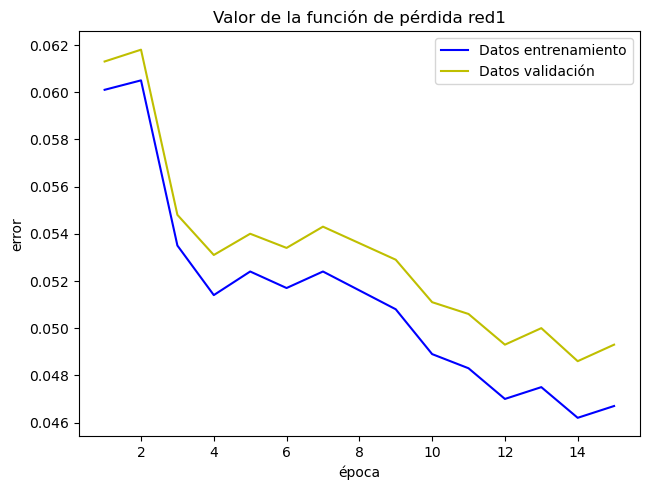

In [41]:
#num_veces=1
x1=np.linspace(1,15,len(historial_ent_loss_red1),dtype=int)
plt.plot(x1,historial_ent_loss_red1,color='b',label='Datos entrenamiento')
plt.plot(x1,historial_val_loss_red1,color='y',label='Datos validación')
plt.title('Valor de la función de pérdida red1')
plt.tight_layout()
plt.xlabel('época')
plt.ylabel('error')
plt.legend()

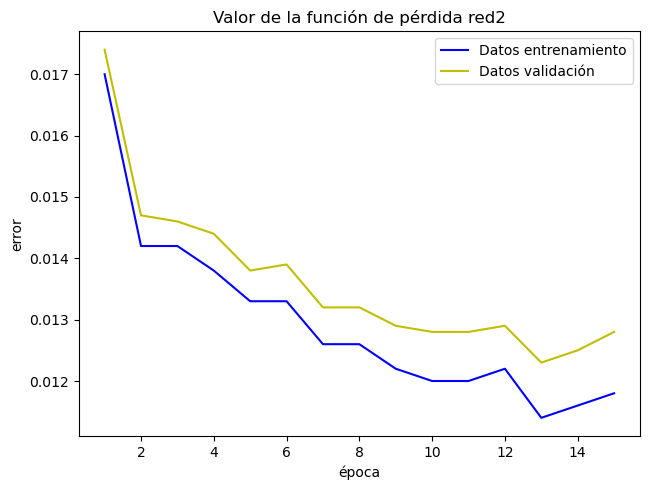

In [42]:
x1=np.linspace(1,15,len(historial_ent_loss_red2),dtype=int)
plt.plot(x1,historial_ent_loss_red2,color='b',label='Datos entrenamiento')
plt.plot(x1,historial_val_loss_red2,color='y',label='Datos validación')
plt.title('Valor de la función de pérdida red2')
plt.tight_layout()
plt.xlabel('época')
plt.ylabel('error')
plt.legend()

# Etapa 3: Guardar modelo combinado

In [27]:
#En los bloques de entrenamiento ya se guarda la red combinada, pero aun asi guardamos los modelos por separado
#Esto se hace porque al momento de usar el modelo podria ser necesario evaluar por separado para
#poder hacer pruebas.

xxnomarchivo='redautoencoderEB128'
#Método1:
guardarModeloH5(redautoencoder_eb, directorio_salida, xxnomarchivo)
#Método2:
guardarPesos(redautoencoder_eb, directorio_salida, xxnomarchivo+'pesos')
#Método3
#guardarModeloTF(redautoencoder_eb, directorio_salida, xxnomarchivo)


xxnomarchivo='redautoencoderAC2_128'
#Método1:
guardarModeloH5(redautoencoder, directorio_salida, xxnomarchivo)
#Método2:
guardarPesos(redautoencoder, directorio_salida, xxnomarchivo+'pesos')
#Método3:
#guardarModeloTF(redautoencoder, directorio_salida, xxnomarchivo)


# Etapa 3: Prueba del modelo combinado

In [15]:
aplicar_modeloAC_a_imagenes_COMBINADA(redautoencoder_eb,redautoencoder,18,19,'general100mod128','gris',
                             'general100resultado128','gris_reducida0_0x_MAPAreconstruidaCGAN3_AC',
                             'general100resultado128','gris_reducida0_0x_reconstruidaCGAN3_AC',0)

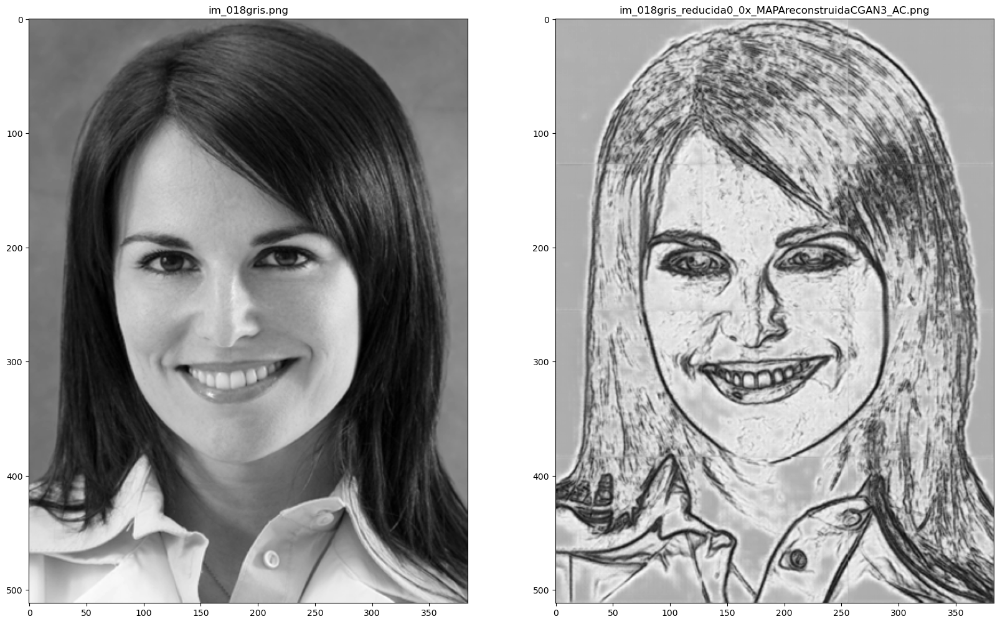

In [16]:
mostrar_imagen_2f(18,19,'general100mod128','gris',
                            'general100resultado128','gris_reducida0_0x_MAPAreconstruidaCGAN3_AC')

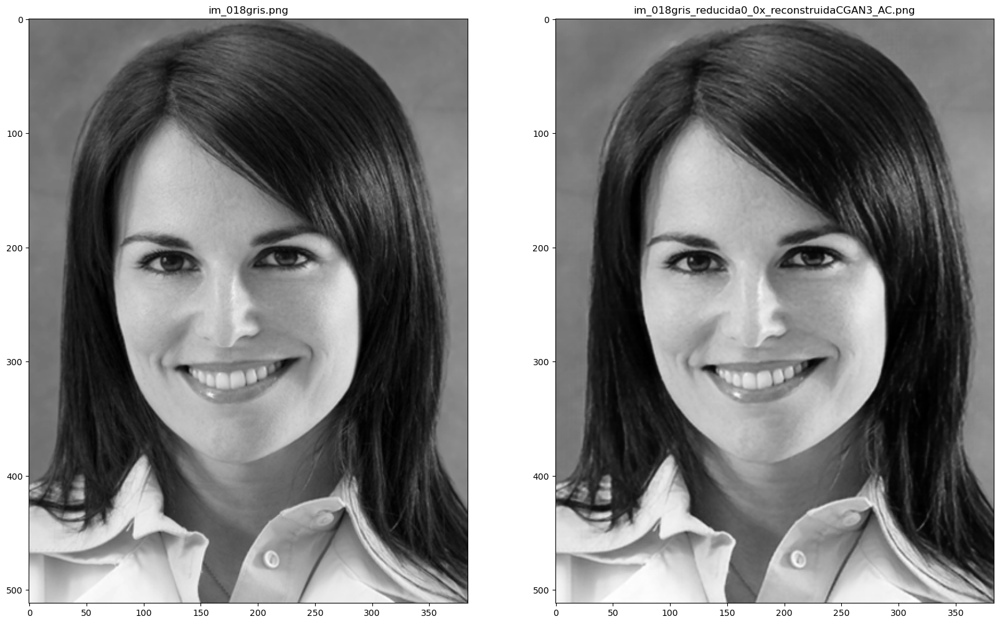

In [17]:
mostrar_imagen_2f(18,19,'general100mod128','gris',
                            'general100resultado128','gris_reducida0_0x_reconstruidaCGAN3_AC')

In [18]:
aplicar_modeloAC_a_imagenes_COMBINADA(redautoencoder_eb,redautoencoder,18,19,'general100mod128','gris_reducida2_2x',
                             'general100resultado128','gris_reducida2_2x_MAPAreconstruidaCGAN3_AC',
                             'general100resultado128','gris_reducida2_2x_reconstruidaCGAN3_AC',0)

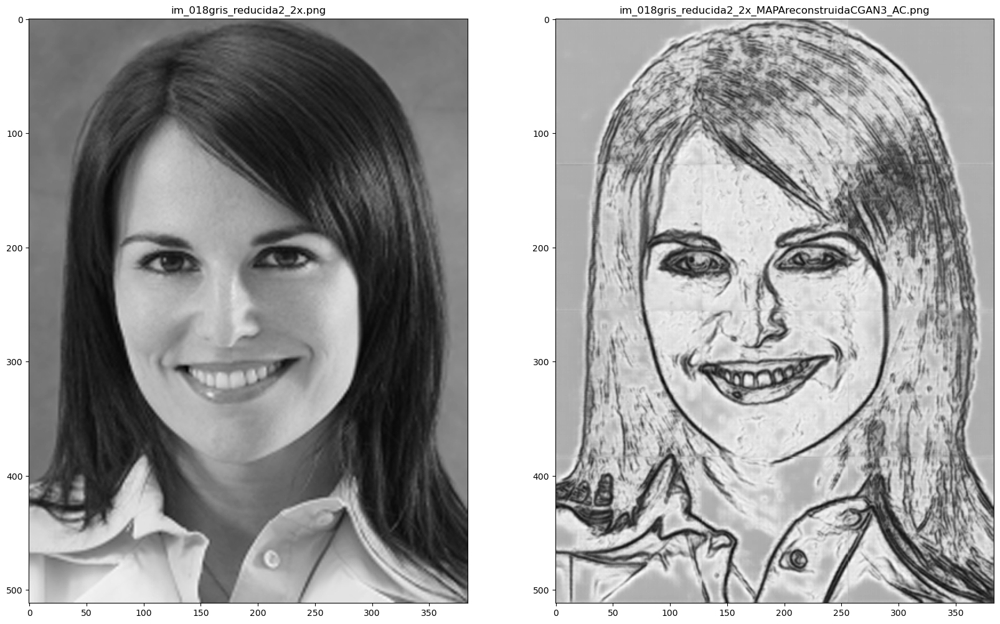

In [19]:
mostrar_imagen_2f(18,19,'general100mod128','gris_reducida2_2x',
                            'general100resultado128','gris_reducida2_2x_MAPAreconstruidaCGAN3_AC')

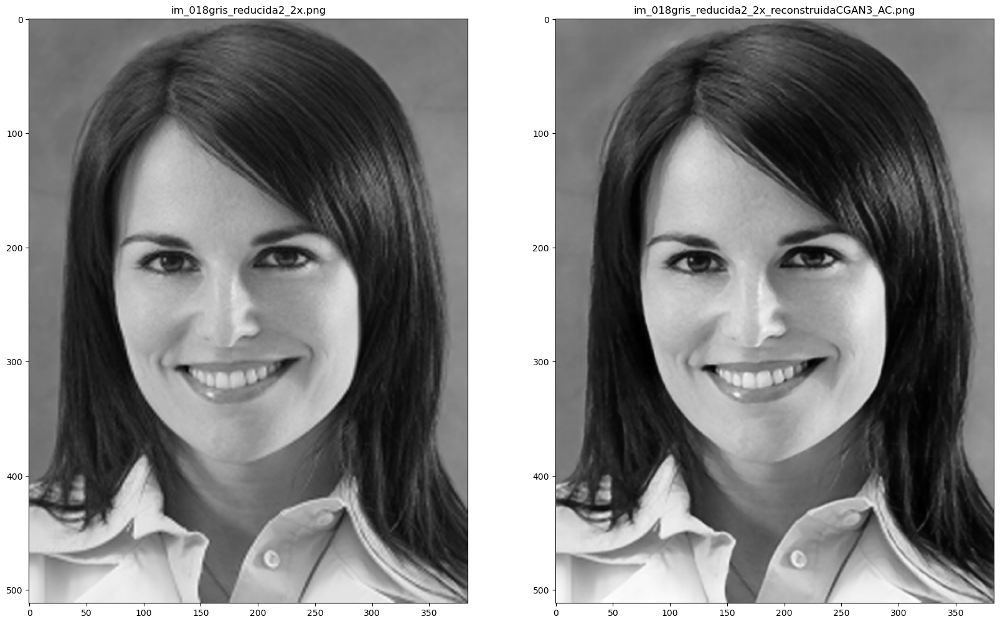

In [20]:
mostrar_imagen_2f(18,19,'general100mod128','gris_reducida2_2x',
                            'general100resultado128','gris_reducida2_2x_reconstruidaCGAN3_AC')

In [21]:
#50,101
aplicar_modeloAC_a_imagenes_COMBINADA(redautoencoder_eb,redautoencoder,18,19,'general100mod128','gris_reducida4_4x',
                             'general100resultado128','gris_reducida4_4x_MAPAreconstruidaCGAN3_AC',
                             'general100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC',0)

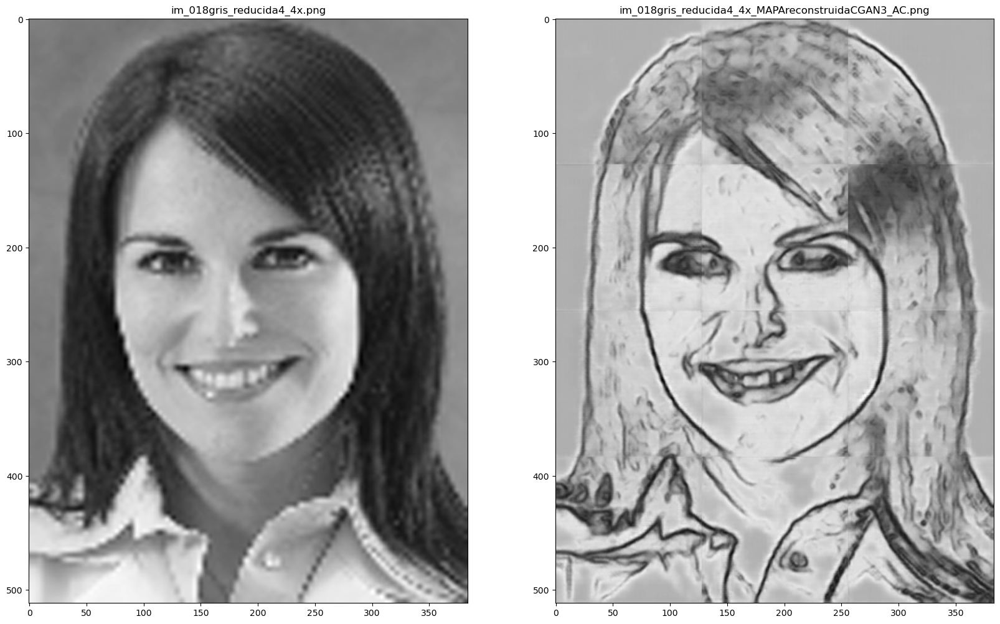

In [22]:
mostrar_imagen_2f(18,19,'general100mod128','gris_reducida4_4x',
                            'general100resultado128','gris_reducida4_4x_MAPAreconstruidaCGAN3_AC')

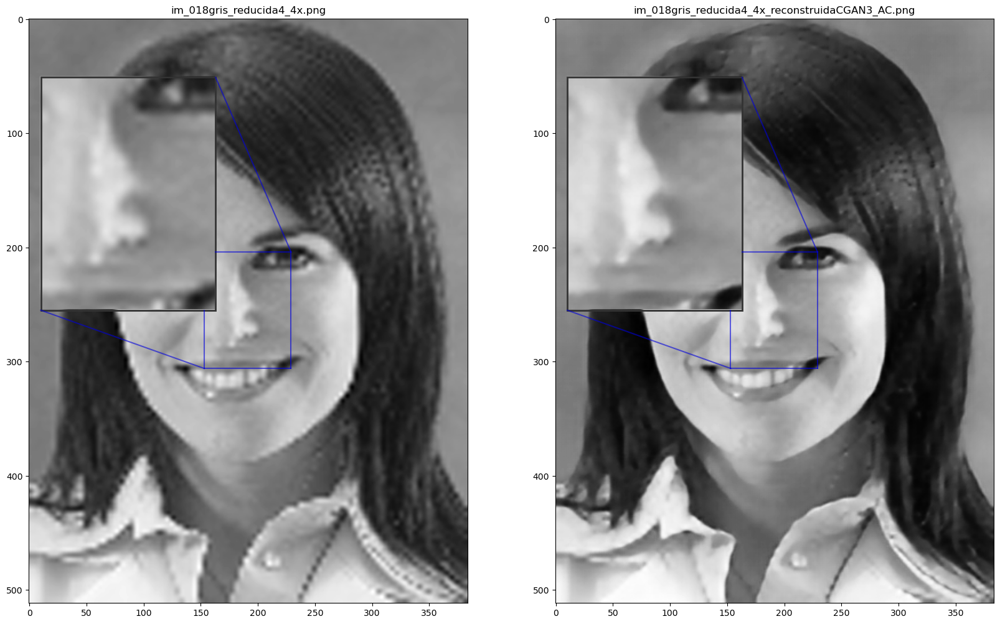

In [23]:
mostrar_imagen_2f_lupa(18,19,'general100mod128','gris_reducida4_4x',
                            'general100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC')

In [24]:
aplicar_modeloAC_a_imagenes_COMBINADA(redautoencoder_eb,redautoencoder,18,19,'general100mod128','gris_reducida6_6x',
                             'general100resultado128','gris_reducida6_6x_MAPAreconstruidaCGAN3_AC',
                             'general100resultado128','gris_reducida6_6x_reconstruidaCGAN3_AC',0)

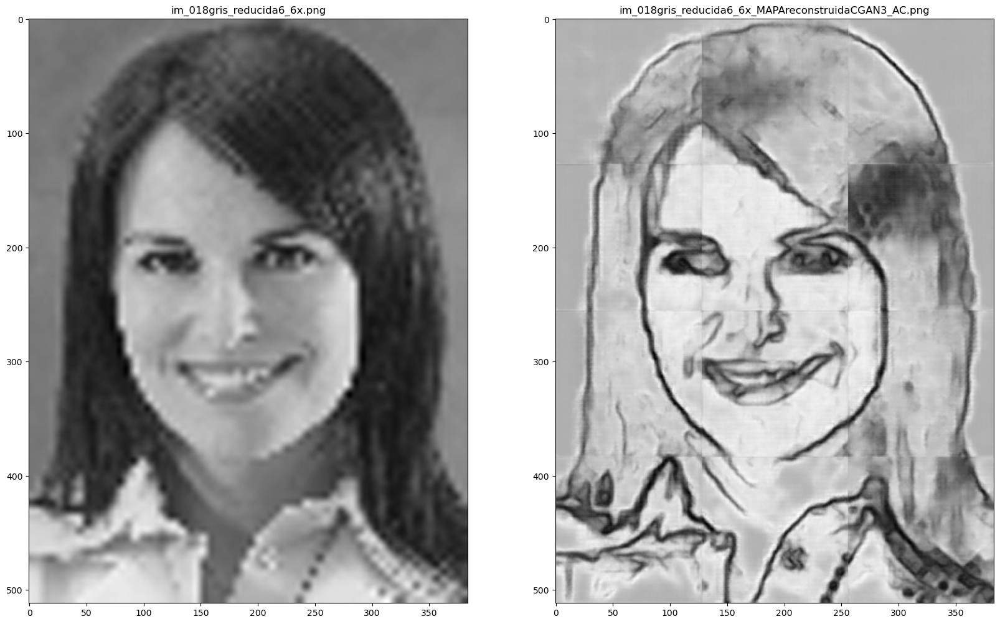

In [25]:
mostrar_imagen_2f(18,19,'general100mod128','gris_reducida6_6x',
                            'general100resultado128','gris_reducida6_6x_MAPAreconstruidaCGAN3_AC')

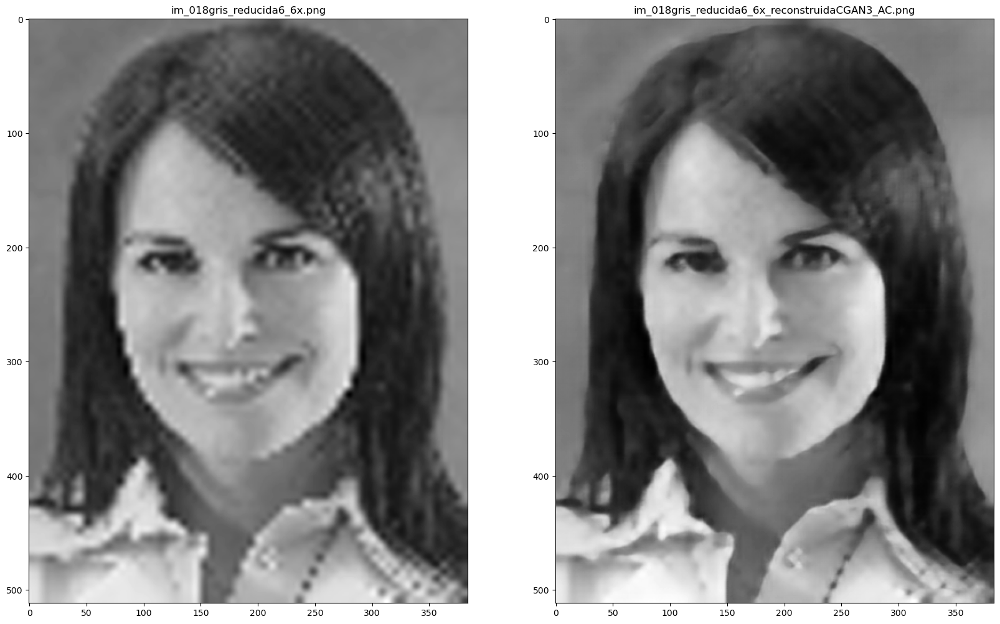

In [26]:
mostrar_imagen_2f(18,19,'general100mod128','gris_reducida6_6x',
                            'general100resultado128','gris_reducida6_6x_reconstruidaCGAN3_AC')

# Aplicar modelo a datos de prueba BSDS100

In [31]:
aplicar_modeloAC_a_imagenes_COMBINADA(redautoencoder_eb,redautoencoder,1,101,'pruebas/BSDS100mod128','gris_reducida4_4x',
                             'pruebas/BSDS100resultado128','gris_reducida4_4x_MAPAreconstruidaCGAN3_AC',
                             'pruebas/BSDS100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC',0)

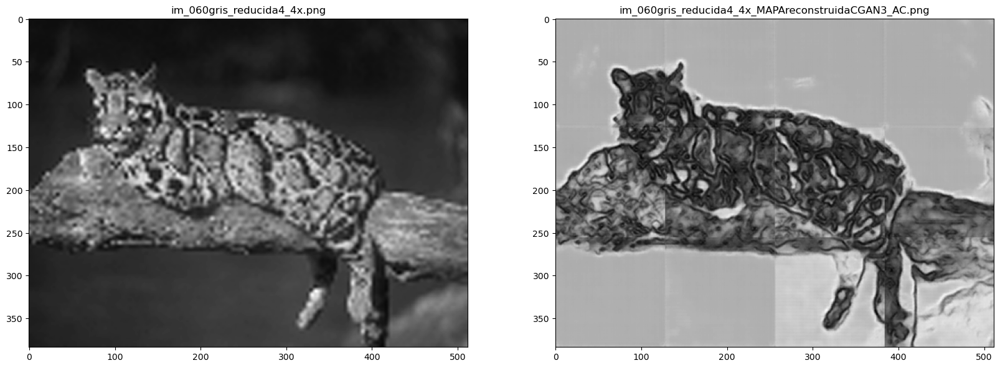

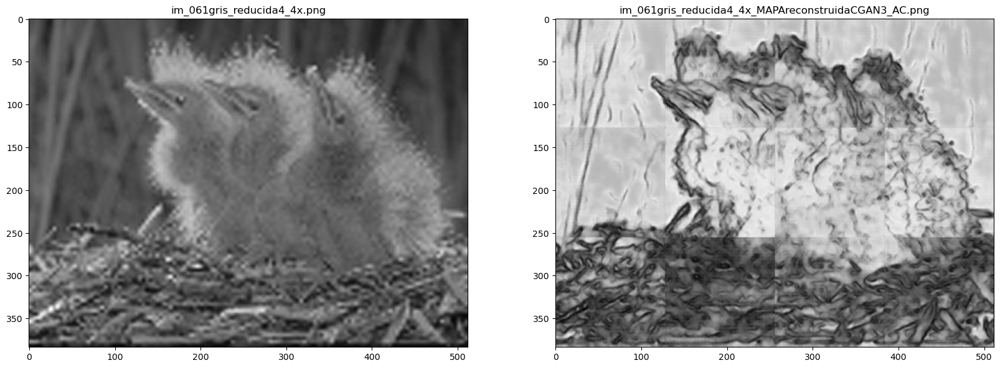

In [37]:
mostrar_imagen_2f(60,62,'pruebas/BSDS100mod128','gris_reducida4_4x',
                            'pruebas/BSDS100resultado128','gris_reducida4_4x_MAPAreconstruidaCGAN3_AC')

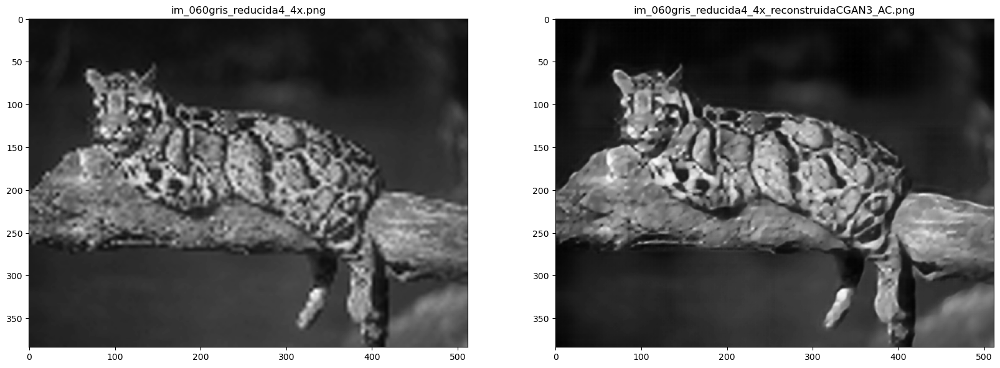

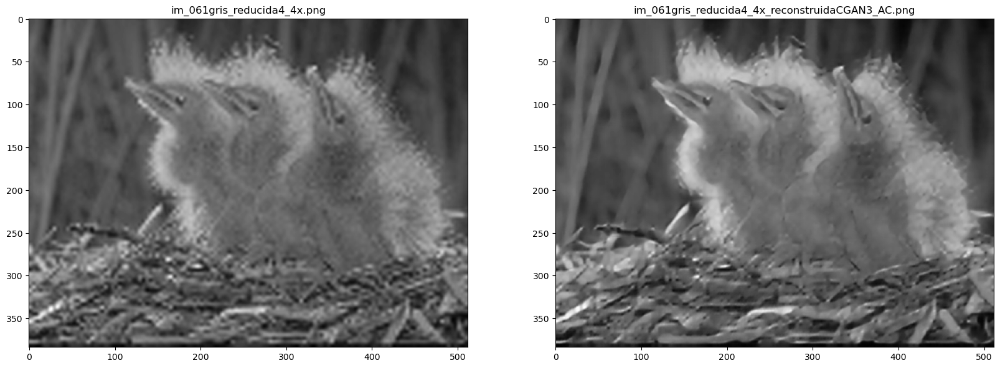

In [38]:
mostrar_imagen_2f(60,62,'pruebas/BSDS100mod128','gris_reducida4_4x',
                            'pruebas/BSDS100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC')

# Aplicar modelo a datos de prueba Historicas40

In [32]:
#5,6,41
aplicar_modeloAC_a_imagenes_COMBINADA(redautoencoder_eb,redautoencoder,1,41,'pruebas/Historicas40mod128','gris_reducida4_4x',
                             'pruebas/Historicas40resultado128','gris_reducida4_4x_MAPAreconstruidaCGAN3_AC',
                             'pruebas/Historicas40resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC',0)

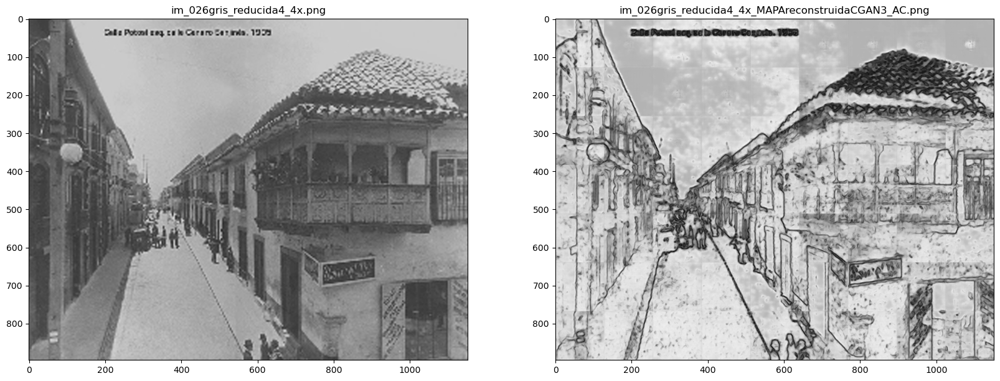

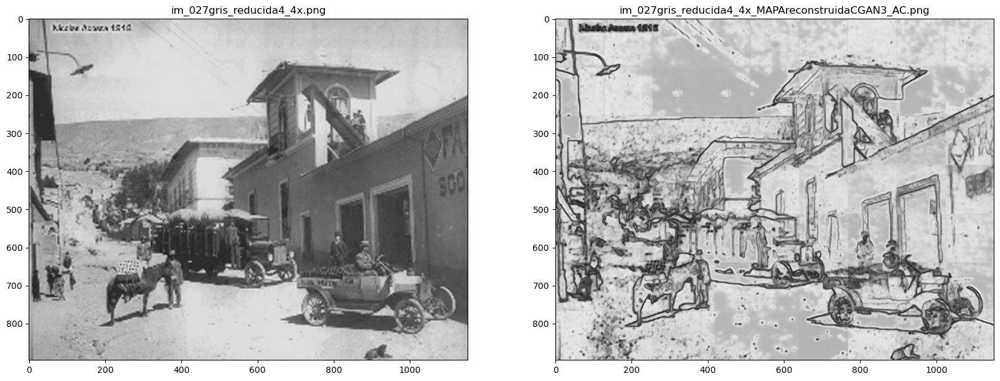

In [39]:
mostrar_imagen_2f(26,28,'pruebas/Historicas40mod128','gris_reducida4_4x',
                            'pruebas/Historicas40resultado128','gris_reducida4_4x_MAPAreconstruidaCGAN3_AC')

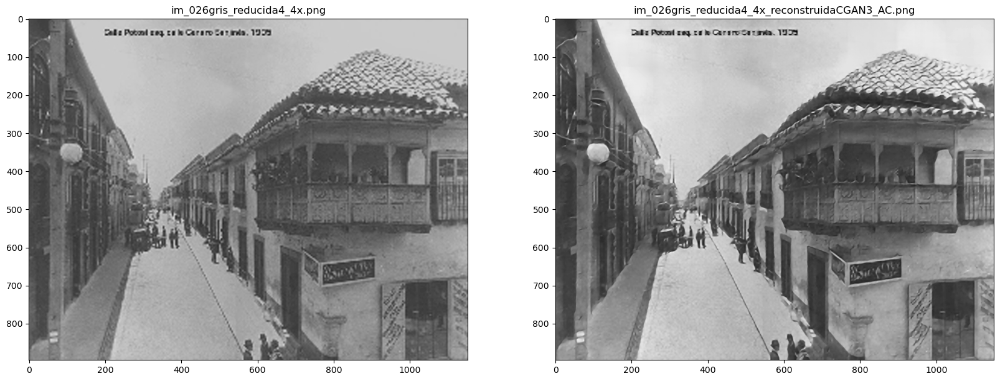

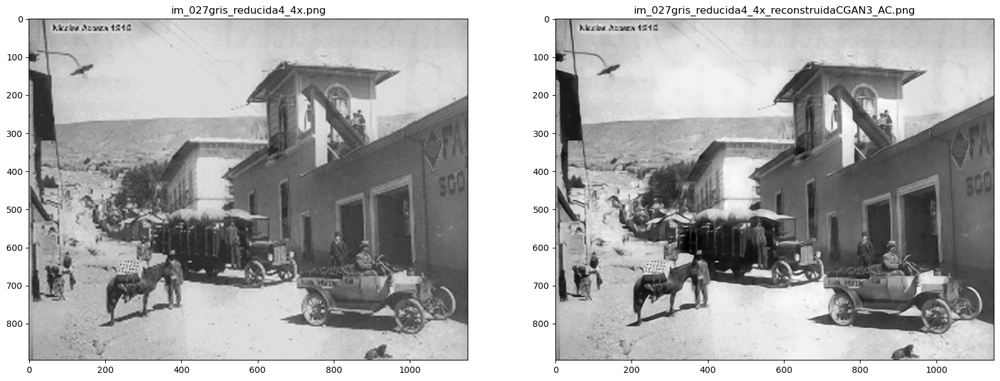

In [40]:
mostrar_imagen_2f(26,28,'pruebas/Historicas40mod128','gris_reducida4_4x',
                            'pruebas/Historicas40resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC')

# Aplicar modelo a datos de prueba Manga109

In [33]:
aplicar_modeloAC_a_imagenes_COMBINADA(redautoencoder_eb,redautoencoder,1,110,'pruebas/Manga109mod128','gris_reducida4_4x',
                             'pruebas/Manga109resultado128','gris_reducida4_4x_MAPAreconstruidaCGAN3_AC',
                             'pruebas/Manga109resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC',0)

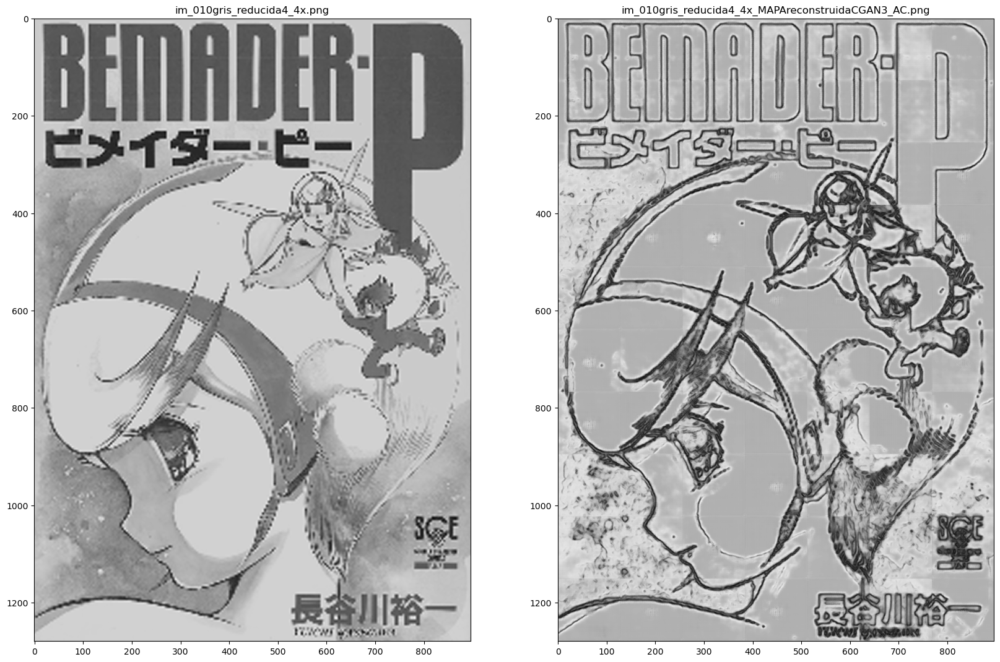

In [41]:
mostrar_imagen_2f(10,11,'pruebas/Manga109mod128','gris_reducida4_4x',
                            'pruebas/Manga109resultado128','gris_reducida4_4x_MAPAreconstruidaCGAN3_AC')

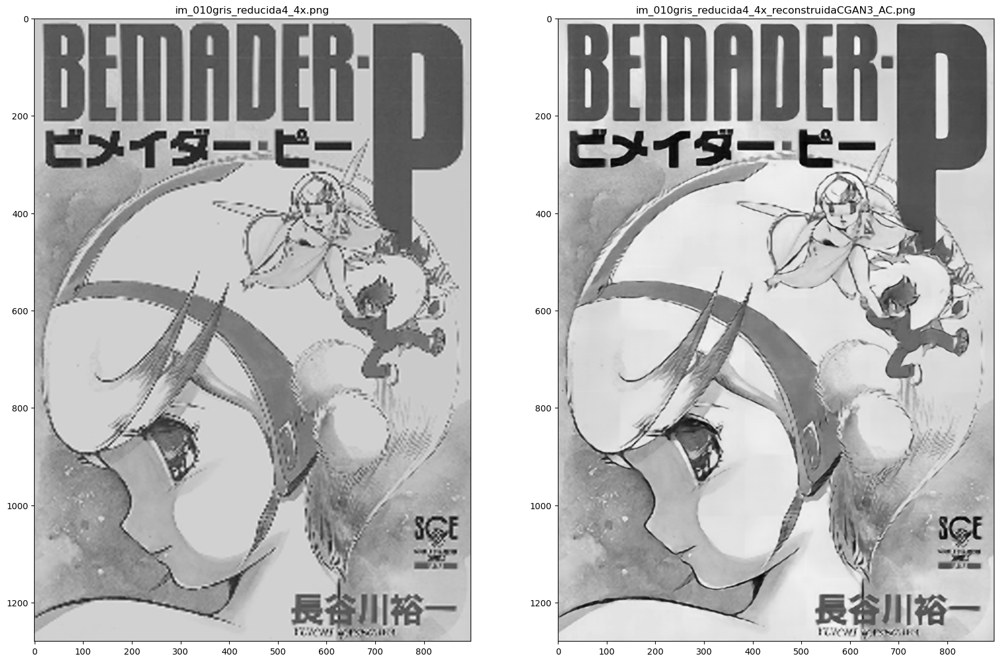

In [42]:
mostrar_imagen_2f(10,11,'pruebas/Manga109mod128','gris_reducida4_4x',
                            'pruebas/Manga109resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC')

# Aplicar modelo a datos de prueba Set5

In [15]:
aplicar_modeloAC_a_imagenes_COMBINADA(redautoencoder_eb,redautoencoder,3,4,'pruebas/Set5mod128','gris_reducida4_4x',
                             'pruebas/Set5resultado128','gris_reducida4_4x_MAPAreconstruidaCGAN3_AC',
                             'pruebas/Set5resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC',0)

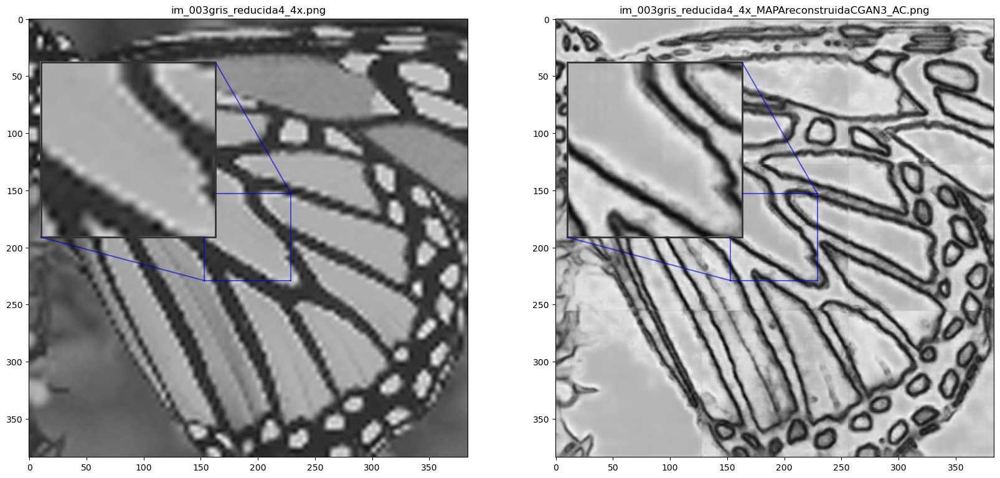

In [16]:
mostrar_imagen_2f_lupa(3,4,'pruebas/Set5mod128','gris_reducida4_4x',
                            'pruebas/Set5resultado128','gris_reducida4_4x_MAPAreconstruidaCGAN3_AC')

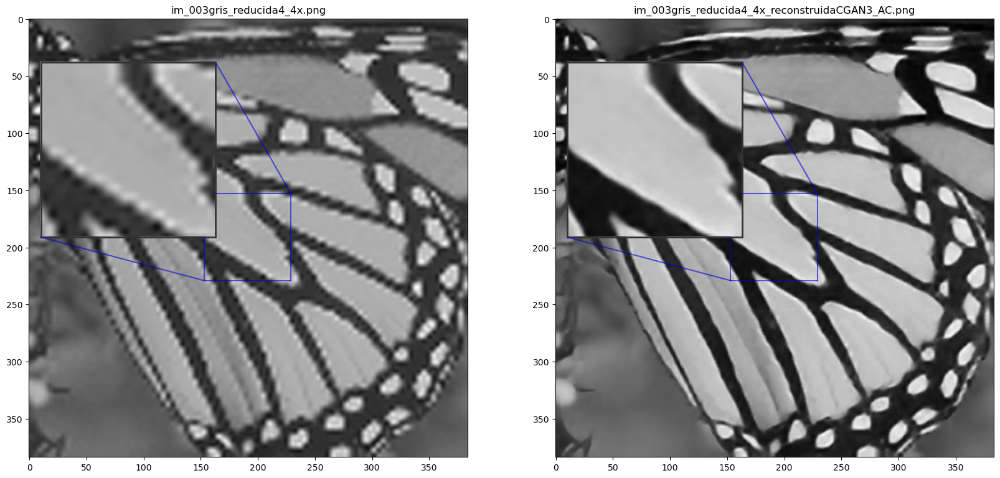

In [17]:
mostrar_imagen_2f_lupa(3,4,'pruebas/Set5mod128','gris_reducida4_4x',
                            'pruebas/Set5resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC')

# Aplicar modelo a datos de prueba Set14

In [29]:
aplicar_modeloAC_a_imagenes_COMBINADA(redautoencoder_eb,redautoencoder,14,15,'pruebas/Set14mod128','gris_reducida4_4x',
                             'pruebas/Set14resultado128','gris_reducida4_4x_MAPAreconstruidaCGAN3_AC',
                             'pruebas/Set14resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC',0)

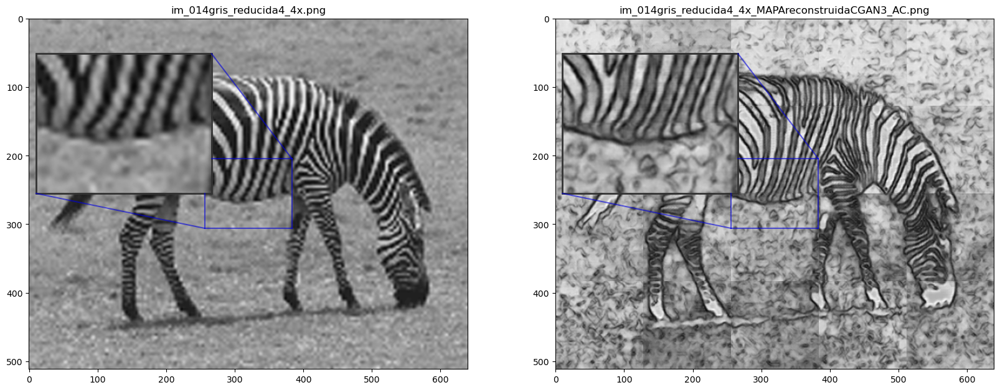

In [48]:
mostrar_imagen_2f_lupa(14,15,'pruebas/Set14mod128','gris_reducida4_4x',
                            'pruebas/Set14resultado128','gris_reducida4_4x_MAPAreconstruidaCGAN3_AC')

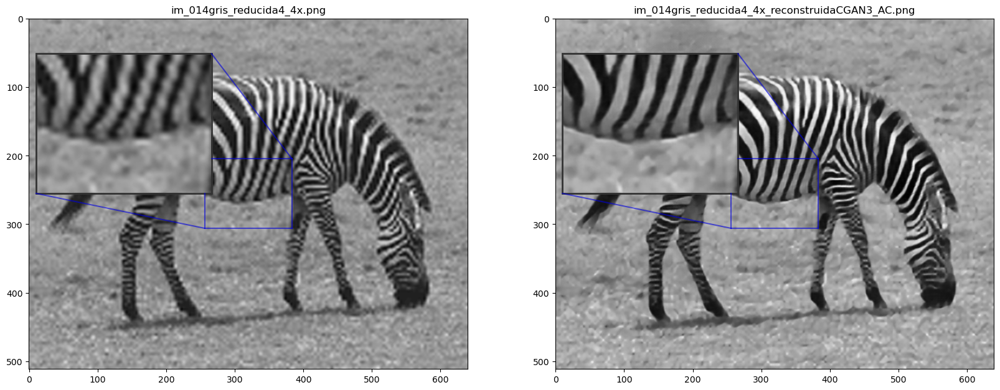

In [49]:
mostrar_imagen_2f_lupa(14,15,'pruebas/Set14mod128','gris_reducida4_4x',
                            'pruebas/Set14resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC')

In [50]:
aplicar_modeloAC_a_imagenes_COMBINADA(redautoencoder_eb,redautoencoder,14,15,'pruebas/Set14mod128','gris_reducida4_4xnearest',
                             'pruebas/Set14resultado128','gris_reducida4_4xnearest_MAPAreconstruidaCGAN3_AC',
                             'pruebas/Set14resultado128','gris_reducida4_4xnearest_reconstruidaCGAN3_AC',0)

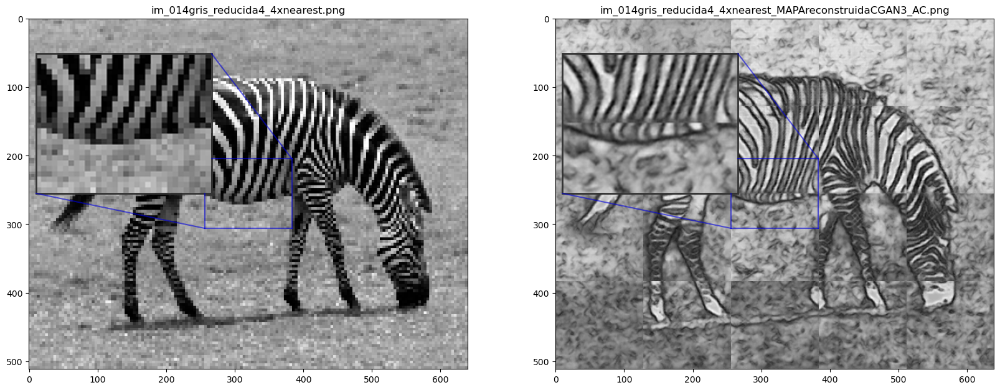

In [51]:
mostrar_imagen_2f_lupa(14,15,'pruebas/Set14mod128','gris_reducida4_4xnearest',
                            'pruebas/Set14resultado128','gris_reducida4_4xnearest_MAPAreconstruidaCGAN3_AC')

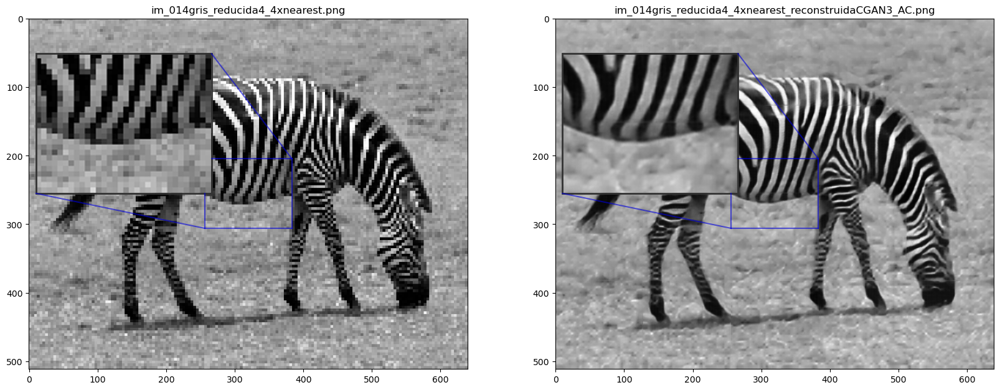

In [52]:
mostrar_imagen_2f_lupa(14,15,'pruebas/Set14mod128','gris_reducida4_4xnearest',
                            'pruebas/Set14resultado128','gris_reducida4_4xnearest_reconstruidaCGAN3_AC')

# Aplicar modelo a datos de prueba Urban100

In [34]:
aplicar_modeloAC_a_imagenes_COMBINADA(redautoencoder_eb,redautoencoder,1,101,'pruebas/Urban100mod128','gris_reducida4_4x',
                             'pruebas/Urban100resultado128','gris_reducida4_4x_MAPAreconstruidaCGAN3_AC',
                             'pruebas/Urban100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC',0)

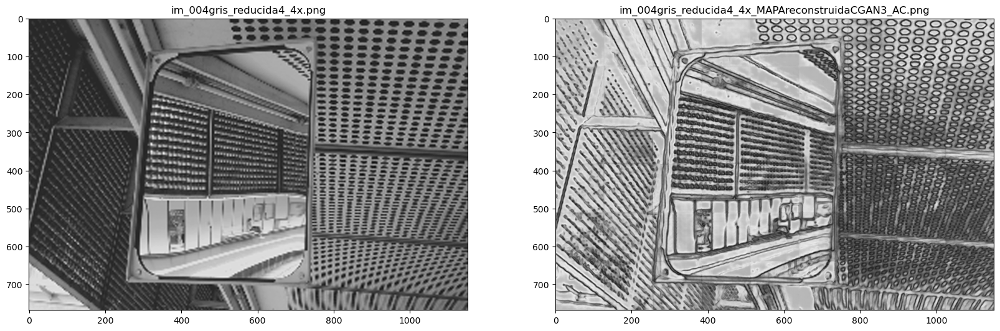

In [43]:
mostrar_imagen_2f(4,5,'pruebas/Urban100mod128','gris_reducida4_4x',
                            'pruebas/Urban100resultado128','gris_reducida4_4x_MAPAreconstruidaCGAN3_AC')

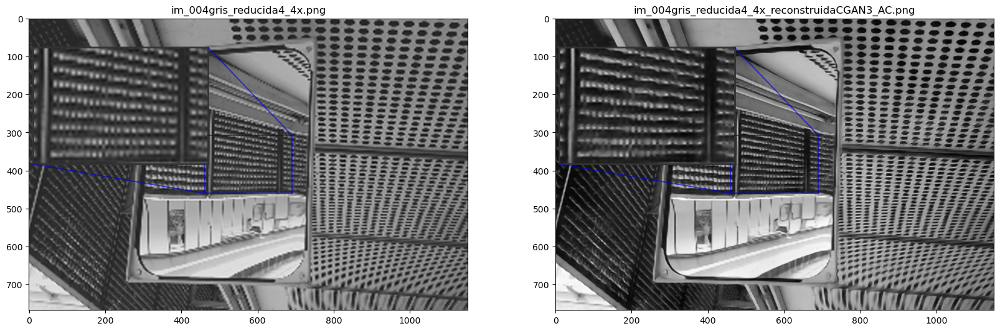

In [44]:
mostrar_imagen_2f_lupa(4,5,'pruebas/Urban100mod128','gris_reducida4_4x',
                            'pruebas/Urban100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC')

# Prueba aplicar varias veces

Consiste en aplicar todo el modelo reiteradas veces con el fin de saber si se generan defectos.

In [ ]:
aplicar_modeloAC_a_imagenes_COMBINADA(redautoencoder_eb,redautoencoder,18,19,
                             'general100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC',
                             'general100resultado128','gris_reducida4_4x_MAPAreconstruidaCGAN3_AC_1',
                             'general100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC_1')

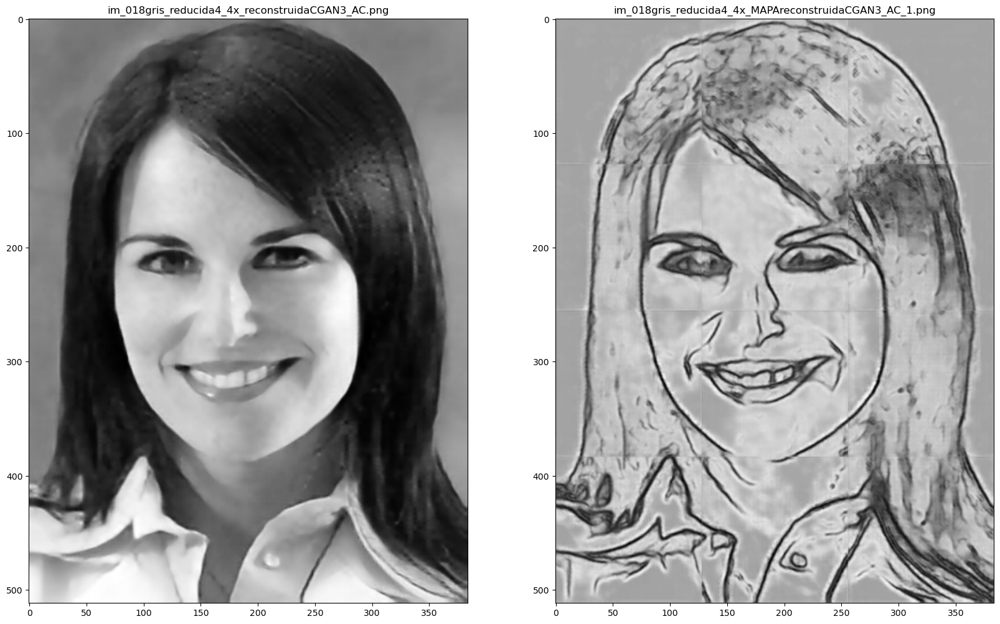

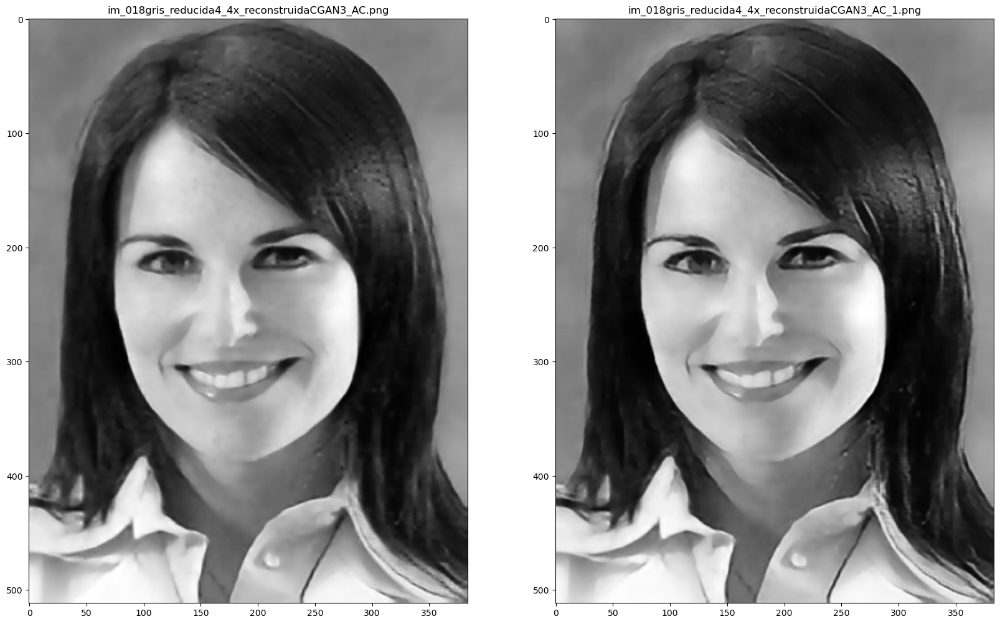

In [ ]:
mostrar_imagen_2f(18,19,'general100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC',
                            'general100resultado128','gris_reducida4_4x_MAPAreconstruidaCGAN3_AC_1')
mostrar_imagen_2f(18,19,'general100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC',
                            'general100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC_1')

In [ ]:
aplicar_modeloAC_a_imagenes_COMBINADA(redautoencoder_eb,redautoencoder,18,19,
                             'general100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC_1',
                             'general100resultado128','gris_reducida4_4x_MAPAreconstruidaCGAN3_AC_2',
                             'general100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC_2')

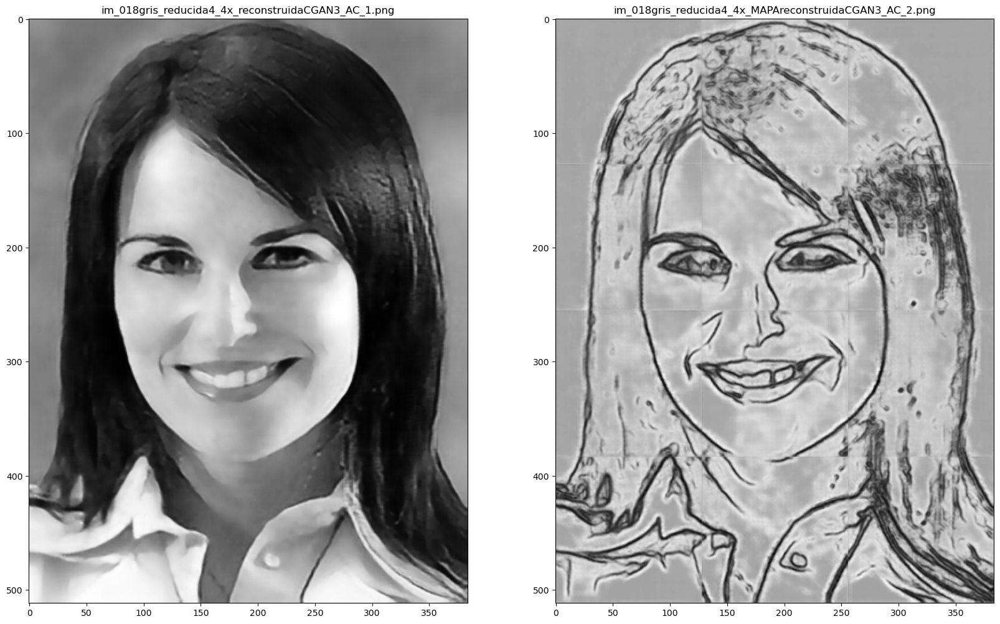

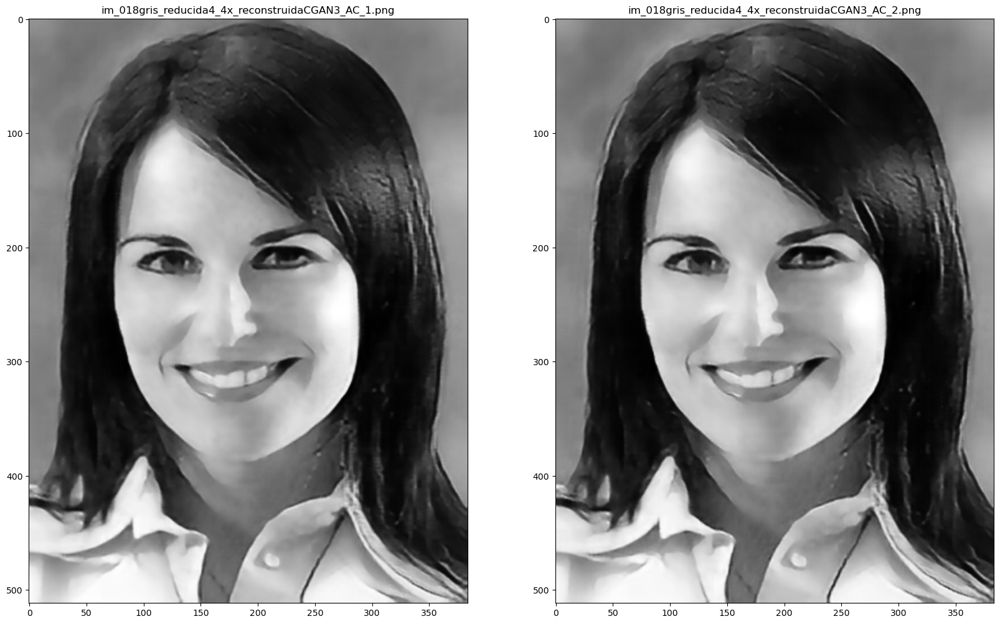

In [ ]:
mostrar_imagen_2f(18,19,'general100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC_1',
                            'general100resultado128','gris_reducida4_4x_MAPAreconstruidaCGAN3_AC_2')
mostrar_imagen_2f(18,19,'general100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC_1',
                            'general100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC_2')

In [ ]:
aplicar_modeloAC_a_imagenes_COMBINADA(redautoencoder_eb,redautoencoder,18,19,
                             'general100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC_2',
                             'general100resultado128','gris_reducida4_4x_MAPAreconstruidaCGAN3_AC_3',
                             'general100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC_3')

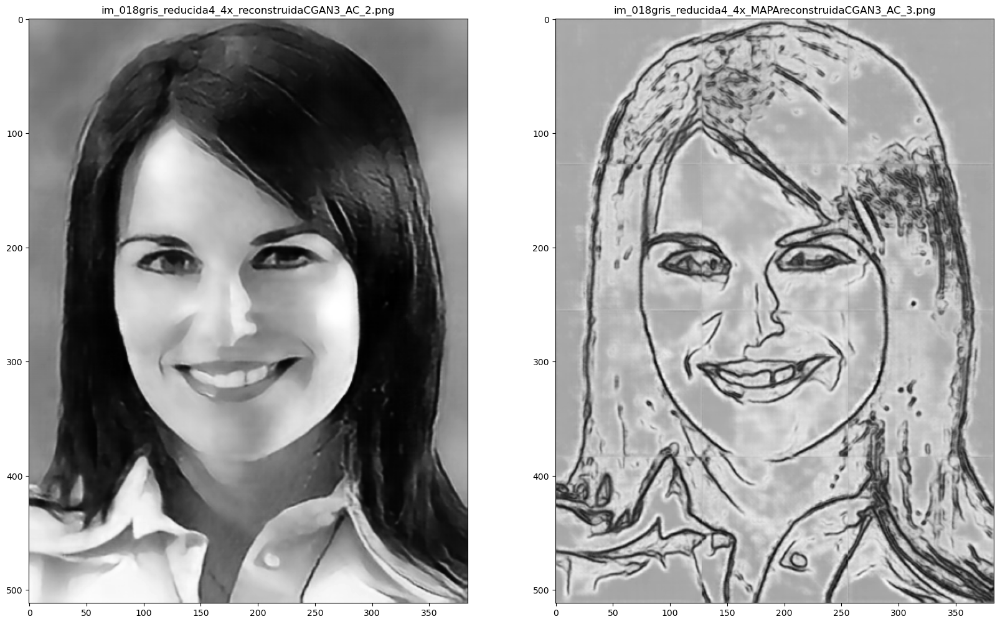

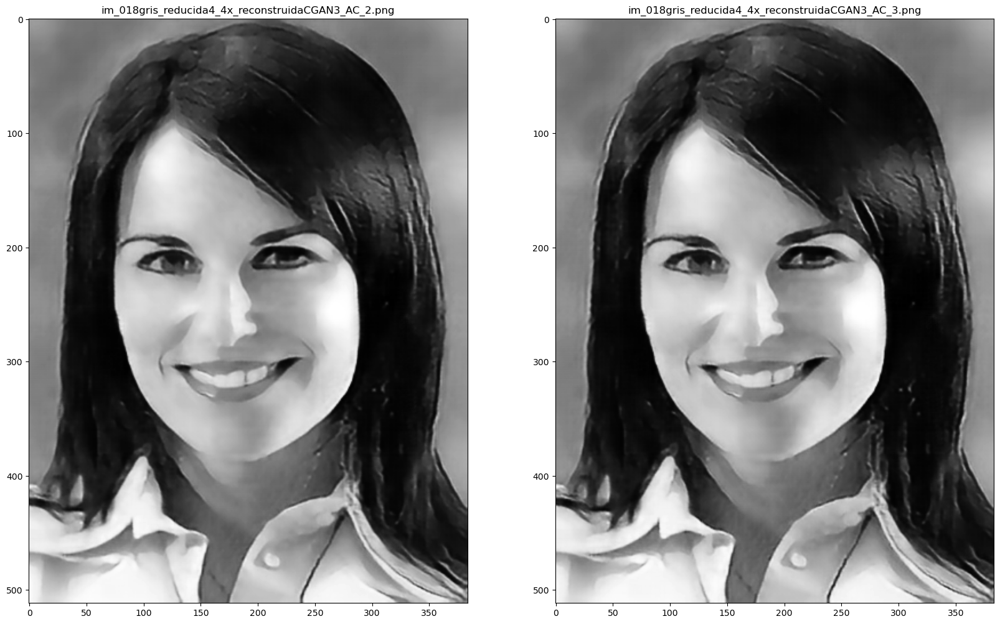

In [ ]:
mostrar_imagen_2f(18,19,'general100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC_2',
                            'general100resultado128','gris_reducida4_4x_MAPAreconstruidaCGAN3_AC_3')
mostrar_imagen_2f(18,19,'general100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC_2',
                            'general100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC_3')

In [ ]:
aplicar_modeloAC_a_imagenes_COMBINADA(redautoencoder_eb,redautoencoder,18,19,
                             'general100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC_3',
                             'general100resultado128','gris_reducida4_4x_MAPAreconstruidaCGAN3_AC_4',
                             'general100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC_4')

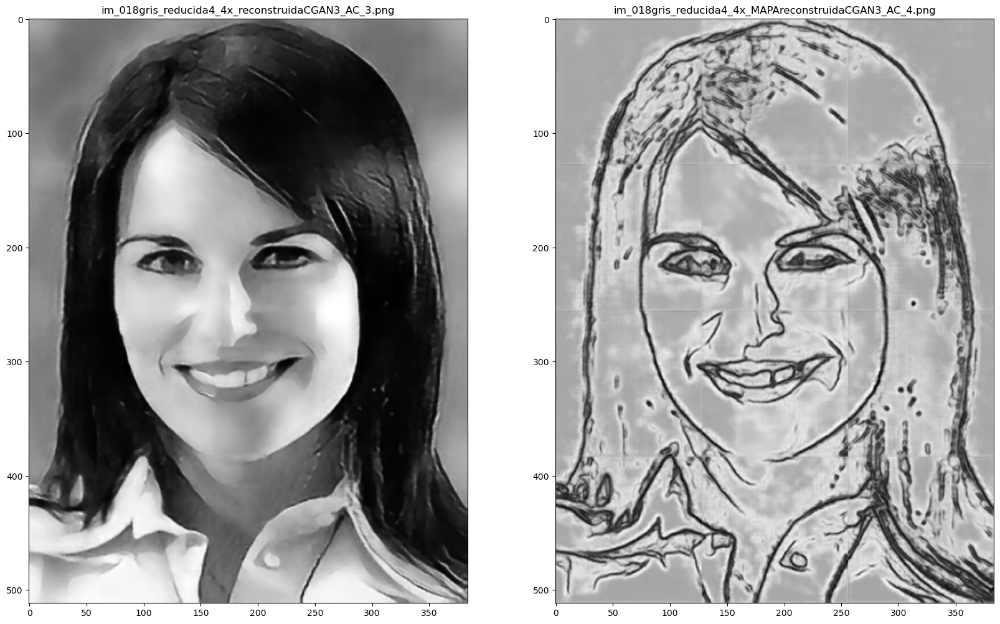

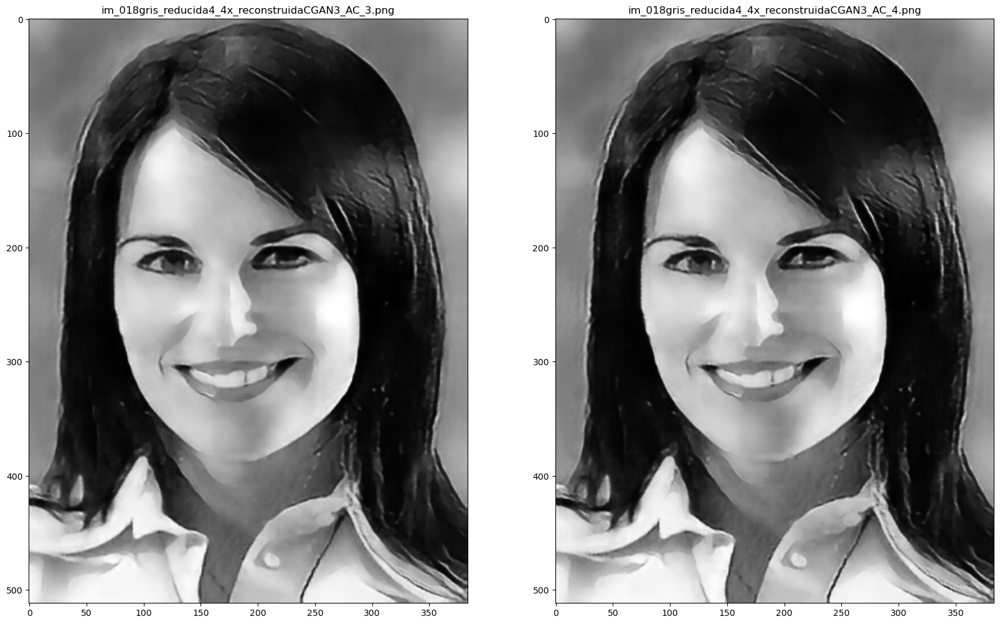

In [ ]:
mostrar_imagen_2f(18,19,'general100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC_3',
                            'general100resultado128','gris_reducida4_4x_MAPAreconstruidaCGAN3_AC_4')
mostrar_imagen_2f(18,19,'general100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC_3',
                            'general100resultado128','gris_reducida4_4x_reconstruidaCGAN3_AC_4')